Summary: Takes a random pair of a Parasite and a Single Host signals. Finds the 11.5-28Hz amplitude envelope modulation component and replaces it (or adds on top of it) the equivalent component of the other member of the pair. 
Creates and saves modified signals as wav files. Two control versions of the original signals are also created: remove and reintroduce own component for both files.

Author: E.R.

Last modified:  11/10/2022 17:17

version: 5


NOTES: in this version: i) same as version 4 but using original smapling rate of 48KHz

# Set up environment 

In [1]:
import os
if not os.path.isdir('/content/amplitude-modulation-analysis-module'):
  !git clone https://github.com/MuSAELab/amplitude-modulation-analysis-module.git


try:
  import am_analysis
except ModuleNotFoundError:
  !pip install /content/amplitude-modulation-analysis-module  


Cloning into 'amplitude-modulation-analysis-module'...
remote: Enumerating objects: 143, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 143 (delta 0), reused 1 (delta 0), pack-reused 140
Receiving objects: 100% (143/143), 785.74 KiB | 5.65 MiB/s, done.
Resolving deltas: 100% (69/69), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing ./amplitude-modulation-analysis-module
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
  Created wheel for am-analysis: filename=am_analysis-0.1-py3-none-any.whl size=20044 sha256=31cc99e

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy.signal import hilbert, butter, lfilter, freqz
from scipy import signal as sig
import pandas as pd
from IPython.display import Audio
import librosa
import librosa.display
import IPython.display as ipd
import soundfile as sf
import random
from am_analysis import am_analysis as ama

# User-defined Parameters

In [3]:
# CHOOSE LIMITS OF THE BANDSTOP FILTER (in Hz). THIS IS THE AMPLITUDE MODULATION BAND TO BE REMOVED FROM THE AMPLITUDE ENVELOPES OF THE SIGNALS
low_bs_f = 11.5
high_bs_f = 28


In [4]:
# USE FULL 15s AUDIO FILES OR SMALLER CLIPS 
# 1 = use full audio
# 0 = use small clips

use_full = 1

In [5]:
# IF NOT USING THE FULL 15s AUDIOWAVES, CHOOSE WHERE EACH SIGNAL SHOULD START AND ALSO THE DURATION OF THE CLIP
# NUMBERS REPRESENT SECONDS (from 0 to 15)
# SIGNAL_START + SIGNAL DURATION CAN NOT BE > 15

# for the parasite call
signal_start_P1 = 6
signal_duration_P1 = 3

# for the single host call
signal_start_SH1 = 10
signal_duration_SH1 = 3

In [6]:
# Toggle on/off for displaying plots and listening to audio within the notebook
show_plots = 1 # should plots be shown for all parts of the signal processing?  1 = YES, 0 = NO

In [7]:
# Frequency range for bank-filtering of signals
# Need to choose: minimum frequency, maximum frequncy, and number of bank-filters
# The maximum frequency can not be higher than half the sampling rate (in our case sr = 22050Hz, so the maximum frequncy should be <11025)

min_bank_f = 1.5
max_bank_f = 17000 #(empirically chosen. Above this there is practically no power in the audios)
n_bank = 8

#min_bank_f = 2
#max_bank_f = 10312 #(empirically chosen. Above this there is practically no power in the audios)
#n_bank = 16

freqs = np.linspace(min_bank_f,max_bank_f,n_bank+1)

print('the frequency intervals are: \n',freqs)

the frequency intervals are: 
 [1.50000000e+00 2.12631250e+03 4.25112500e+03 6.37593750e+03
 8.50075000e+03 1.06255625e+04 1.27503750e+04 1.48751875e+04
 1.70000000e+04]


# Get Data

if not sure which files to use, use these:
Parasite: LT059_18_1IM_15s
Single Host: LT009_18_1LT_15s

mount google drive and unzip (locally on colab) directory with relevant files

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
if not os.path.isdir('/content/drive/MyDrive/15s_recordings'):
  !unzip '/content/drive/MyDrive/15s_recordings.zip'

# Read in and examine audiowaves

choose randomly a parasite 1 file and a single host 1 file

**choose a file for parasite 1 (audiofile_P1)**

In [10]:
audiofile_P1 = '/content/15s_recordings/parasite1_single/' + random.choice(os.listdir('/content/15s_recordings/parasite1_single'))

name_P = os.path.basename(audiofile_P1).split('.')[0]
print('Parasite file chosen:',name_P)

Parasite file chosen: LT152_161IM_15s


**choose a file for brood host 1 (audiofile_BH1)**

In [11]:
audiofile_SH1 = '/content/15s_recordings/host_1_single/' + random.choice(os.listdir('/content/15s_recordings/host_1_single')) 

name_SH = os.path.basename(audiofile_SH1).split('.')[0]
print('Single Host file chosen:',name_SH)

Single Host file chosen: LT133_161LT


**Plot the full audiowaves (named `signal_full_P1` and `signal_full_SH1`)**

total audio duration of file /content/15s_recordings/parasite1_single/LT152_161IM_15s.wav is : 15.01s




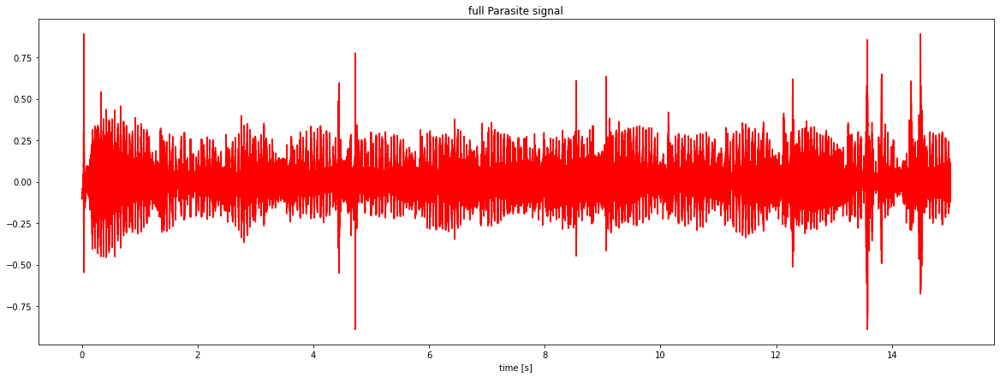

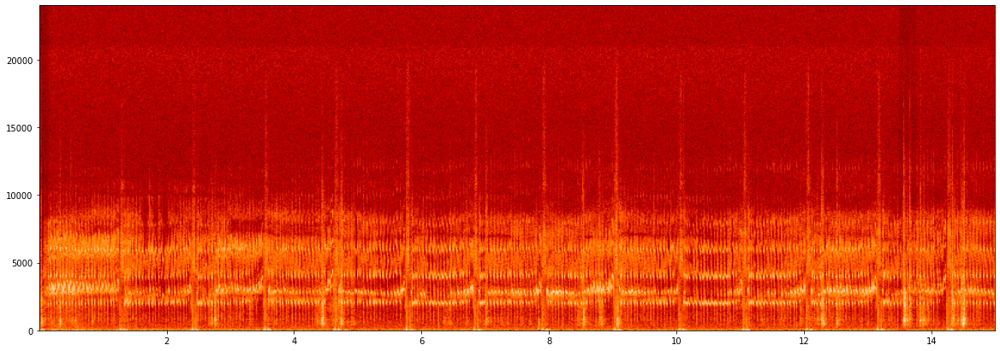

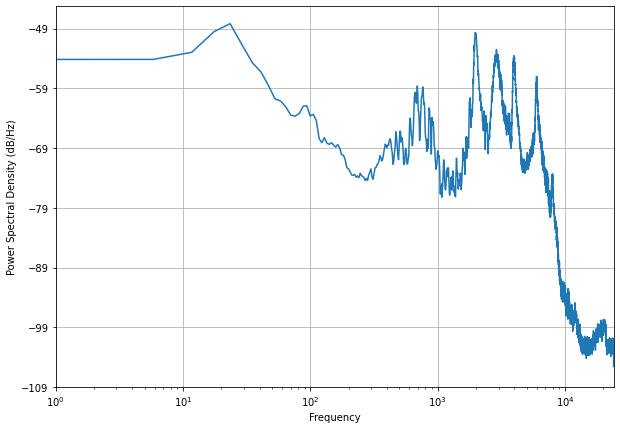

PARASITE FULL DURATION AUDIO


total audio duration of file /content/15s_recordings/host_1_single/LT133_161LT.wav is : 15.03s




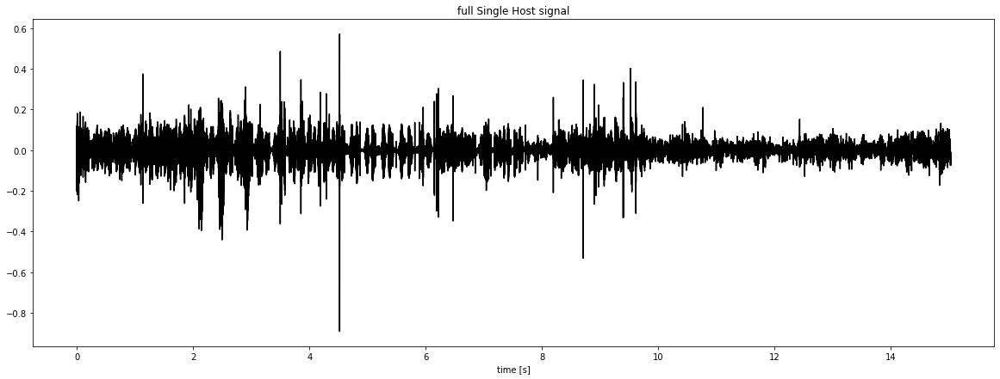

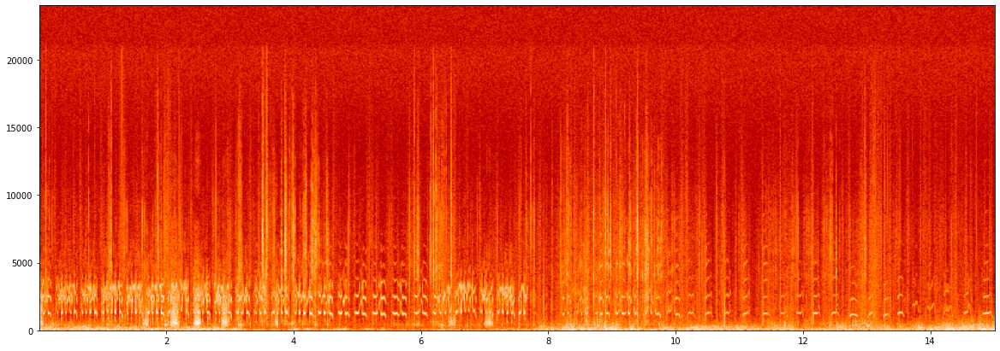

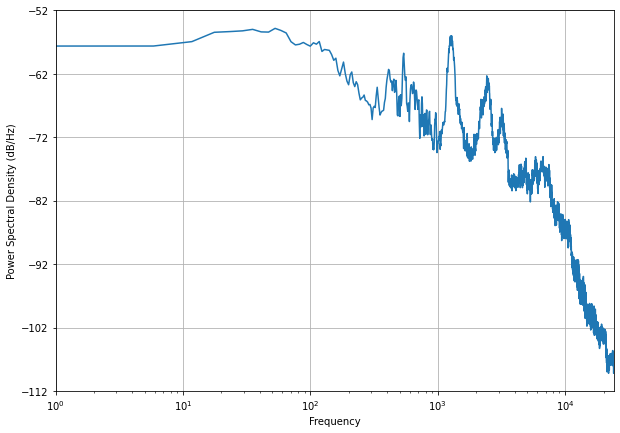

SINGLE HOST FULL DURATION AUDIO


In [12]:
signal_full_P1, sr = librosa.load(audiofile_P1,sr=None)
print(f'total audio duration of file {audiofile_P1} is : {len(signal_full_P1)/sr:.2f}s')
print('\n')

if show_plots:

  t = np.linspace(0,len(signal_full_P1)/sr, len(signal_full_P1))
  plt.figure(figsize=(20,7))  
  plt.plot(t, signal_full_P1,c='r')
  plt.xlabel('time [s]')
  plt.title('full Parasite signal')
  plt.show()

  plt.figure(figsize=(20,7))
  plt.specgram(signal_full_P1, NFFT=1024, Fs=sr, noverlap=128, cmap=plt.cm.gist_heat) 
  plt.show()

  plt.figure(figsize=(10,7))
  plt.psd(signal_full_P1, NFFT=8*1024, Fs=sr)
  plt.xlim([1,int(sr/2)])
  plt.xscale('log')
  plt.show()

  print('PARASITE FULL DURATION AUDIO')
  ipd.display(ipd.Audio(data=signal_full_P1,rate=sr))



signal_full_SH1, sr = librosa.load(audiofile_SH1,sr=None)
print(f'total audio duration of file {audiofile_SH1} is : {len(signal_full_SH1)/sr:.2f}s')
print('\n')

if show_plots:

  t = np.linspace(0,len(signal_full_SH1)/sr, len(signal_full_SH1))
  plt.figure(figsize=(20,7))
  plt.plot(t, signal_full_SH1,c='k')
  plt.xlabel('time [s]')
  plt.title('full Single Host signal')
  plt.show()

  plt.figure(figsize=(20,7))
  plt.specgram(signal_full_SH1, NFFT=1024, Fs=sr, noverlap=128, cmap=plt.cm.gist_heat) 
  plt.show()

  plt.figure(figsize=(10,7))
  plt.psd(signal_full_SH1, NFFT=8*1024, Fs=sr, label='Full wideband SH signal ')
  plt.xlim([1,int(sr/2)])
  plt.xscale('log')
  plt.show()

  print('SINGLE HOST FULL DURATION AUDIO')
  ipd.display(ipd.Audio(data=signal_full_SH1,rate=sr))


**Plot the parts of the audios to be used (named `signalP1` and `signalSH1`)**

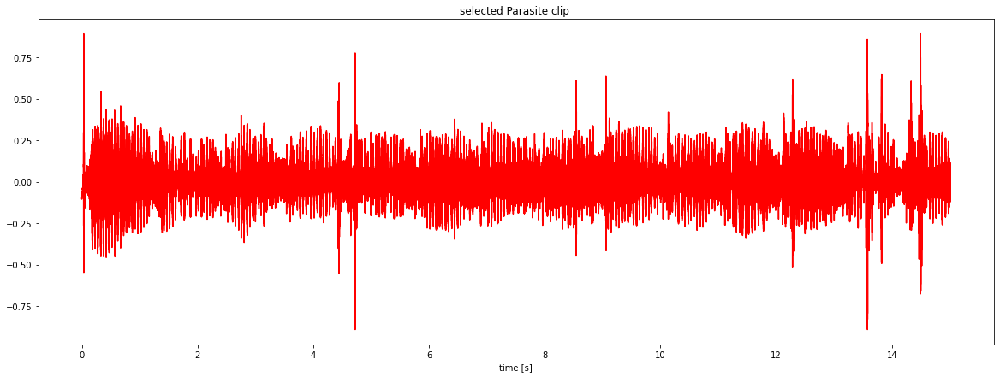

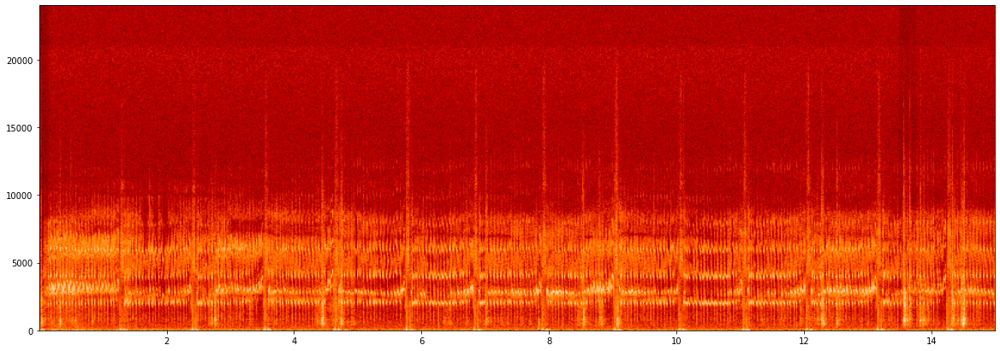

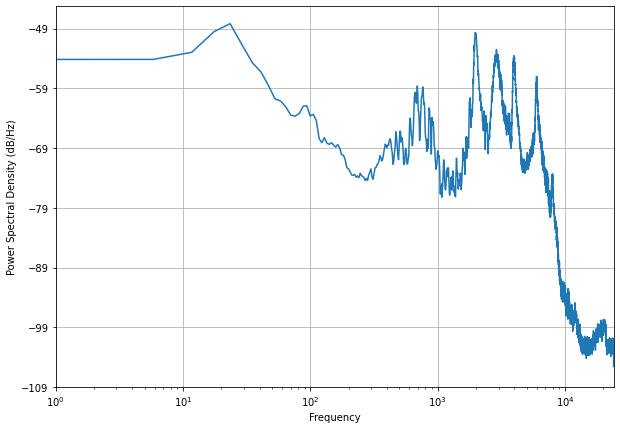

PARASITE AUDIO CLIP TO USE


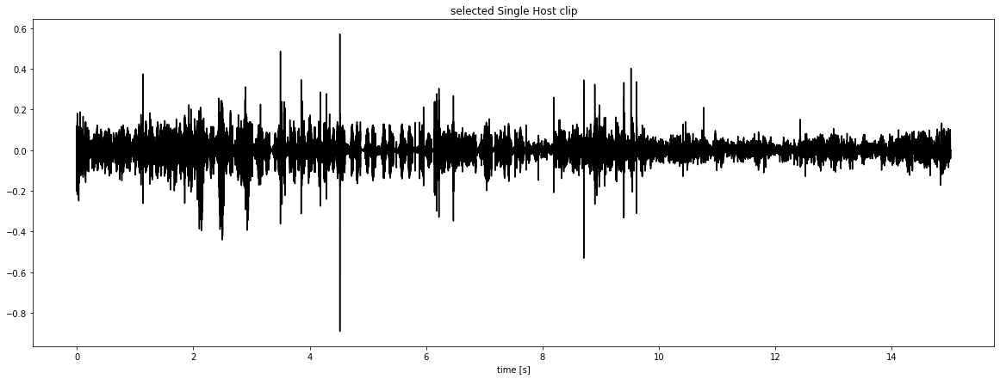

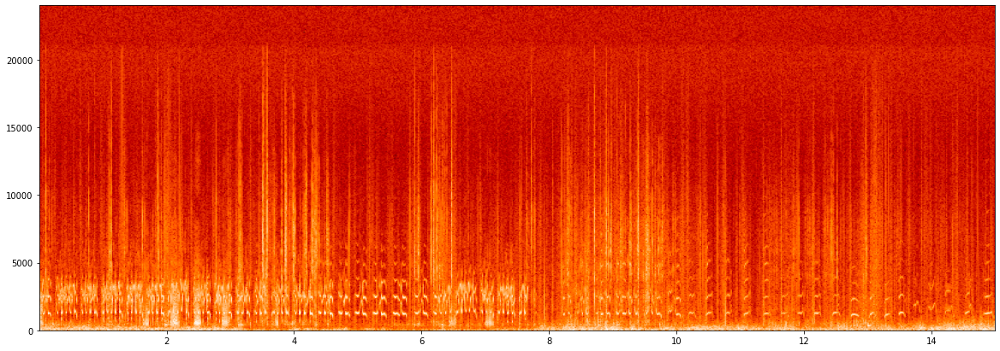

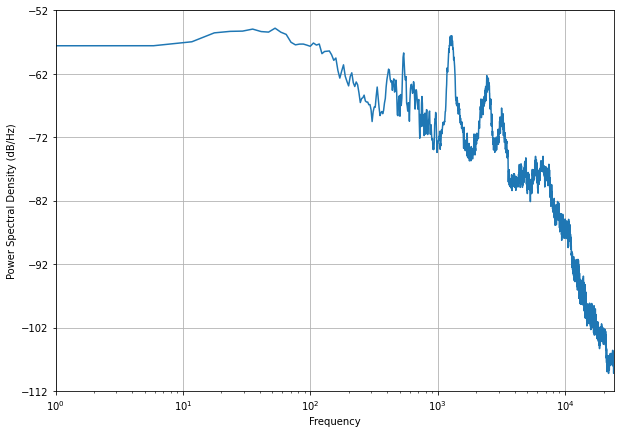

SINGLE HOST AUDIO CLIP TO USE


In [13]:
if not use_full:
  signalP1 = signal_full_P1[signal_start_P1*sr:(signal_start_P1 + signal_duration_P1)*sr]  
  signalSH1 = signal_full_SH1[signal_start_SH1*sr:(signal_start_SH1 + signal_duration_SH1)*sr]
  
else:  
  signal_duration_P1 = min(len(signal_full_P1),len(signal_full_SH1))/sr
  signal_duration_SH1 = min(len(signal_full_P1),len(signal_full_SH1))/sr
  signalP1 = signal_full_P1[0:min(len(signal_full_P1),len(signal_full_SH1))]
  signalSH1 = signal_full_SH1[0:min(len(signal_full_P1),len(signal_full_SH1))]
  signal_start_P1 = 0
  signal_start_SH1 = 0


if show_plots:    

  tP1 = np.linspace(signal_start_P1,signal_start_P1+signal_duration_P1, len(signalP1))
  plt.figure(figsize=(20,7))
  plt.plot(tP1, signalP1,c='r')
  plt.xlabel('time [s]')
  plt.title('selected Parasite clip ')
  plt.show()

  plt.figure(figsize=(20,7))
  plt.specgram(signalP1, NFFT=1024, Fs=sr, noverlap=128, cmap=plt.cm.gist_heat) 
  plt.show()

  plt.figure(figsize=(10,7))
  plt.psd(signalP1, NFFT=8*1024, Fs=sr)
  plt.xlim([1,int(sr/2)])
  plt.xscale('log')
  plt.show()

  print('PARASITE AUDIO CLIP TO USE')
  ipd.display(ipd.Audio(data=signalP1,rate=sr))



  tSH1 = np.linspace(signal_start_SH1,signal_start_SH1+signal_duration_SH1, len(signalSH1))
  plt.figure(figsize=(20,7))
  plt.plot(tSH1, signalSH1,c='k')
  plt.xlabel('time [s]')
  plt.title('selected Single Host clip')
  plt.show()

  plt.figure(figsize=(20,7))
  plt.specgram(signalSH1, NFFT=1024, Fs=sr, noverlap=128, cmap=plt.cm.gist_heat) 
  plt.show()

  plt.figure(figsize=(10,7))
  plt.psd(signalSH1, NFFT=8*1024, Fs=sr)
  plt.xlim([1,int(sr/2)])
  plt.xscale('log')
  plt.show()

  print('SINGLE HOST AUDIO CLIP TO USE')  
  ipd.display(ipd.Audio(data=signalSH1,rate=sr))



# Build some filters 

In [14]:
###       Bandpass (Butterworth) filter        ### 
#___________________________________________________
def butter_bandpass(lowcut, highcut, fs, order=2):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='bandpass')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=6):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    #y = lfilter(b, a, data)
    y = sig.filtfilt(b, a, data, method='gust')

    return y
#___________________________________________________



###       Another bandpass filter using *FIR*        ### 
#___________________________________________________
def bandpass(input, fs, fpl, fph, bandwidth, ripple_db=65.0):
        """
        Designs a FIR filter that is a bandpass filter.
        fs : sampling frequency (Hz)
        fpl : low pass frequency (Hz)
        fph : high pass frequency (Hz)
        bandwidth : transition bandwidth (Hz)s
        """
        # Compute the order and Kaiser parameter for the FIR filter.
        N, beta = sig.kaiserord(ripple_db, bandwidth / (fs * 0.5) )

        # Use firwin with a Kaiser window to create a lowpass FIR filter.
        taps = sig.firwin(N, [fpl / (fs * 0.5), fph / (fs * 0.5)], window=('kaiser', beta),pass_zero='bandpass')

        # the filter must be symmetric, in order to be zero-phase
        assert np.all(np.abs(taps - taps[::-1]) < 1e-15)

        input_filt = sig.filtfilt(taps, 1, input, method = 'pad', padtype = 'constant')

        w,h = sig.freqz(taps, worN=16384)
        f=(fs/2)*w/(np.pi)
        
        return input_filt, f, h
#___________________________________________________



###         Lowpass filter        ###   
#___________________________________________________
def lowpass(input, fs, fc, bandwidth, ripple_db=65.0):
        """
        Designs a FIR filter that is a low-pass filter.
        fs : sampling frequency (Hz)
        fc : cut-off frequency (Hz)
        bandwidth : transition bandwidth (Hz)s
        """
        # Compute the order and Kaiser parameter for the FIR filter.
        N, beta = sig.kaiserord(ripple_db, bandwidth / (fs * 0.5) )

        # Use firwin with a Kaiser window to create a lowpass FIR filter.
        taps = sig.firwin(N, fc / (fs * 0.5), window=('kaiser', beta))

        # the filter must be symmetric, in order to be zero-phase
        assert np.all(np.abs(taps - taps[::-1]) < 1e-15)

        input_filt = sig.filtfilt(taps, 1, input, method = 'pad', padtype = 'constant')

        return input_filt
#___________________________________________________


###      Bandstop (notch) filter        ### 
#___________________________________________________
def bandstop(input,fs, fstop, quality_factor=1.2):
    """
    Designs a IIR bandstop filter.
    fs : sampling frequency (Hz)
    fstop : frequency to remove (Hz)
    quality_factor : dimensionless parameter that characterises quality
    """
    b_notch, a_notch = sig.iirnotch(fstop, quality_factor, fs)
    input_notched = sig.filtfilt(b_notch, a_notch, input)
    w,h = sig.freqz(b_notch, a_notch, worN=16384)
    return input_notched, w, h
#___________________________________________________



###        Bandstop (Butterworth) filter        ### 
#___________________________________________________
#def butter_bandstop(lowcut, highcut, fs, order=3):
#    nyq = 0.5 * fs
#    low = lowcut / nyq
#    high = highcut / nyq
#    b, a = butter(order, [low, high], btype='bandstop')
#    return b, a


def butter_bandstop_filter(data, lowcut, highcut, fs, order=3):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='bandstop')
    #b, a = butter_bandstop(lowcut, highcut, fs, order=order)

    z, p, k = sig.tf2zpk(b, a)
    eps = 1e-9
    r = np.max(np.abs(p))
    approx_impulse_len = int(np.ceil(np.log(eps) / np.log(r)))


    y = sig.filtfilt(b, a, data, method='gust',irlen=approx_impulse_len)

    w,h = sig.freqz(b, a, worN=16384)
    f=(fs/2)*w/(np.pi)  
    return y, f , h
#___________________________________________________



# Useful Functions

In [15]:
def apply_bank_filters(signal, sr, freqs, plots=1, bandwidth = 10, ripple_db = 50,audio_player = False, plot_response = 0):


# apply bank-filters to the original parasite signal to create narrowband signals.

# timepoints for the plots
  t = np.linspace(0,len(signal)/sr, len(signal), endpoint=False)


  #rows = int(np.ceil(len(signal)/4))
  #cols = 4
  #fig, axes = plt.subplots(rows, cols, figsize=(25, 20))

  bp_signal = []
  for i in range(len(freqs)-1):
    #r = i // cols
    #c = i % cols
    #ax = axes[r][c]
    lowcut = freqs[i]
    highcut = freqs[i+1]

    y, f, h = bandpass(signal, sr, lowcut, highcut, bandwidth = bandwidth, ripple_db = ripple_db)
    bp_signal.append(y)

    if plots:
      if audio_player:
        ipd.display(ipd.Audio(data=bp_signal[i],rate=sr))
      plt.figure(figsize=(10,7))
      plt.clf()
      plt.plot(t, signal, label='Original full signal')
      plt.plot(t, bp_signal[i], label='Original narrowband signal' )
      plt.xlabel('time (seconds)')
      plt.grid(True)
      plt.axis('tight')
      plt.legend(loc='upper left')
      plt.title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
      plt.show()

    if plots and  plot_response:
      plt.figure(figsize=(12,9))
      plt.plot(f,abs(h))
      plt.plot([lowcut,lowcut],[0,1])
      plt.plot([highcut,highcut],[0,1])
      plt.xlabel('Frequency [Hz]')
      plt.xscale('log')
      plt.title('Bandpass filter frequency response')
      plt.show()

  return bp_signal  


def get_AE(signal, sr, freqs, plots=1):

# For each of the original narrowband signals get the A.E. using Hilbert transform


  rows = int(np.ceil(len(signal)/4))
  cols = 4
  fig, axes = plt.subplots(rows, cols, figsize=(25, 20))

  amp_env = []
  inst_phase_o = []
  f_i=0

  for j in range(len(signal)):
    r = j // cols
    c = j % cols
    ax = axes[r][c]

    t = np.linspace(0,len(signal[j])/sr, len(signal[j]), endpoint=False)
    lowcut = freqs[f_i]
    highcut = freqs[f_i+1]
    z = (hilbert(signal[j])) #form the analytical signal
    amp_env.append(np.abs(z)) #envelope extraction
    inst_phase_o.append(np.unwrap(np.angle(z)))#inst phase
    inst_freq = np.diff(inst_phase_o)/(2*np.pi)*sr #inst frequency

    if plots:
      ax.plot(t,signal[j])
      ax.plot(t,amp_env[j])
      #plt.set_ylim([-0.5,0.5])
      ax.set_xlabel('time [s]')
      ax.set_ylabel('Amplitude')
      ax.set_title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
      #plt.show()
    f_i+=1
  fig.tight_layout()  
  plt.show()
  return amp_env, inst_phase_o    


def mod_amp_filter(amp_env, sr, low_cutoff, high_cutoff, order = 2, plots = 1, plot_response = 1):

  amp_env_filtered=[]

  rows = int(np.ceil(len(amp_env)/4))
  cols = 4
  fig, axes = plt.subplots(rows, cols, figsize=(25, 20))

  for j in range(len(amp_env)):

    r = j // cols
    c = j % cols
    ax = axes[r][c]

    y , f ,h = butter_bandstop_filter(amp_env[j], low_cutoff, high_cutoff, sr, order=order)
    amp_env_filtered.append(y)
    if plots:
      t = np.linspace(0,len(amp_env[j])/sr, len(amp_env[j]), endpoint=False)
      ax.plot(t,amp_env[j], label='original AE')
      ax.plot(t,amp_env_filtered[j], label='bandstop-filtered AE')
      ax.legend()
      ax.set_xlabel('time [s]')
  fig.tight_layout()  
  plt.show()
  
  if plots and plot_response:
    plt.figure(figsize=(12,9))
    plt.plot(f,abs(h))
    #plt.plot(f,20*np.log10(abs(h)))
    plt.plot([low_cutoff,low_cutoff],[0,1])
    plt.plot([high_cutoff,high_cutoff],[0,1])
    #plt.xlim([1050,1150])
    plt.xlabel('Frequency [Hz]')
    #plt.ylabel('Amplitude [dB]')
    plt.xscale('log')
    plt.title('Bandstop filter frequency response')
    plt.show()
  return amp_env_filtered


def periodogram_comparison_plot(signal1, signal2, fs = sr, sum_ae = True, signal1_name='original AE', signal2_name = 'filtered AE'):
  
  if sum_ae == True:
    full_original = sum(signal1)
    f_psd_o,psd_o = sig.periodogram(full_original,sr)

    full_filtered = sum(signal2)
    f_psd_f,psd_f = sig.periodogram(full_filtered,sr)

    plt.figure(figsize=(10,7))
    plt.plot(f_psd_o,psd_o,label='Full wideband ' + signal1_name)
    plt.plot(f_psd_f,psd_f,label='Full wideband ' + signal2_name)
    plt.xscale('log')
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('PSD [V**2/Hz]')
    #plt.xlim([1,500])
    plt.plot([low_bs_f,low_bs_f],[1e-14,1e-2],label = str(low_bs_f)+'Hz')
    plt.plot([high_bs_f,high_bs_f],[1e-14,1e-2],label = str(high_bs_f)+'Hz')
    plt.ylim([1e-13,1e-2])
    plt.legend()
    plt.show()

  elif sum_ae == False:
    rows = int(np.ceil(len(signal1)/4))
    cols = 4
    n = rows*cols
    fig, axes = plt.subplots(rows, cols, figsize=(25, 20))

    f_i=0
    for j in range(len(signal1)):

      r = j // cols
      c = j % cols
      ax = axes[r][c]
      lowcut = freqs[f_i]
      highcut = freqs[f_i+1]
      f_psd_o,psd_o = sig.periodogram(signal1[j],sr) # the original narrowband AE  
      f_psd_f,psd_f = sig.periodogram(signal2[j],sr)  # the filtered narrowband AE 

      ax.plot(f_psd_o,psd_o,label='Narrowband ' + signal1_name)
      ax.plot(f_psd_f,psd_f,label='Narrowband ' + signal2_name)

      ax.plot([low_bs_f,low_bs_f],[1e-14,1e-3],label = str(low_bs_f)+'Hz')
      ax.plot([high_bs_f,high_bs_f],[1e-14,1e-3],label = str(high_bs_f)+'Hz')
      ax.set_xscale('log')
      ax.set_yscale('log')
      ax.set_xlabel('Frequency [Hz]')
      ax.set_ylabel('PSD [V**2/Hz]')
      #plt.xlim([1,500])
      ax.set_ylim([1e-14,1e-3])
      ax.legend()
      ax.set_title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
      f_i+=1
  
    fig.tight_layout()  
    plt.show()

  return


def PSD_comparison_plot(signal1, signal2, nfft=2048, fs=22050, sum_ae = True, signal1_name='original AE', signal2_name = 'filtered AE'):
  
  if sum_ae == True:
    full_original = sum(signal1)
    full_filtered = sum(signal2)

    plt.figure(figsize=(10,7))
    plt.psd(full_original,NFFT=nfft, Fs=fs,label='Full wideband ' + signal1_name)
    plt.psd(full_filtered,NFFT=nfft,Fs=fs,label='Full wideband ' + signal2_name)
    plt.xscale('log')
    plt.xlabel('Frequency [Hz]')

    ymin,ymax = plt.ylim()
    plt.plot([low_bs_f,low_bs_f],[ymin,ymax],label = str(low_bs_f)+'Hz')
    plt.plot([high_bs_f,high_bs_f],[ymin,ymax],label = str(high_bs_f)+'Hz')
    plt.legend()
    plt.autoscale(enable=True, axis="y", tight=True)
    plt.show()

  elif sum_ae == False:
    rows = int(np.ceil(len(signal1)/4))
    cols = 4
    n = rows*cols
    fig, axes = plt.subplots(rows, cols, figsize=(25, 20))

    f_i=0
    for j in range(len(signal1)):

      r = j // cols
      c = j % cols
      ax = axes[r][c]
      lowcut = freqs[f_i]
      highcut = freqs[f_i+1]


      ax.psd(signal1[j],NFFT=nfft, Fs=fs,label='Narrowband ' + signal1_name)
      ax.psd(signal2[j],NFFT=nfft, Fs=fs,label='Narrowband ' + signal2_name)
    
      ymin,ymax = ax.get_ylim()

      ax.plot([low_bs_f,low_bs_f],[ymin,ymax],label = str(low_bs_f)+'Hz')
      ax.plot([high_bs_f,high_bs_f],[ymin,ymax],label = str(high_bs_f)+'Hz')
      ax.set_xscale('log')
      ax.set_xlabel('Frequency [Hz]')
      ax.autoscale(enable=True, axis="y", tight=True)
      ax.legend()
      ax.set_title(str(round(lowcut,1))+' - '+str(round(highcut,1))+' Hz')
      f_i+=1
  
    fig.tight_layout()  
    plt.show()

  return


# define a function that does half-wave rectification
def half_rectify(amp_env, sr, plots = 1):
  '''
#  Half rectifies a signal: set all negative values to zero
#  input: a signal in the form of a list/array
#  output: rectified signal
#  '''
  amp_env_rect = []

  for ae in amp_env:
    amp_env_rect.append(np.asarray([0 if i<0 else i for i in ae]))
    #amp_env_rect.append(np.asarray([np.abs(i) for i in ae]))

  if plots:
    for i in range(len(amp_env)):
      t = np.linspace(0,len(amp_env[i])/sr, len(amp_env[i]), endpoint=False)
      plt.figure(figsize=(12,9))
      plt.plot(t,amp_env[i],label='bandstop-filtered AE')
      plt.plot(t,amp_env_rect[i],label='rectified bandstop-filtered AE')
      plt.xlabel('time [s]')
      plt.legend()
      plt.show()

  return amp_env_rect


def sig_removed(amp_env, amp_env_filtered, plots = 1):

# this is the difference (in the time-amplitude domain) between the original narrowband AEs and the filtered narrowband AEs 
# (i.e. AE with specific modulation frequencies removed).

  sig_removed = np.subtract(amp_env, amp_env_filtered)

  if plots:
    for i in range(len(sig_removed)):
      plt.figure(figsize=(10,7))
      plt.plot(amp_env[i],label='orig. AE')
      plt.plot(sig_removed[i],label='orig. AE - mod. AE ')
      plt.legend()
      plt.show()
  return sig_removed


def implant(amp_env_recipient, extracted_donor_signal):

#implant an extracted signal from the AEs of one signal (donor) into the AEs of another signal (recipient)

  if len(amp_env_recipient) != len(extracted_donor_signal):
    print('the recipient and donor signals should be of the same length')
    return

  modified_amp_env = []

  for i in range(len(amp_env_recipient)):
    modified_amp_env.append(amp_env_recipient[i] + extracted_donor_signal[i])

  return modified_amp_env



def envR(ae1,ae2):
  env_ratio = [i/j for i,j in zip(ae1,ae2)]
  return env_ratio


def env_to_sig(ae,orig_sig):
  mod_sig = [i*j for i,j in zip(ae,orig_sig)]
  return mod_sig

# **Modulation filtering** *(remove AE frequencies from Parasite and Single Host)*

## Bank-filter original signals

### Parasite

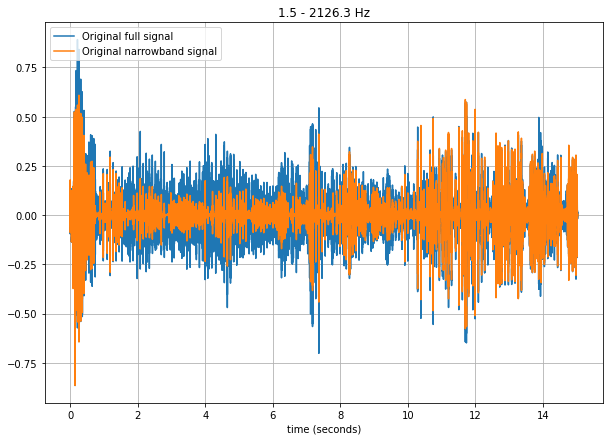

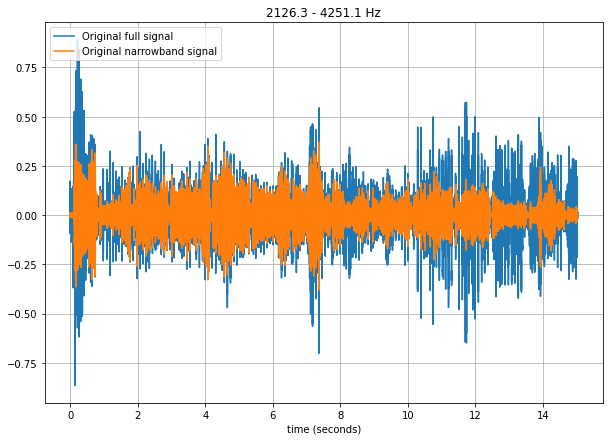

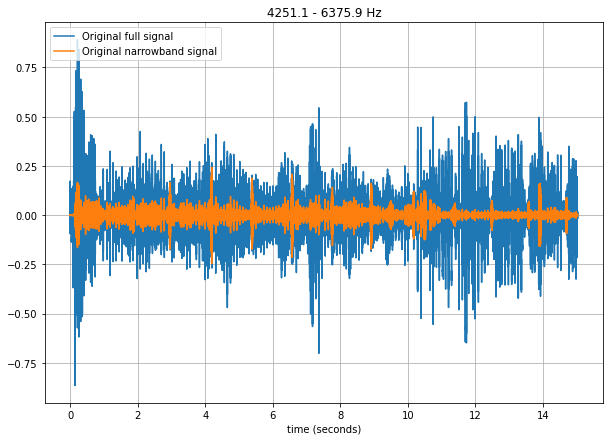

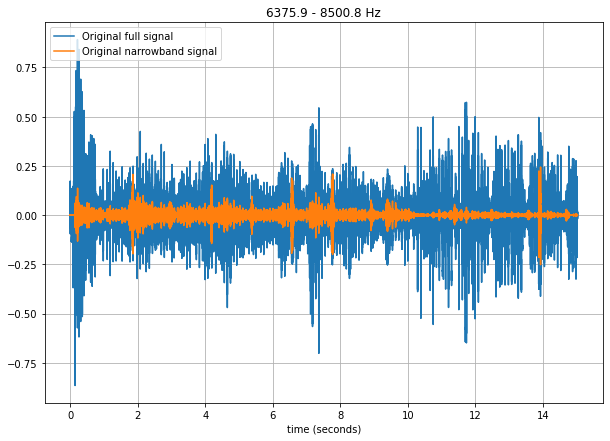

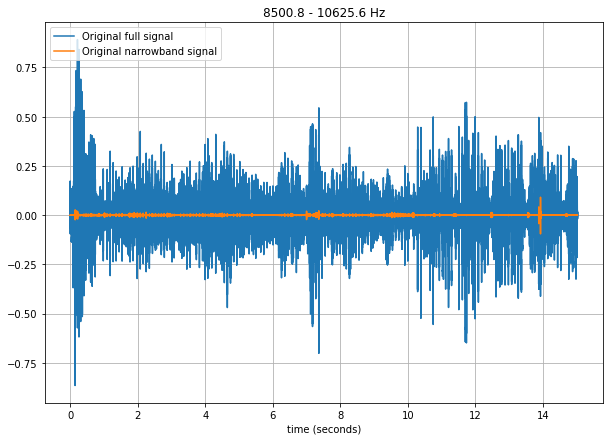

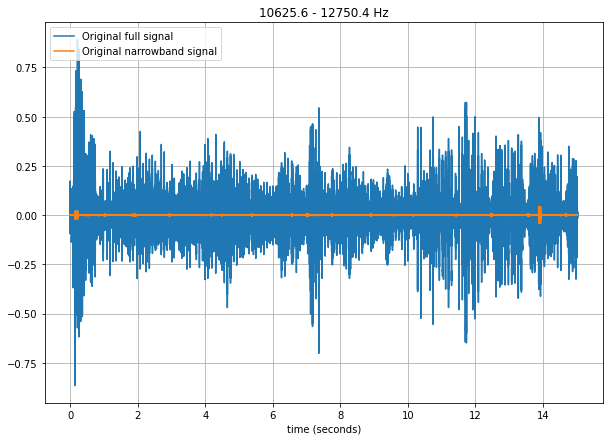

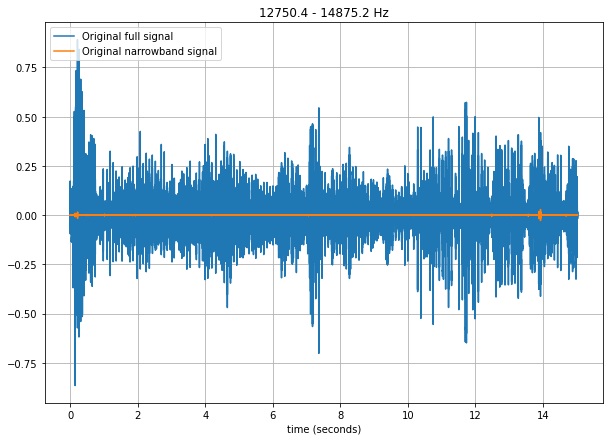

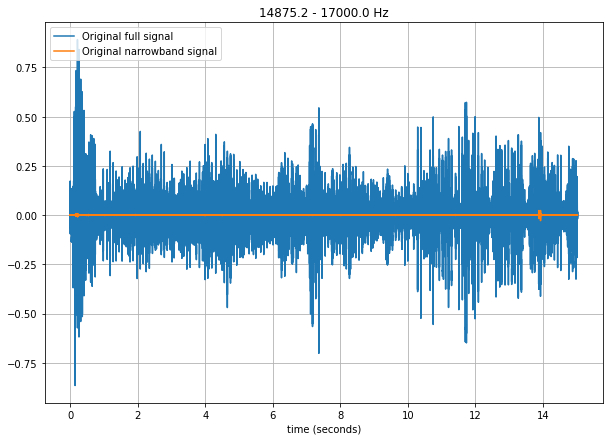

In [16]:
bp_signalP1 = apply_bank_filters(signalP1, sr, freqs, plots=show_plots, bandwidth = 20, ripple_db = 30, audio_player = False)

### Single Host

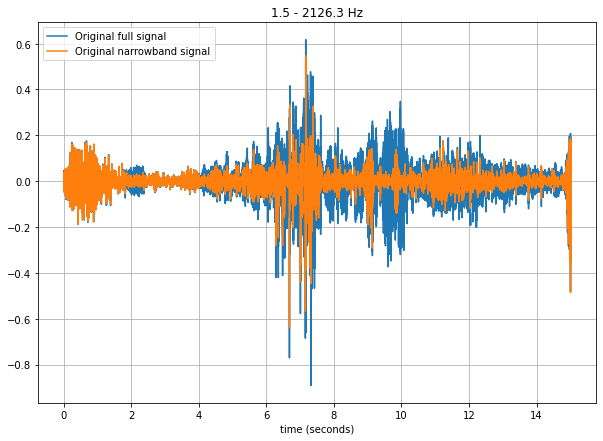

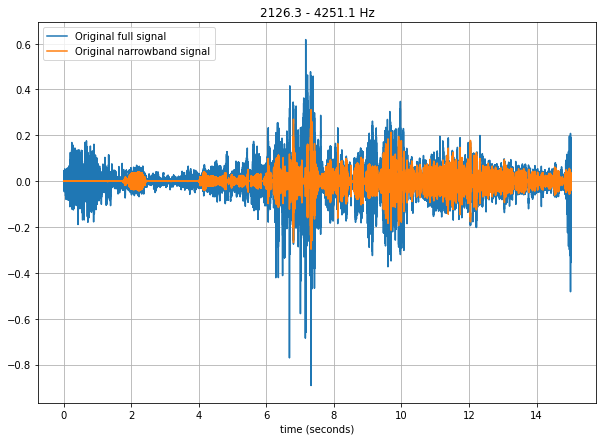

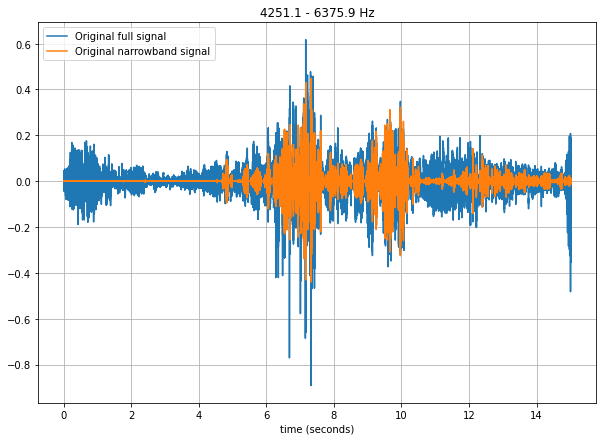

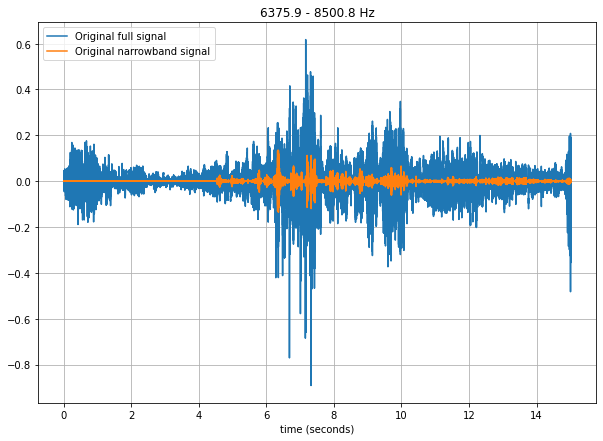

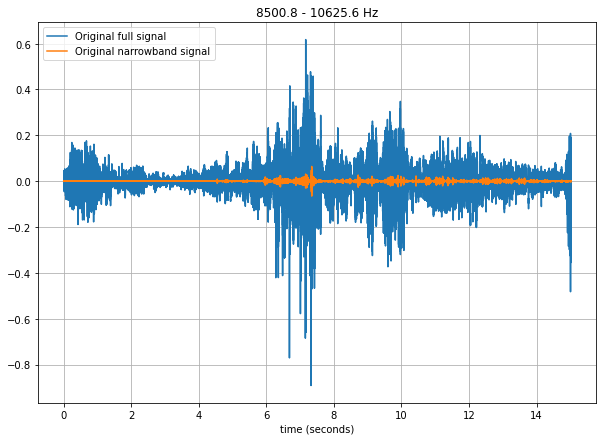

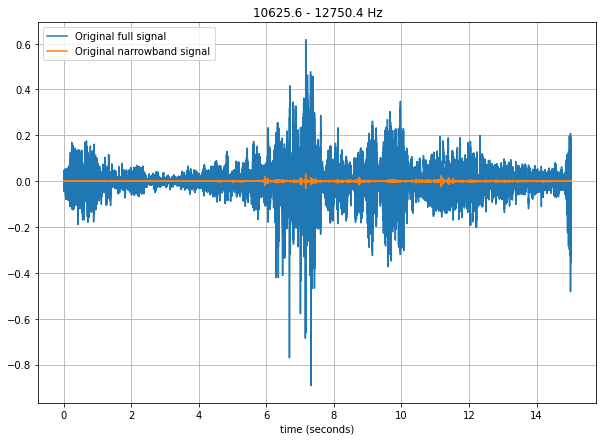

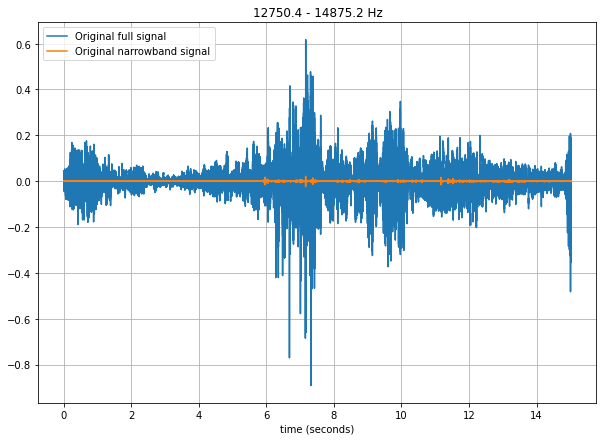

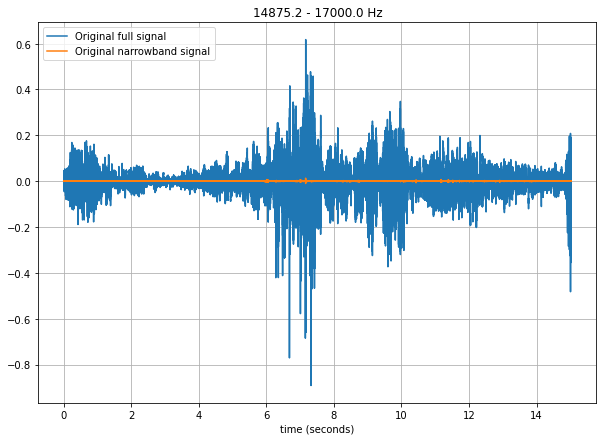

In [17]:
bp_signalSH1 = apply_bank_filters(signalSH1, sr, freqs, plots=show_plots, bandwidth = 20, ripple_db = 30, audio_player = False)

##  Get Amplitude Envelopes (AE)

###For Parasite

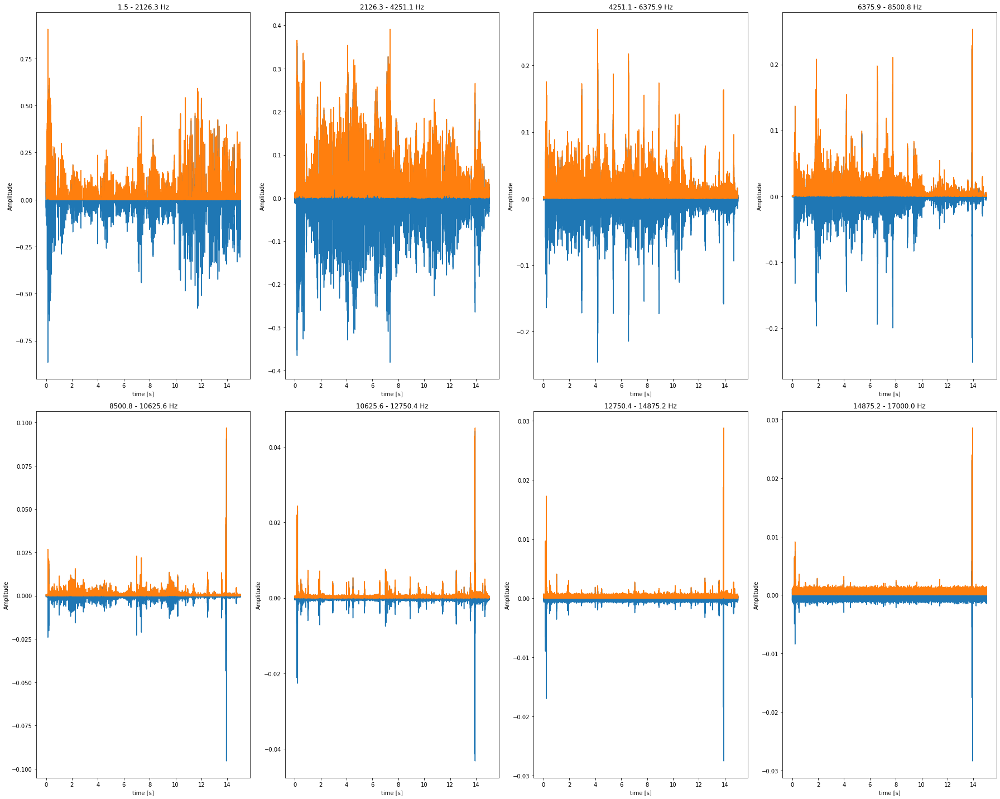

In [18]:
amp_env_P1, inst_phase_P1 = get_AE(bp_signalP1, sr, freqs, plots=show_plots)

###For Single Host

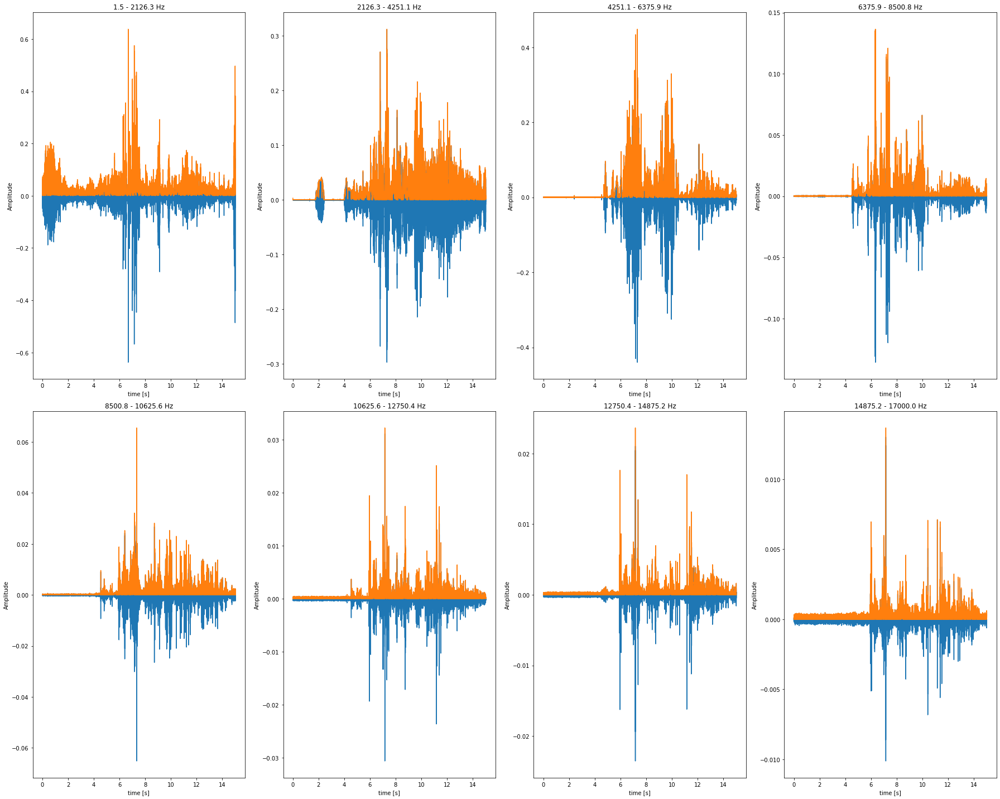

In [19]:
amp_env_SH1, inst_phase_SH1 = get_AE(bp_signalSH1, sr, freqs, plots=show_plots)

##  Filter AEs using Butterworth bandstop filter

###For Parasite

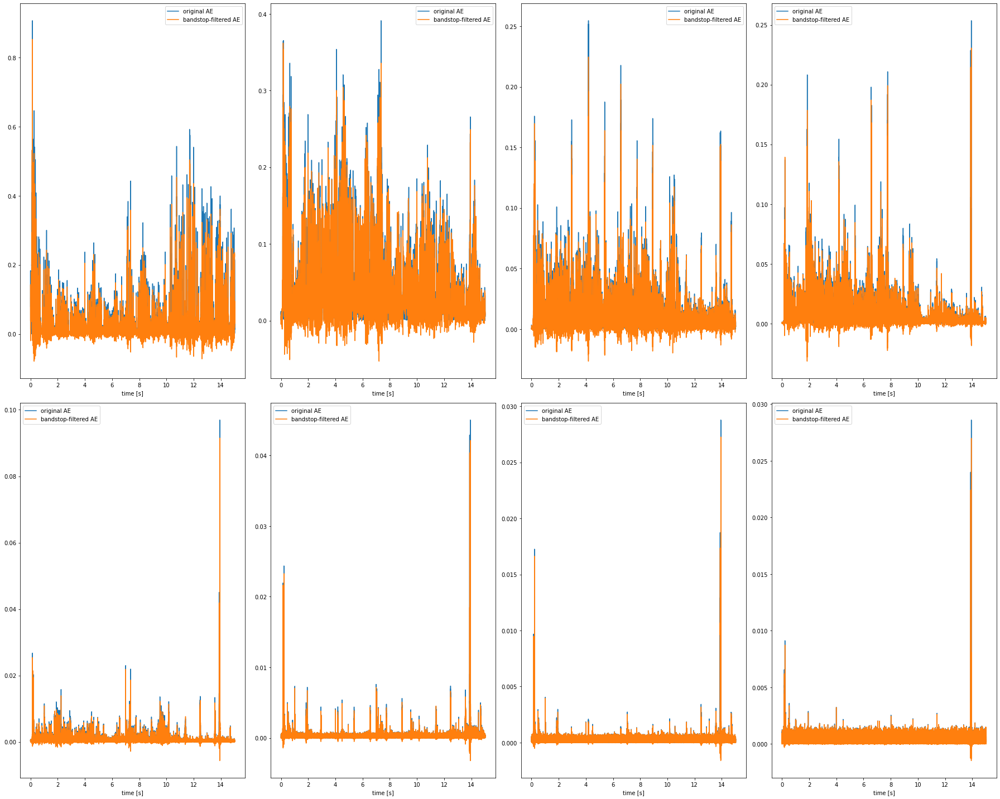

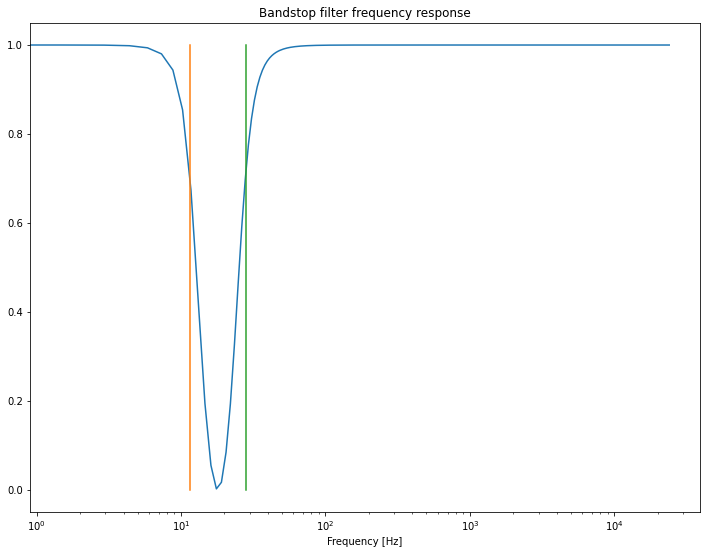

In [20]:
amp_env_filtered_P1 = mod_amp_filter(amp_env_P1, sr, low_bs_f, high_bs_f, order = 2 , plots=show_plots, plot_response = 1)

###For Single Host

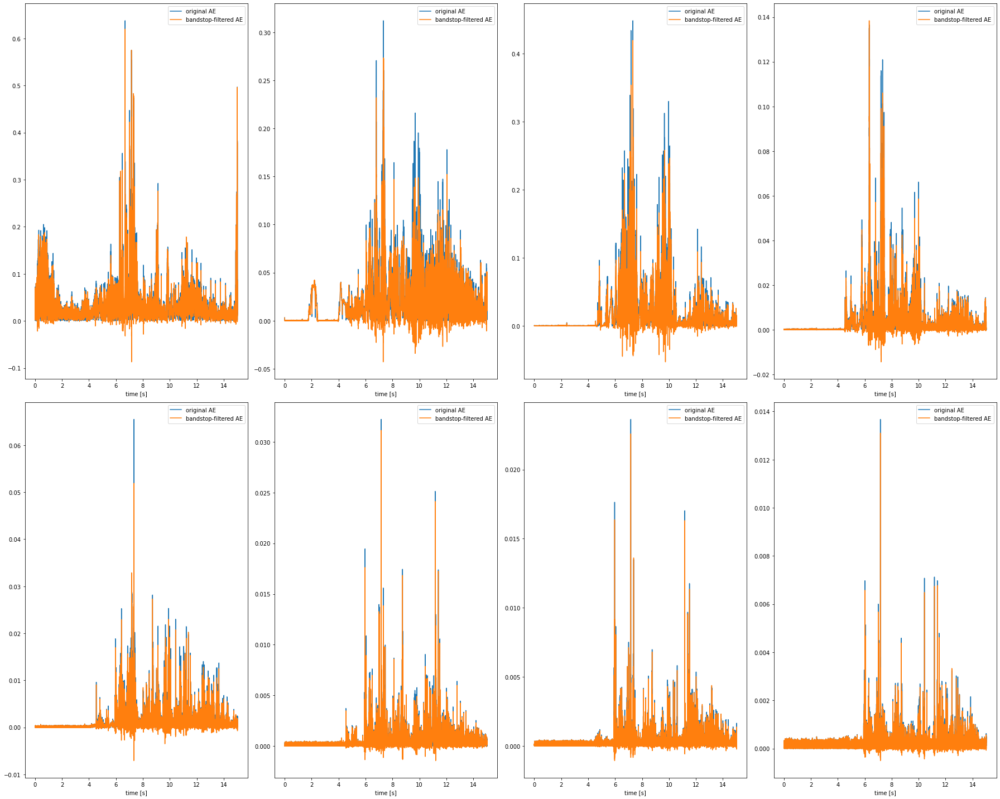

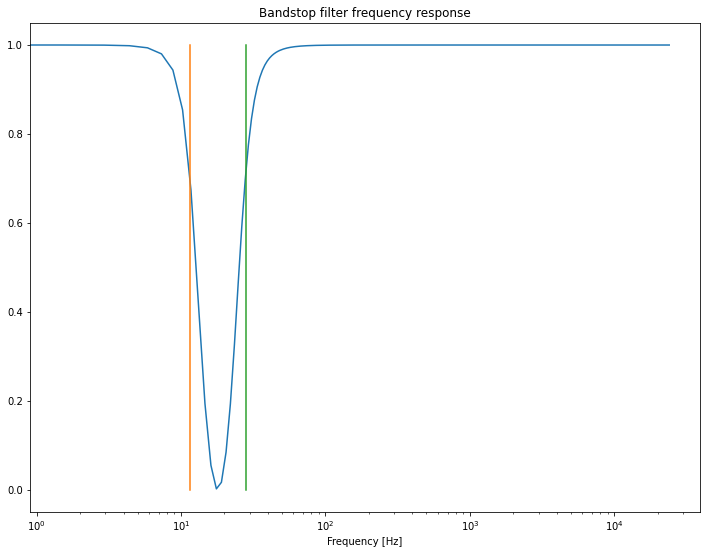

In [21]:
amp_env_filtered_SH1 = mod_amp_filter(amp_env_SH1, sr, low_bs_f, high_bs_f, order = 2,  plots=show_plots, plot_response = 1)

## Power Spectral Density of filtered AE

###For Parasite 

Full filtered wideband signal AE

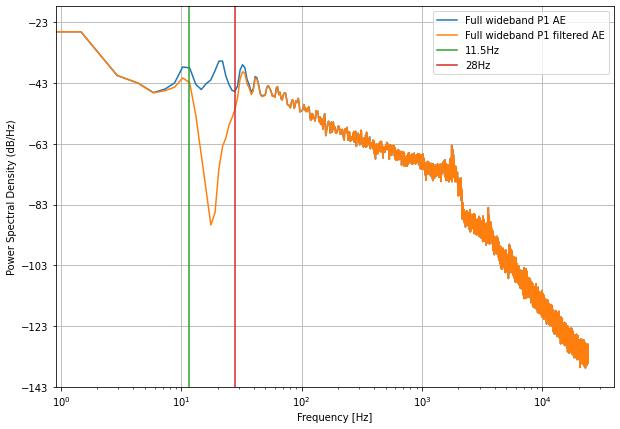

In [22]:
PSD_comparison_plot(signal1=amp_env_P1, signal2=amp_env_filtered_P1, nfft=16384*2,fs=sr, sum_ae=True, signal1_name = 'P1 AE', signal2_name = 'P1 filtered AE')

For filtered narrowband signals AE

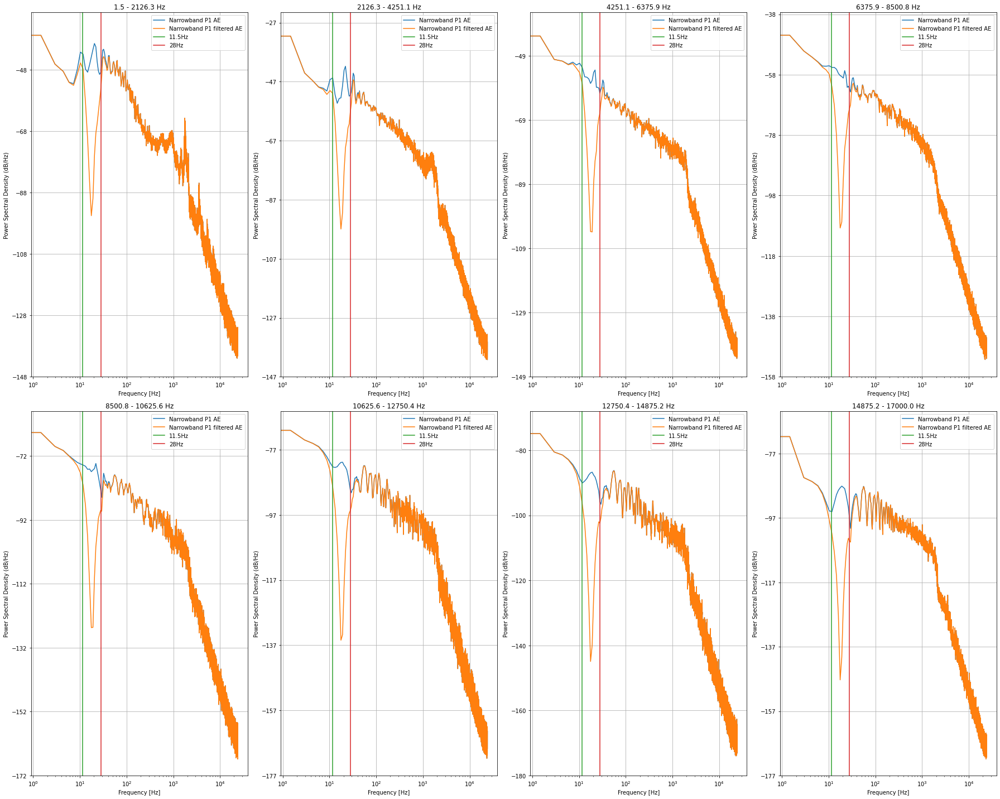

In [23]:
PSD_comparison_plot(signal1 = amp_env_P1, signal2 = amp_env_filtered_P1, nfft=16384*2,fs=sr, sum_ae=False, signal1_name = 'P1 AE', signal2_name = 'P1 filtered AE')

### For Single Host

For the full filtered wideband signal AE

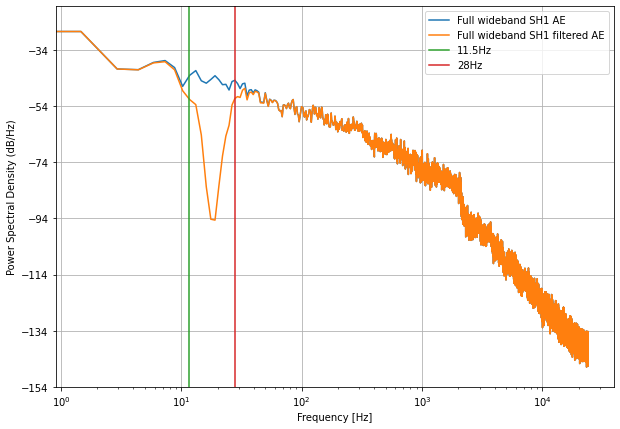

In [24]:
PSD_comparison_plot(signal1 = amp_env_SH1, signal2 = amp_env_filtered_SH1, nfft=16384*2, fs = sr, sum_ae = True, signal1_name = 'SH1 AE', signal2_name = 'SH1 filtered AE')

For filtered narrowband signals AE

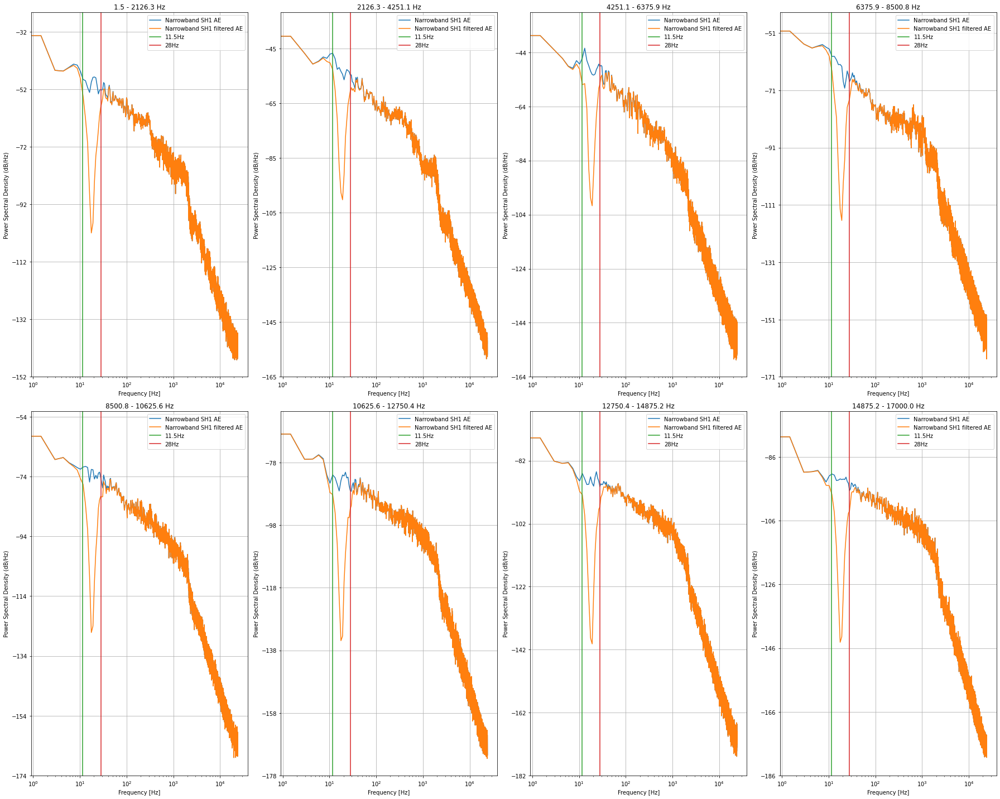

In [25]:
PSD_comparison_plot(signal1 = amp_env_SH1, signal2 = amp_env_filtered_SH1, nfft = 16384*2, fs = sr, sum_ae = False, signal1_name = 'SH1 AE', signal2_name = 'SH1 filtered AE')

## Find diff between original AEs and filtered AEs

###For Parasite

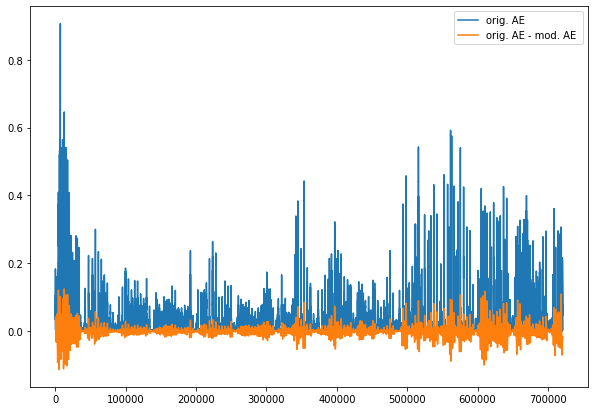

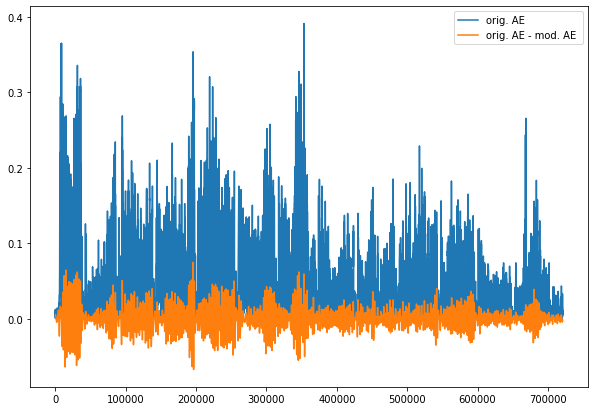

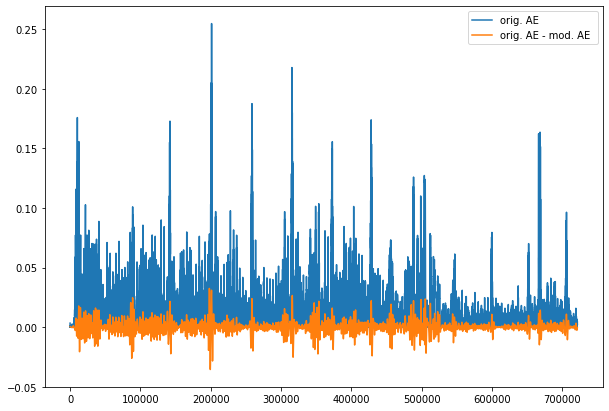

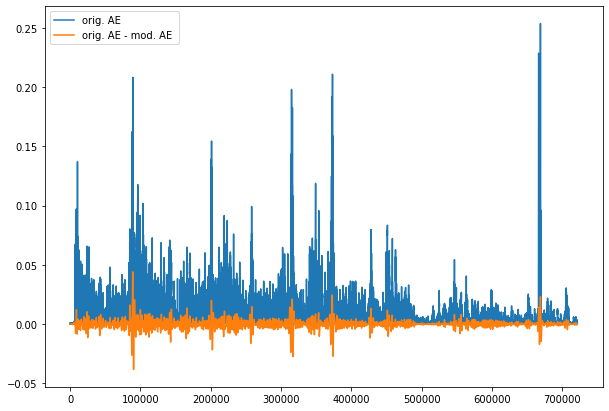

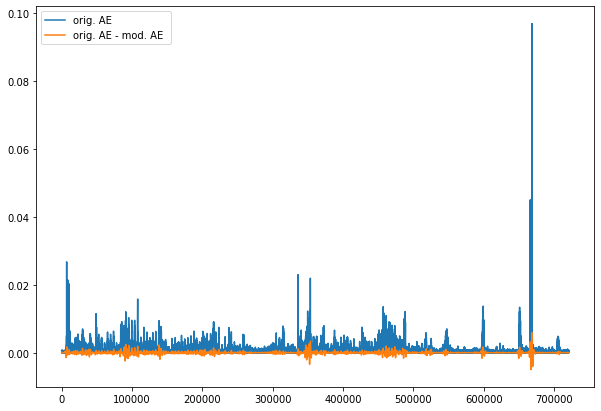

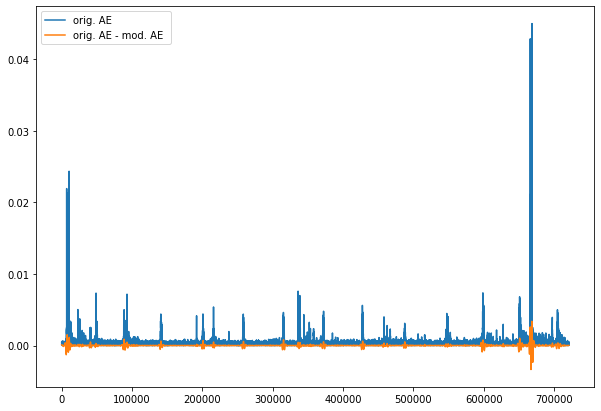

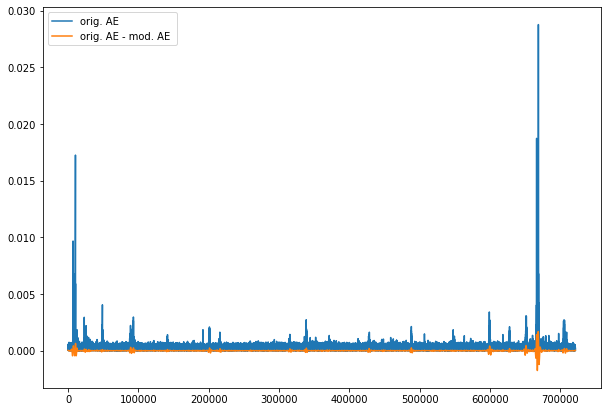

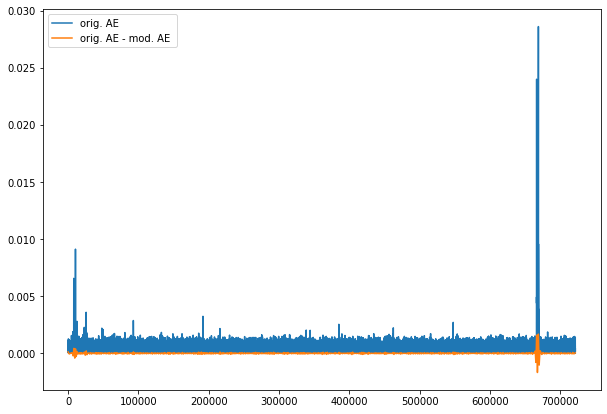

In [26]:
sig_removed_P1 = sig_removed(amp_env_P1, amp_env_filtered_P1, plots = show_plots)


###For Single Host

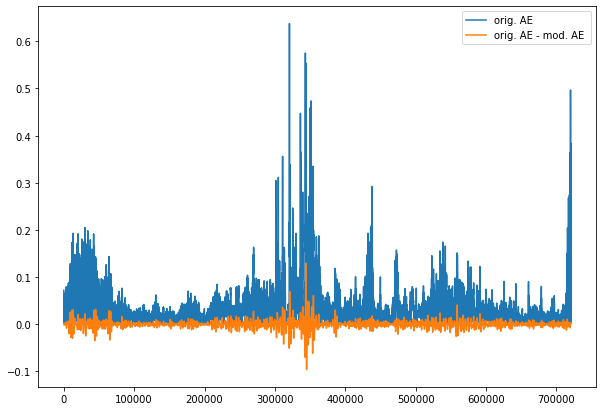

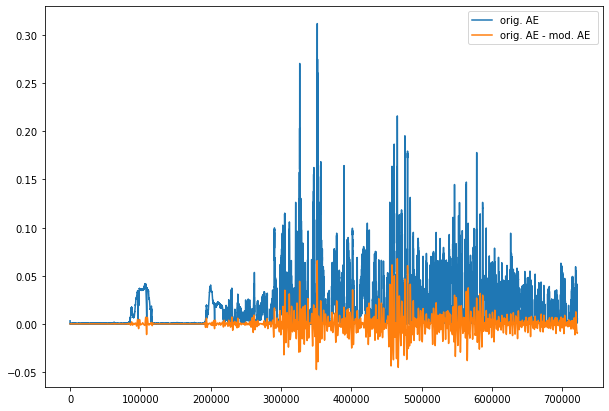

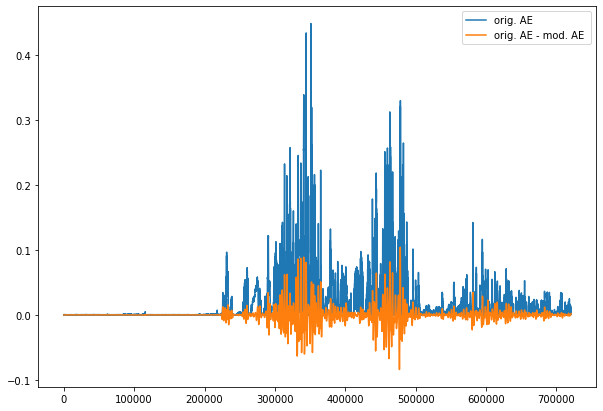

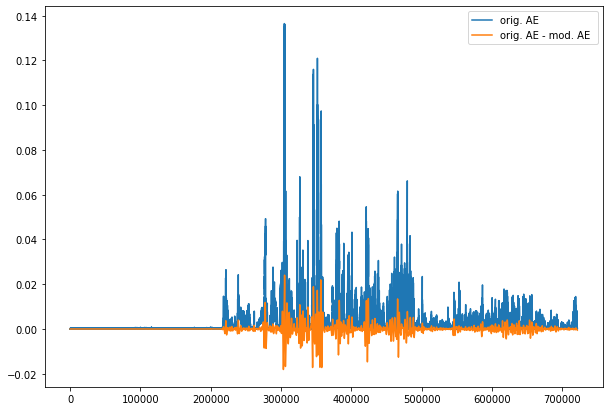

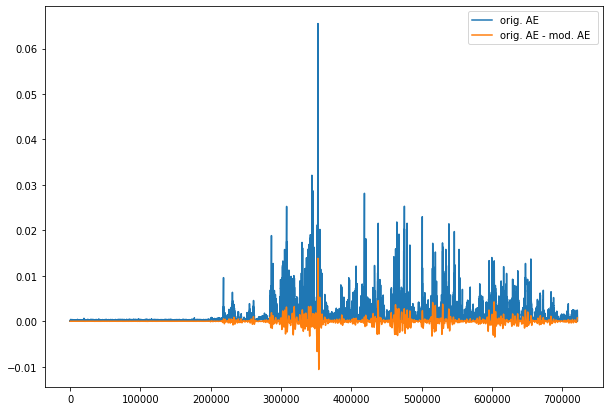

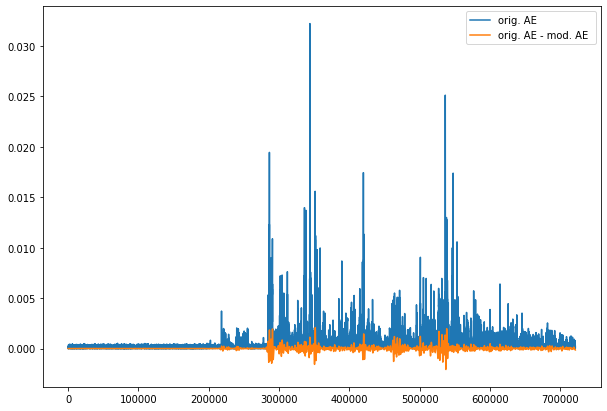

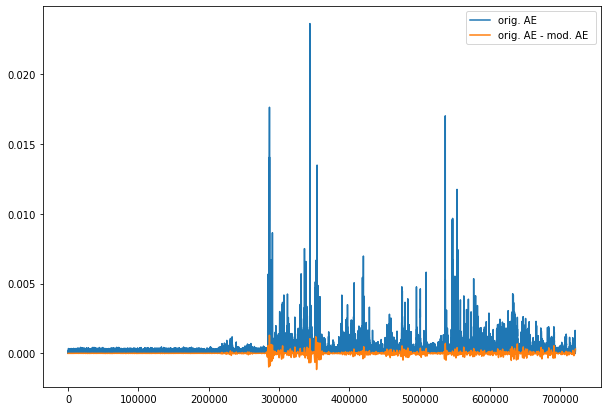

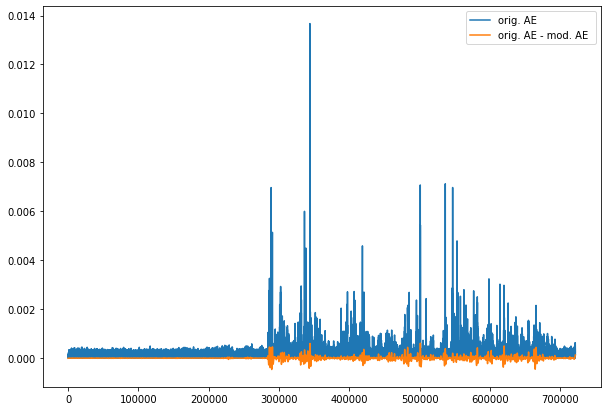

In [27]:
sig_removed_SH1 = sig_removed(amp_env_SH1, amp_env_filtered_SH1, plots = show_plots)


# Implant with replacement (IR)

## For Parasite

### with Single Host as the donor

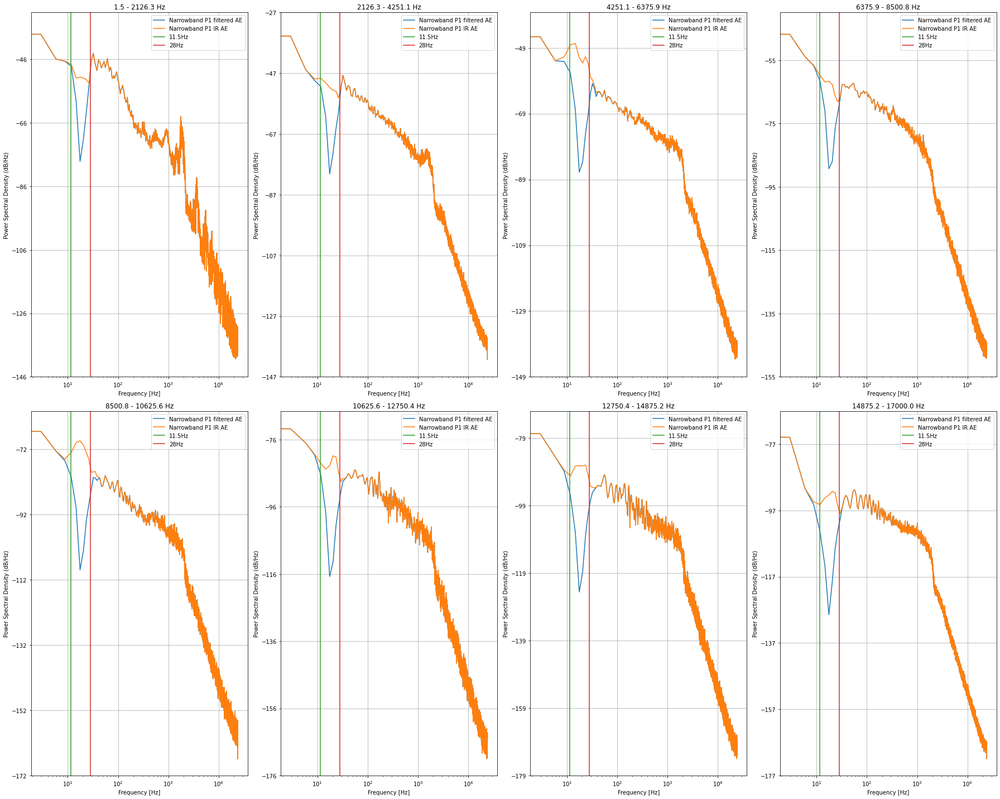

In [28]:
ir_amp_env_P1 = implant(amp_env_filtered_P1, sig_removed_SH1)

PSD_comparison_plot(amp_env_filtered_P1, ir_amp_env_P1, nfft = 16384, fs=sr, sum_ae=False, signal1_name = 'P1 filtered AE', signal2_name = 'P1 IR AE')

### with Parasite as the donor (i.e. retrieve original Parasite signal)

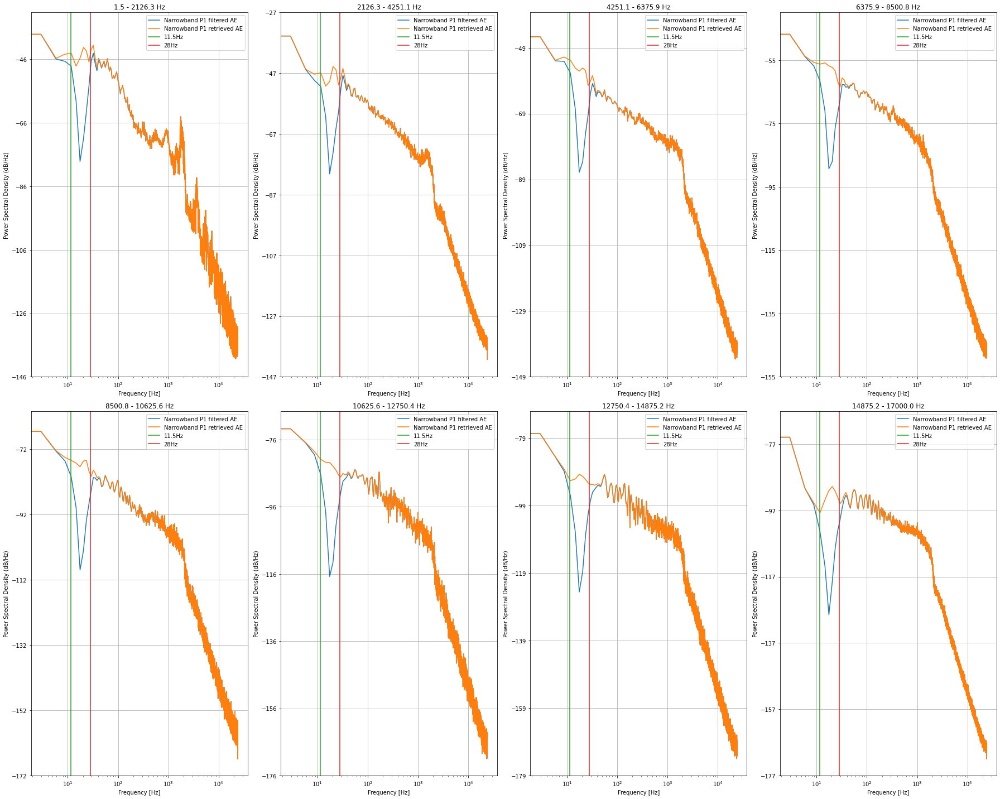

In [29]:
retrieve_amp_env_P1 = implant(amp_env_filtered_P1, sig_removed_P1)

PSD_comparison_plot(amp_env_filtered_P1, retrieve_amp_env_P1, nfft = 16384,  fs = sr, sum_ae=False, signal1_name = 'P1 filtered AE', signal2_name = 'P1 retrieved AE')

## For Single Host

#### with Parasite as the donor

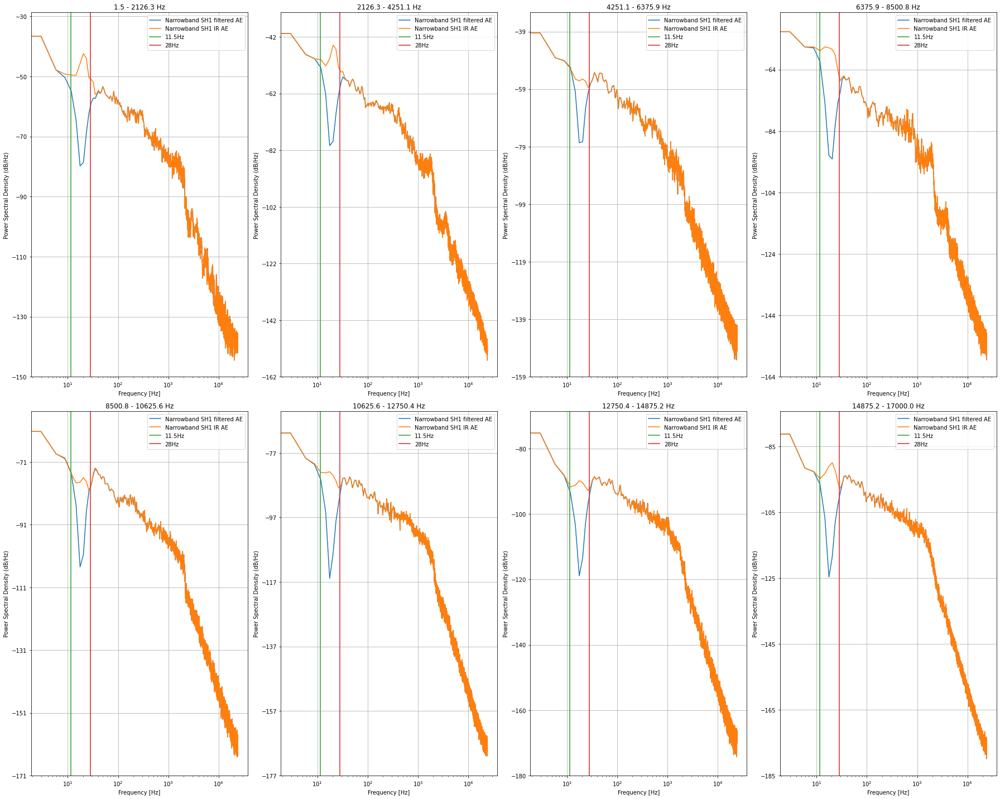

In [30]:
ir_amp_env_SH1 = implant(amp_env_filtered_SH1, sig_removed_P1)
PSD_comparison_plot(amp_env_filtered_SH1, ir_amp_env_SH1, nfft = 16384, fs = sr, sum_ae=False, signal1_name = 'SH1 filtered AE', signal2_name = 'SH1 IR AE')

#### with Single Host as the donor (i.e. retrieve original Single Host signal)

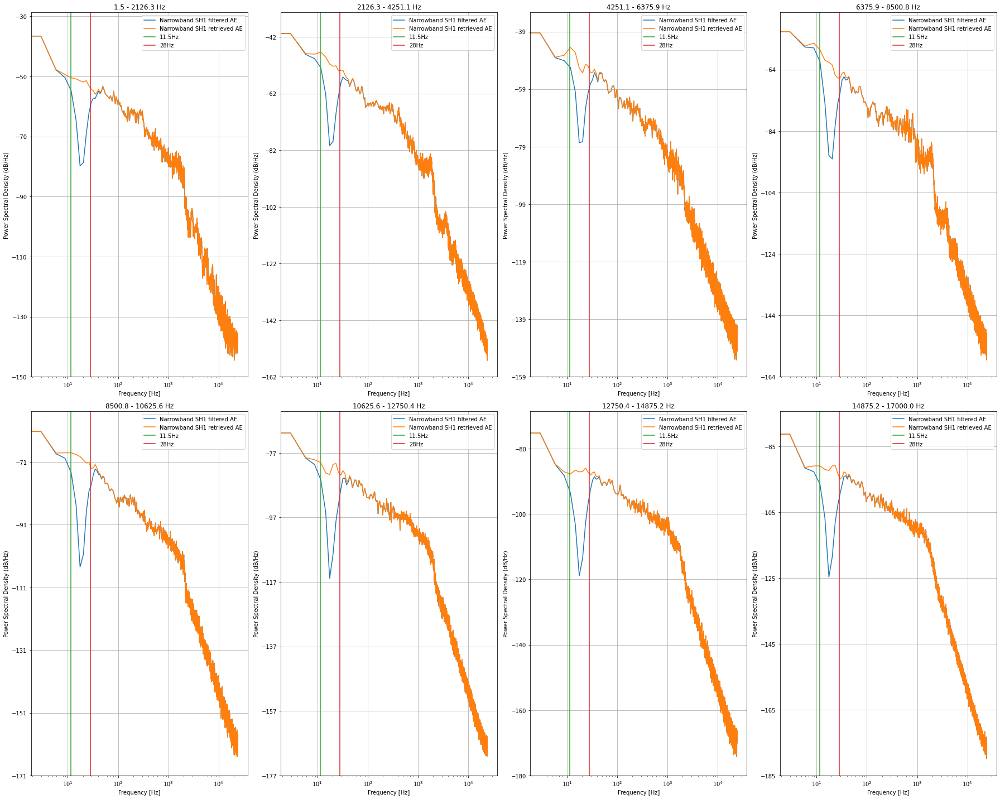

In [31]:
retrieve_amp_env_SH1 = implant(amp_env_filtered_SH1, sig_removed_SH1)

PSD_comparison_plot(amp_env_filtered_SH1, retrieve_amp_env_SH1, nfft = 16384, fs = sr, sum_ae=False,signal1_name = 'SH1 filtered AE', signal2_name = 'SH1 retrieved AE')

# Implant with addition (IA)

### For Parasite

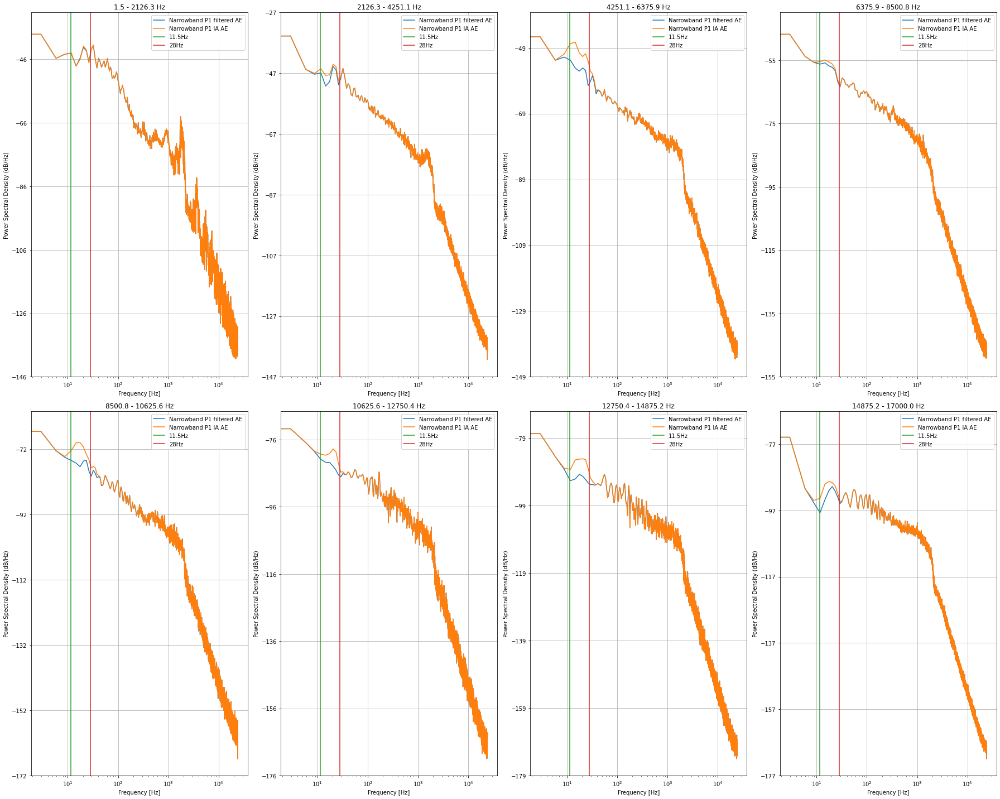

In [32]:
ia_amp_env_P1 = implant(amp_env_P1, sig_removed_SH1)


PSD_comparison_plot(amp_env_P1,ia_amp_env_P1, nfft = 16384, fs = sr, sum_ae=False, signal2_name = 'P1 IA AE', signal1_name = 'P1 filtered AE')

### For Single Host

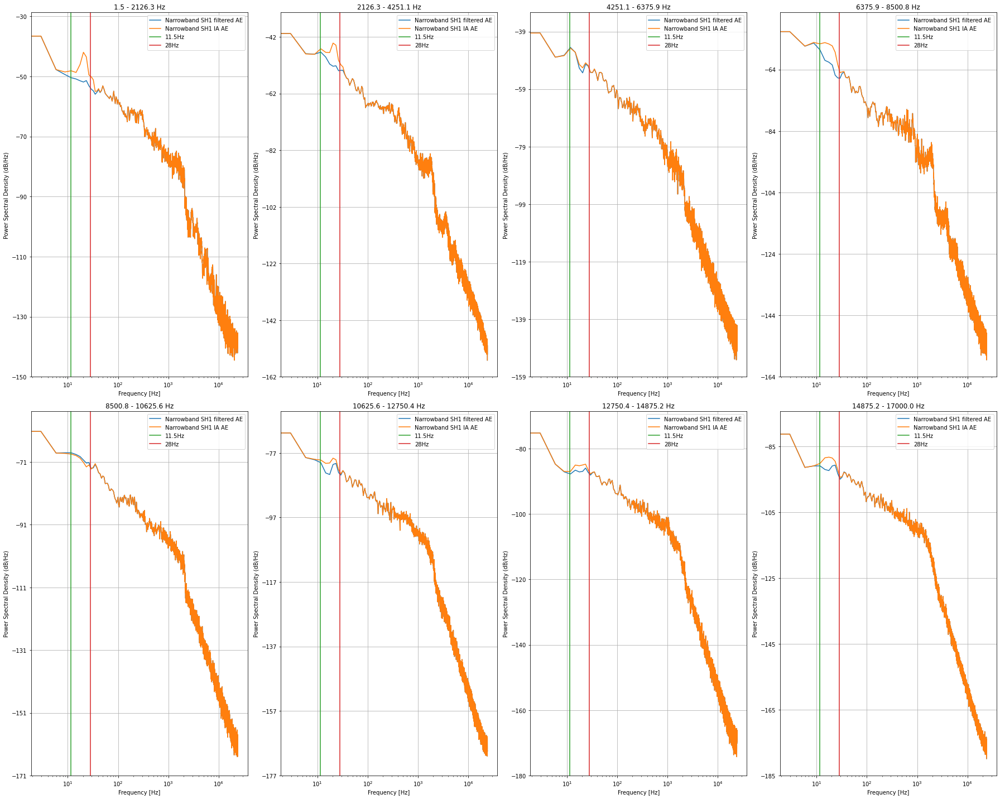

In [33]:
ia_amp_env_SH1 = implant(amp_env_SH1, sig_removed_P1)

PSD_comparison_plot(amp_env_SH1, ia_amp_env_SH1, nfft = 16384, fs = sr, sum_ae=False, signal1_name = 'SH1 filtered AE', signal2_name = 'SH1 IA AE')


# Half-wave rectification

## For Single Host

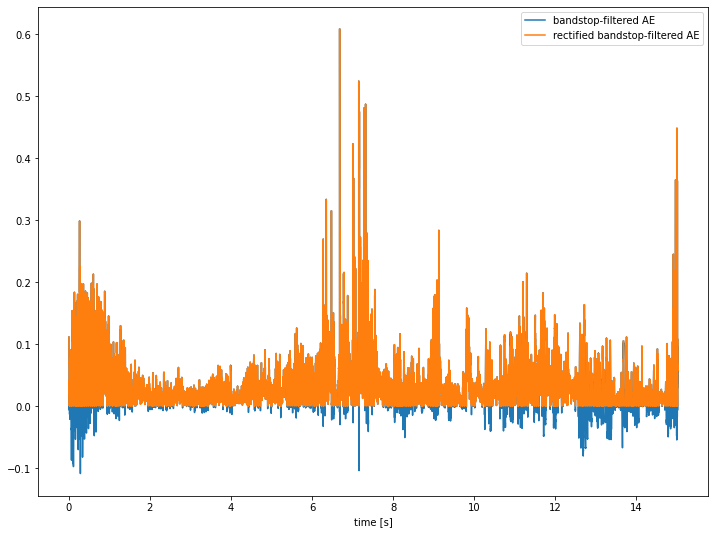

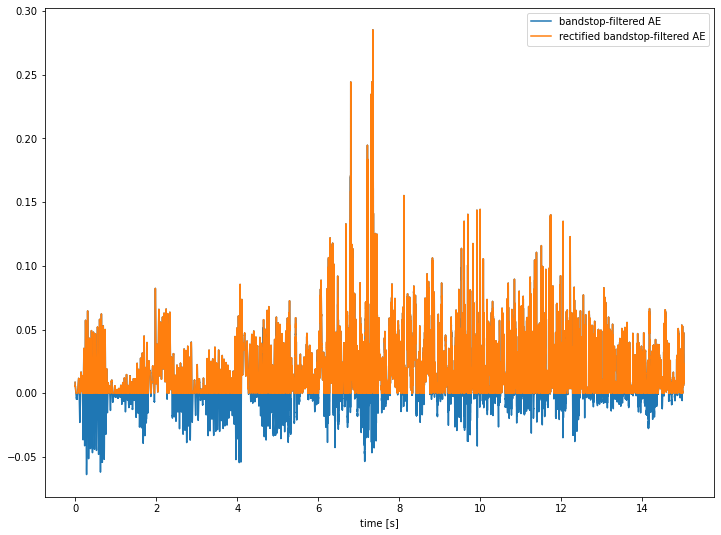

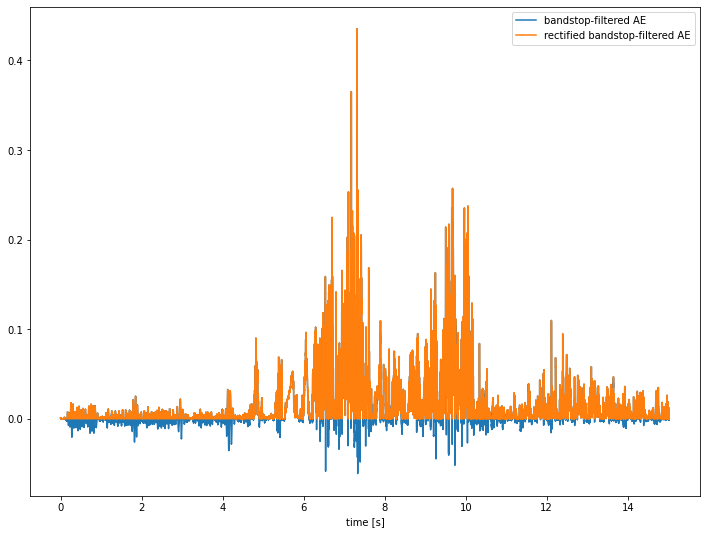

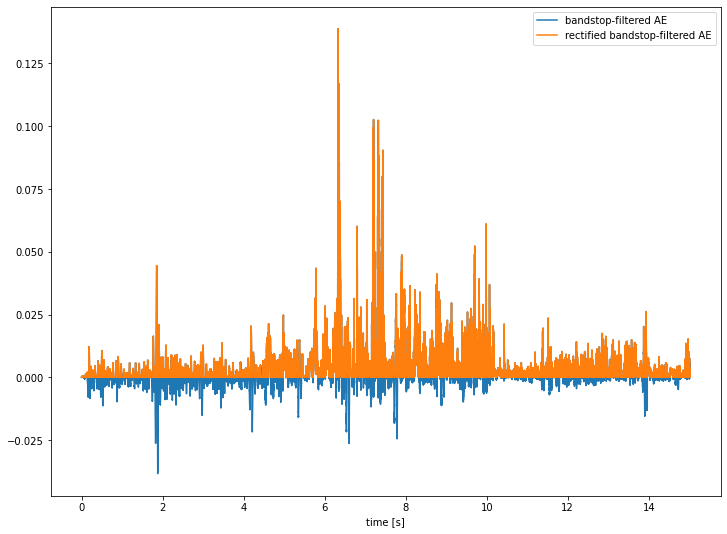

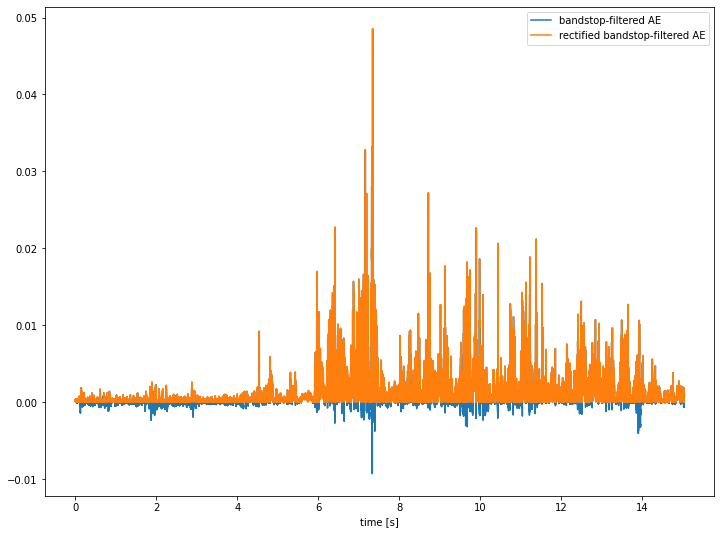

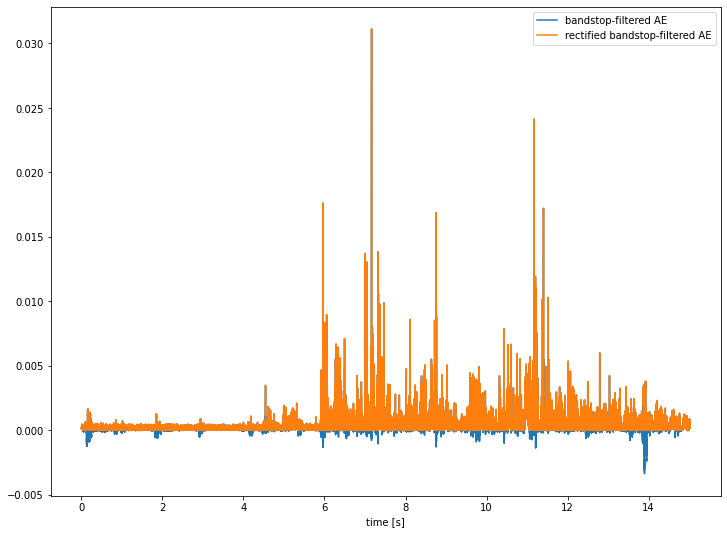

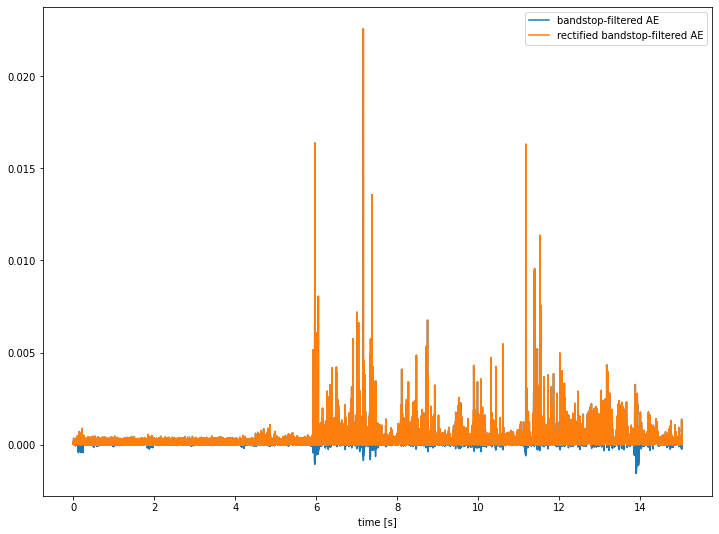

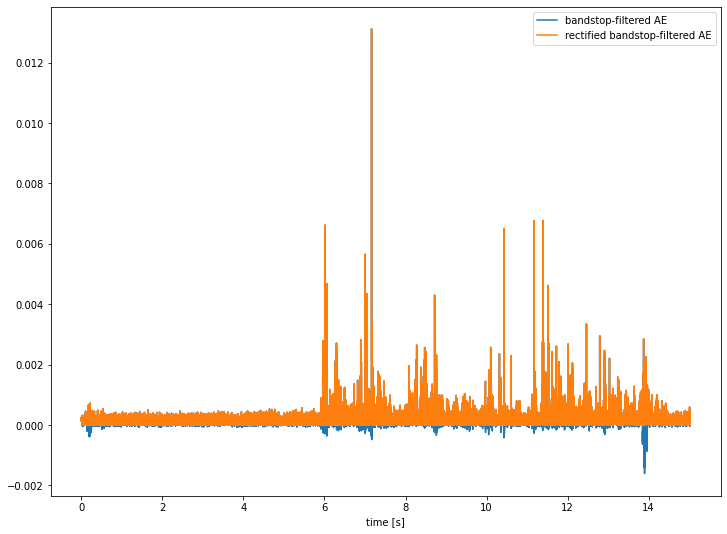

In [34]:
ir_amp_env_rect_SH1 = half_rectify(ir_amp_env_SH1,sr,plots=show_plots)

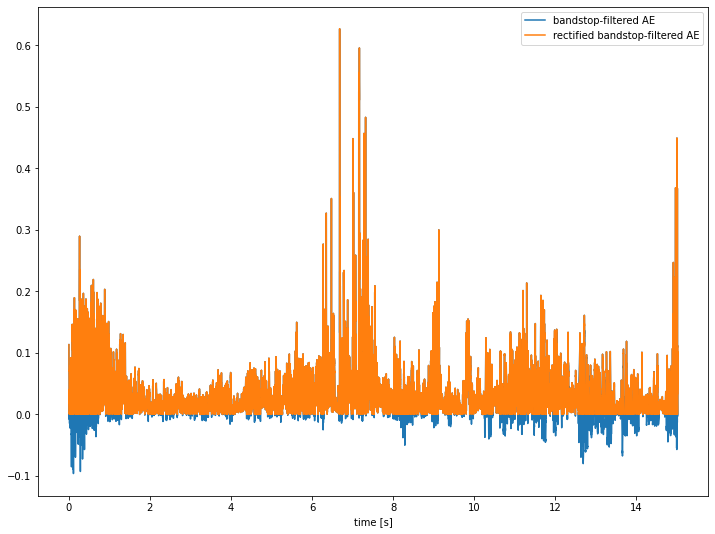

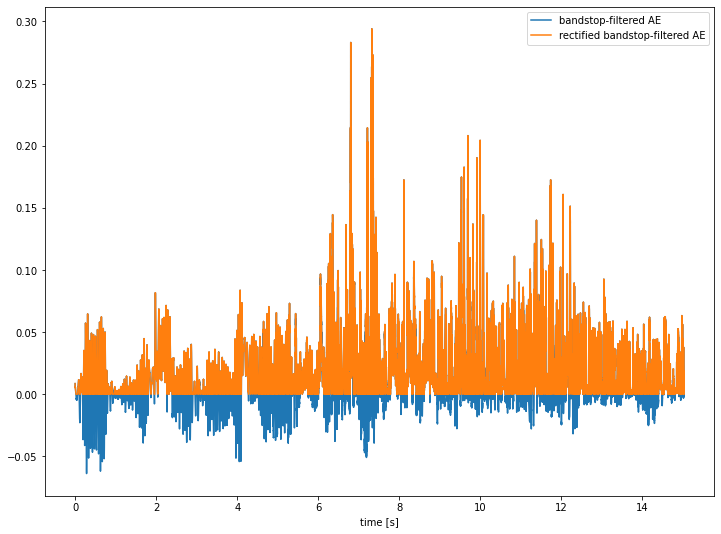

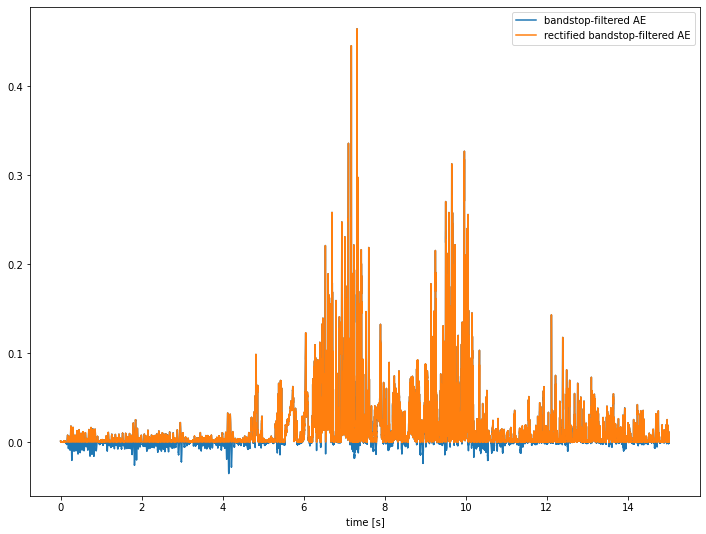

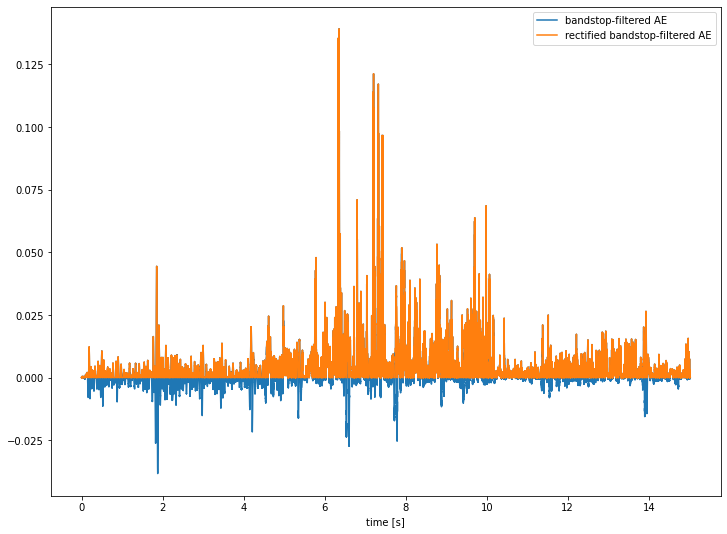

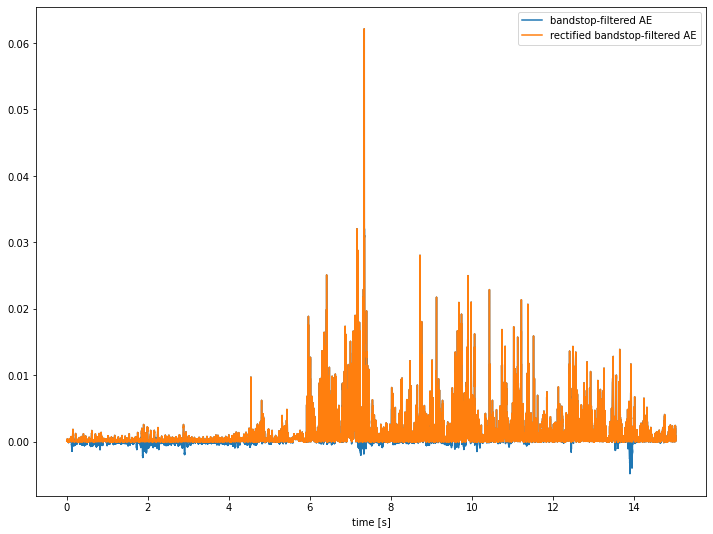

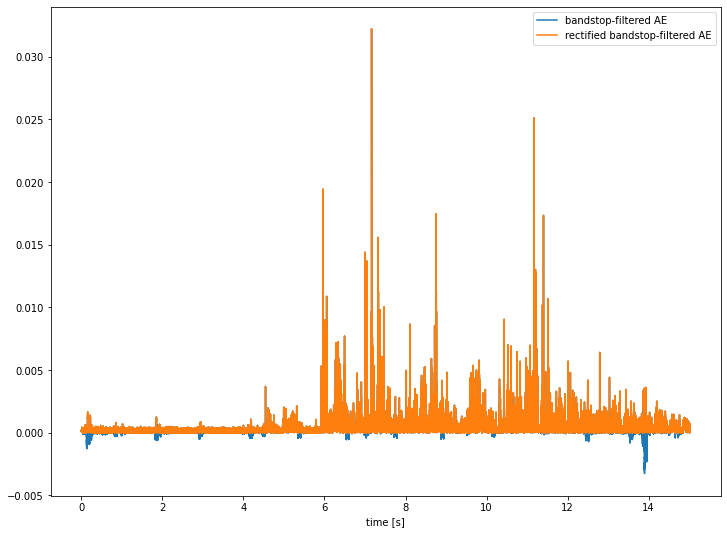

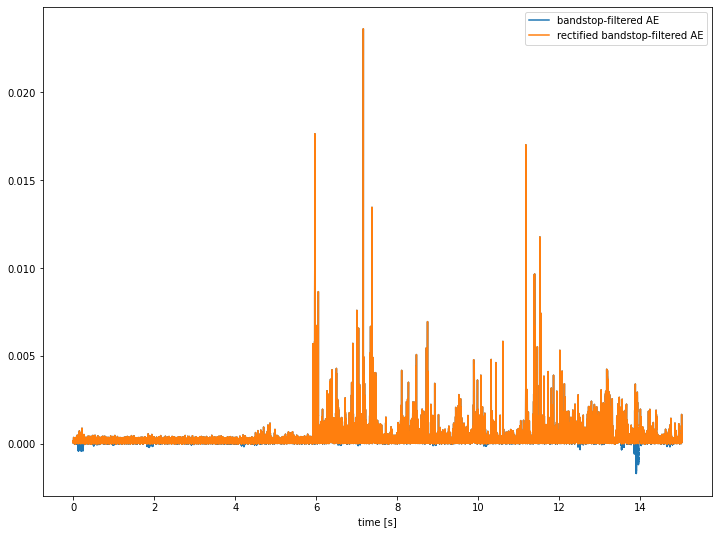

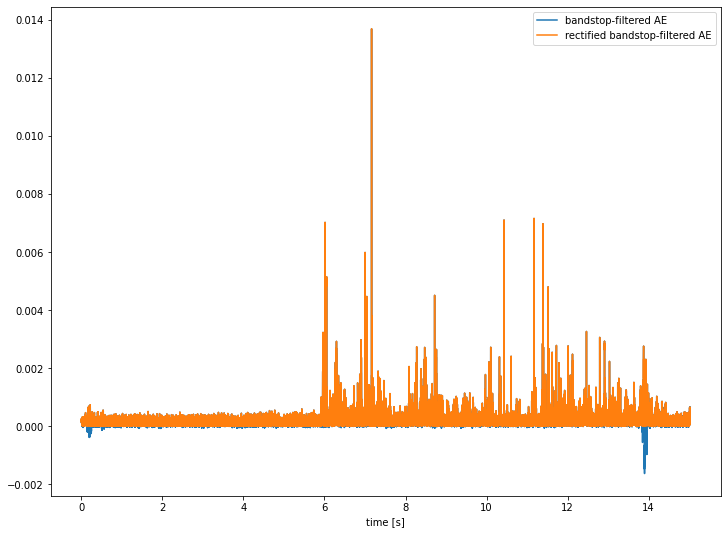

In [35]:
ia_amp_env_rect_SH1 = half_rectify(ia_amp_env_SH1,sr,plots=show_plots)

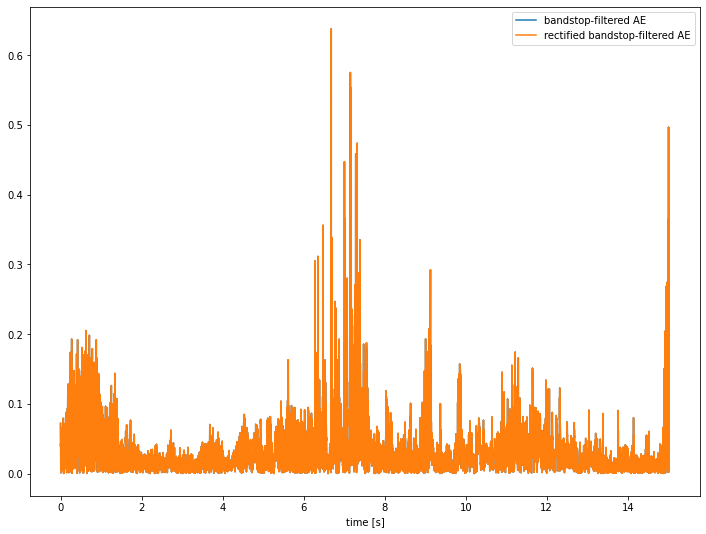

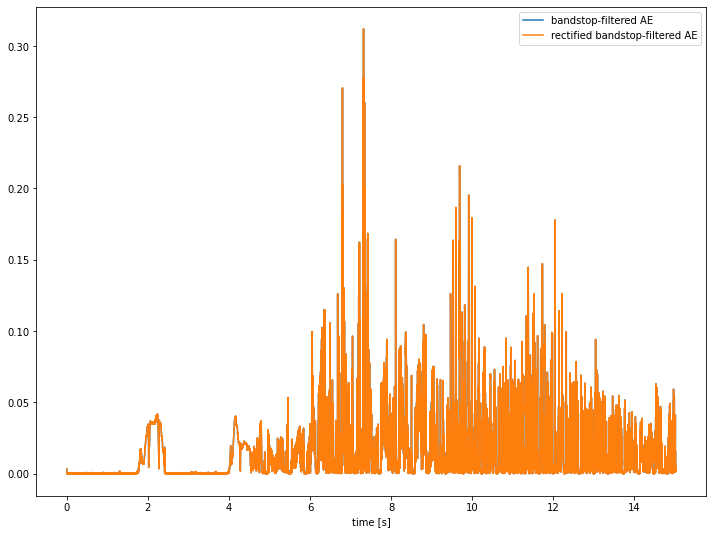

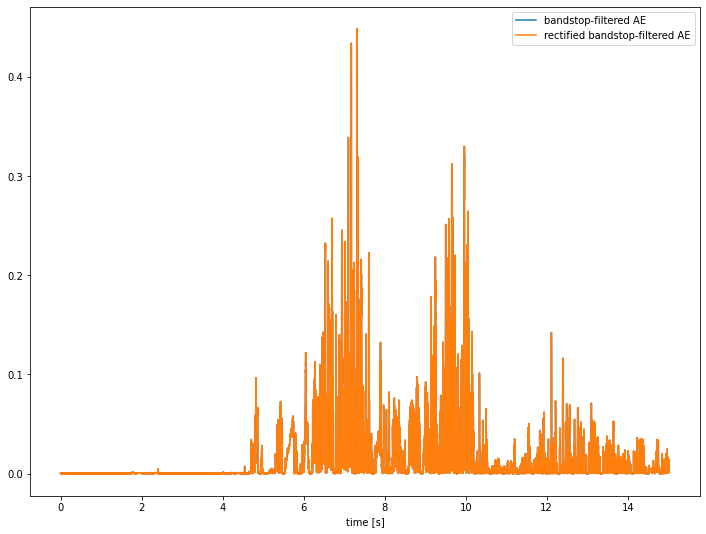

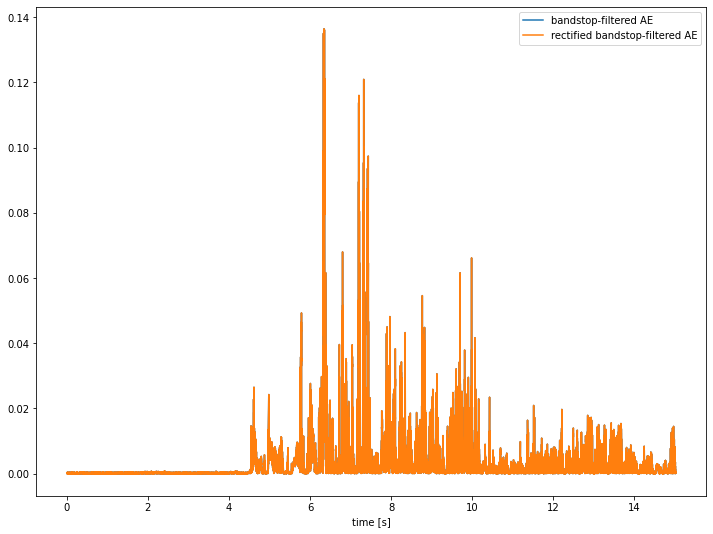

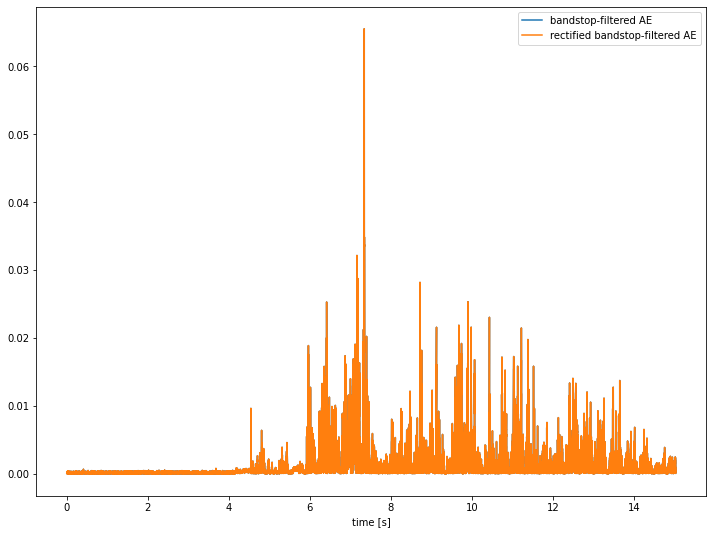

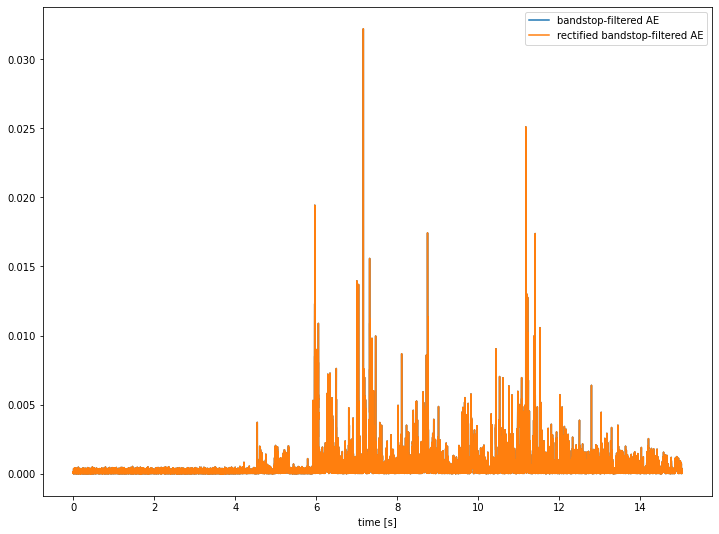

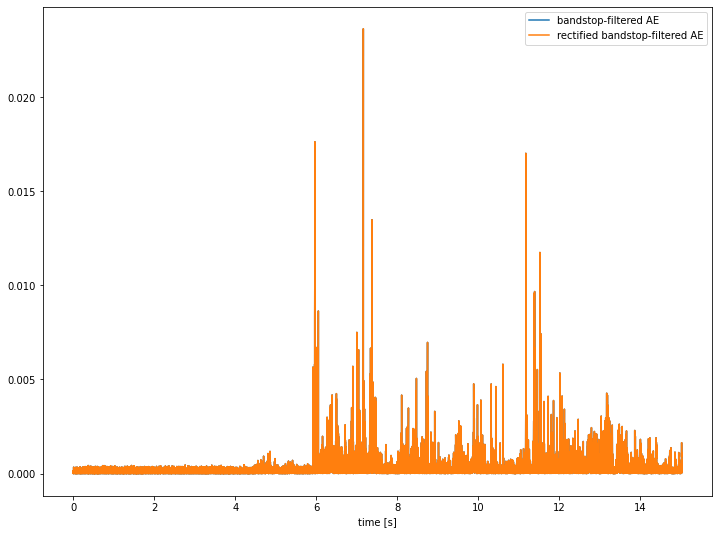

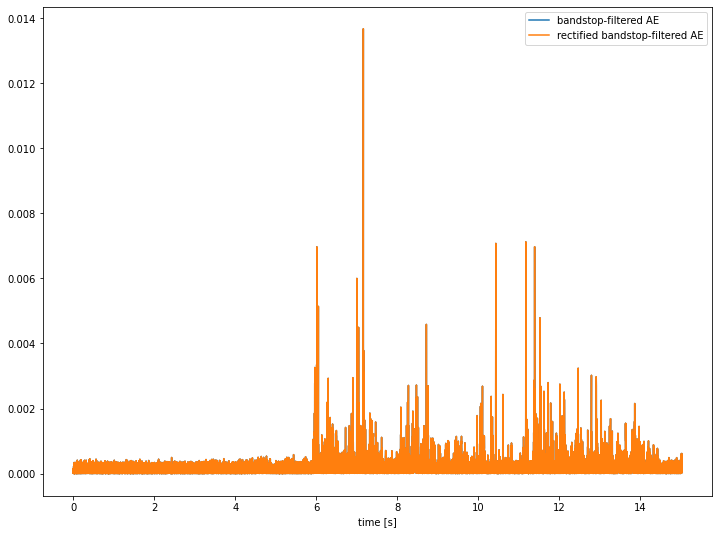

In [36]:
retrieve_amp_env_rect_SH1 = half_rectify(retrieve_amp_env_SH1, sr, plots=show_plots)

## For Parasite

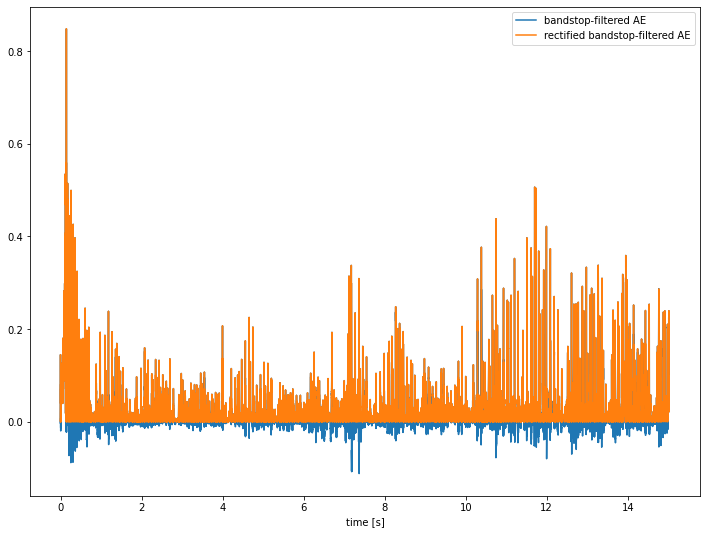

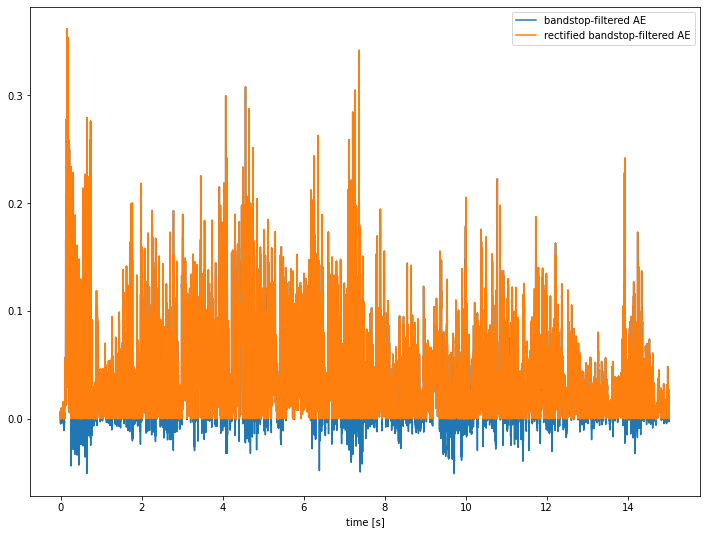

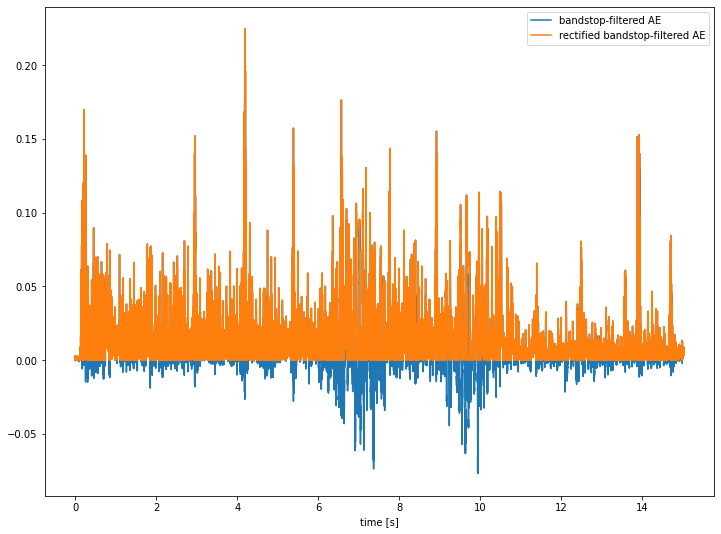

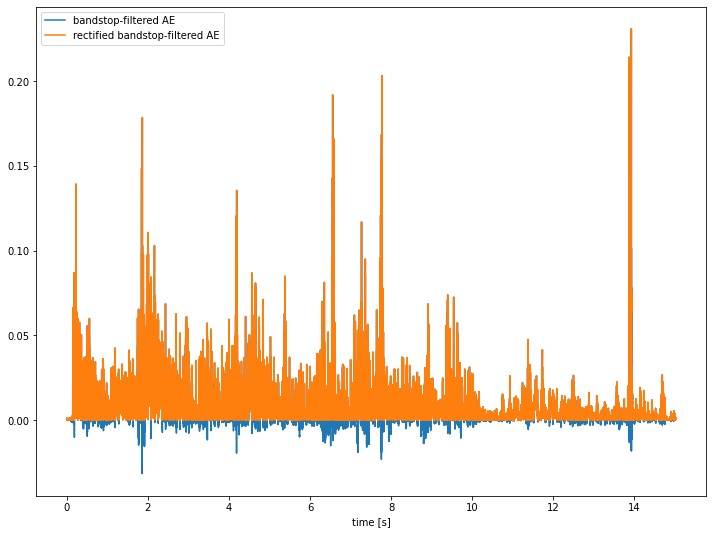

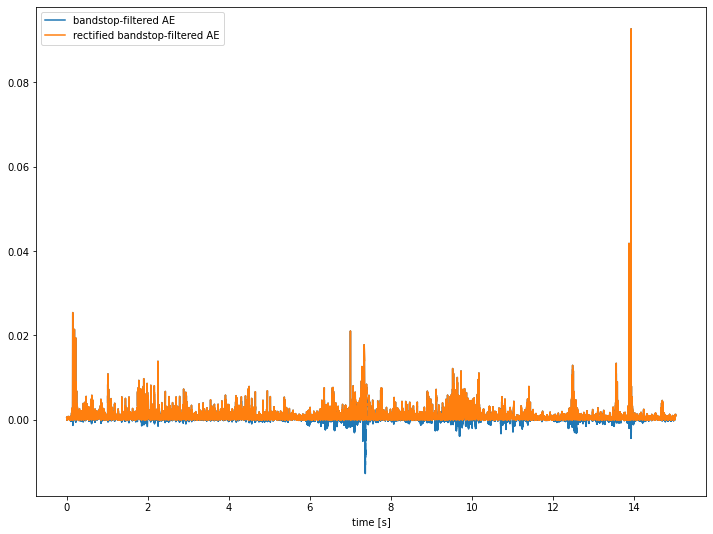

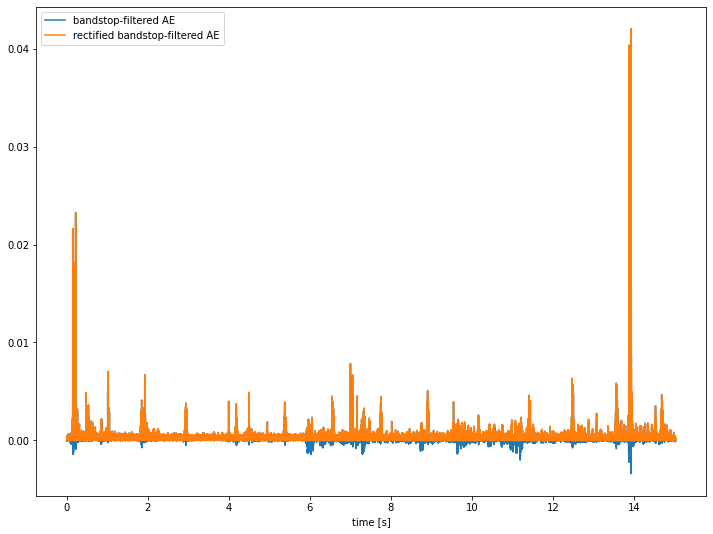

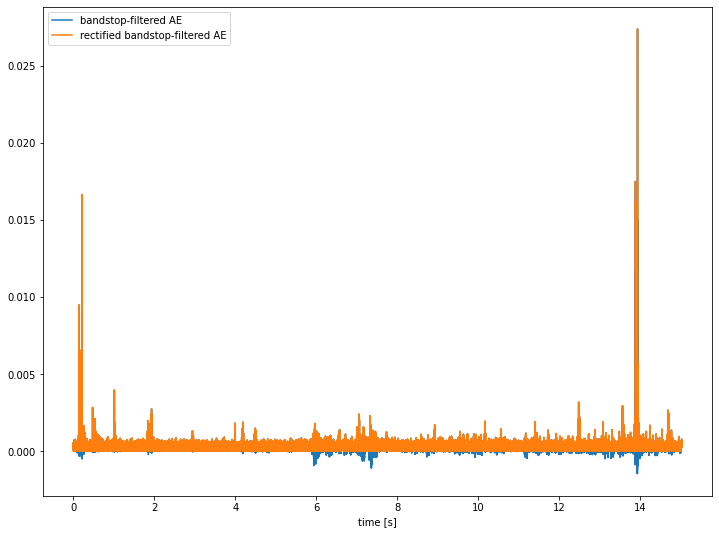

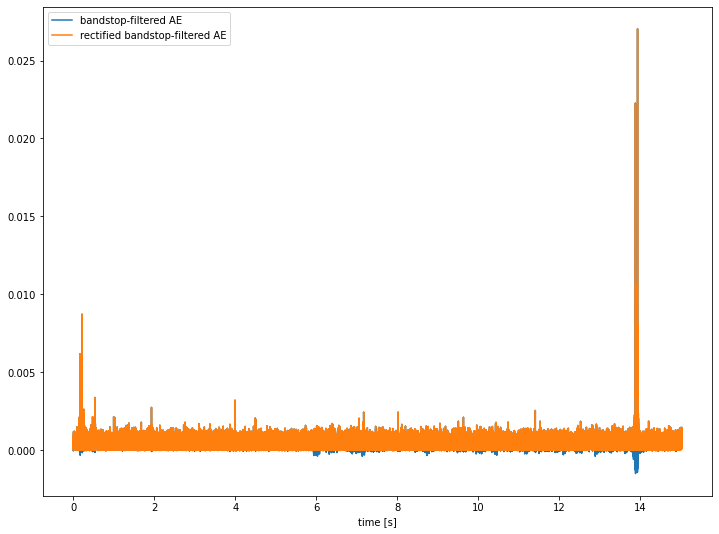

In [37]:
ir_amp_env_rect_P1 = half_rectify(ir_amp_env_P1,sr,plots=show_plots)

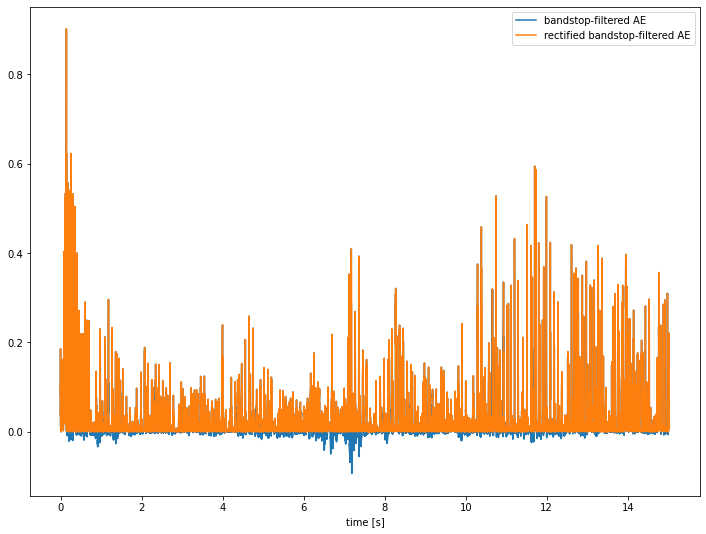

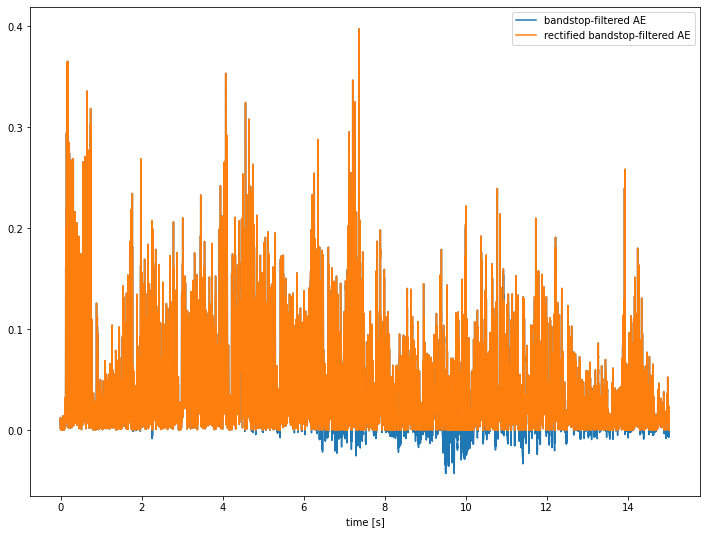

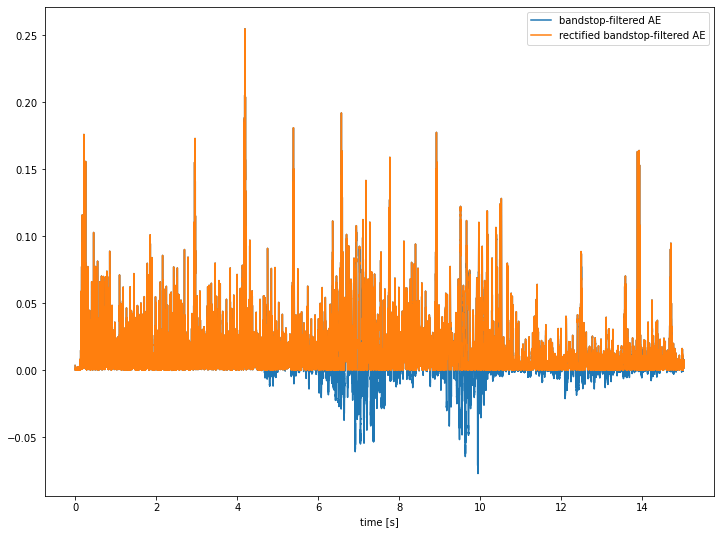

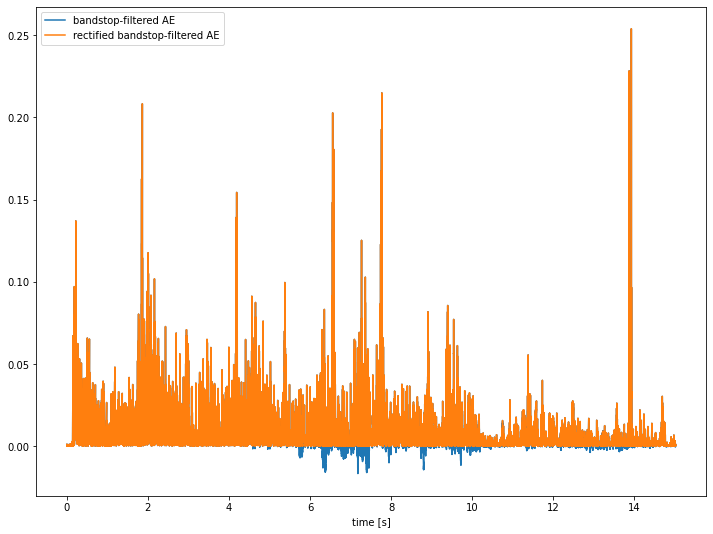

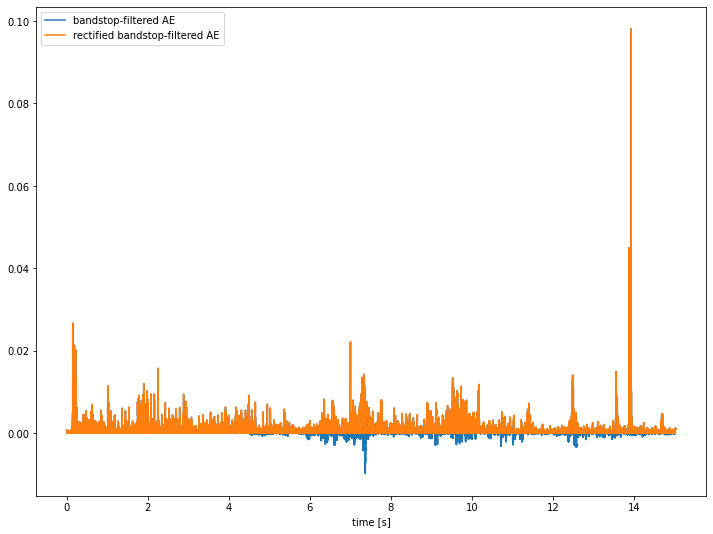

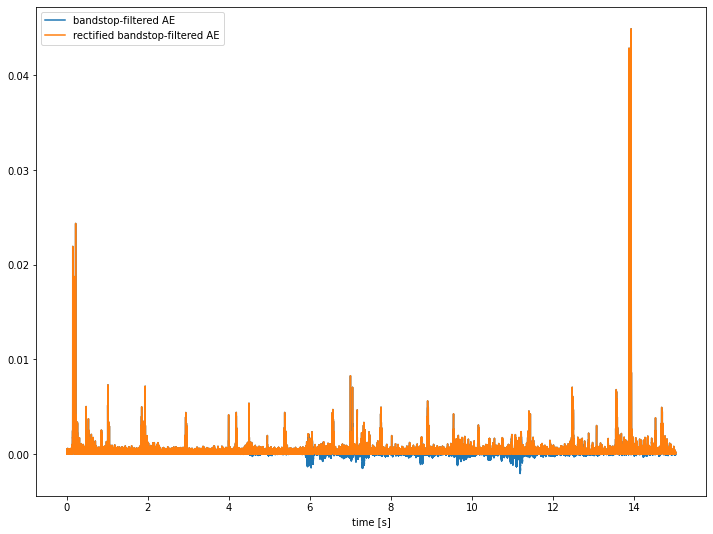

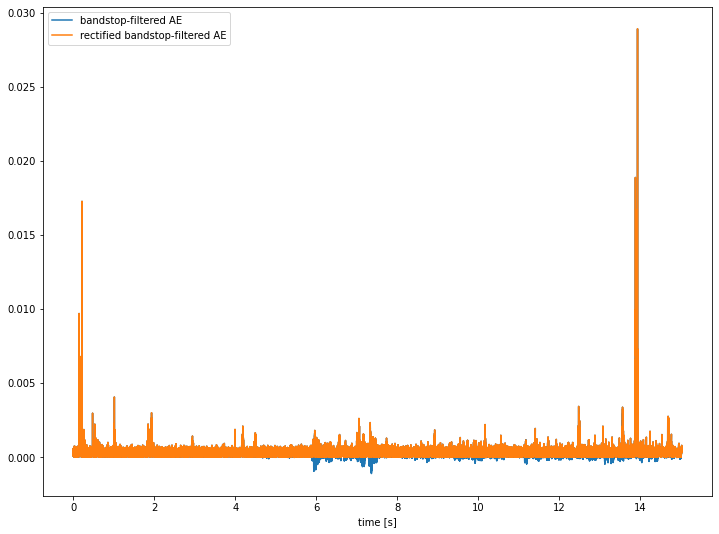

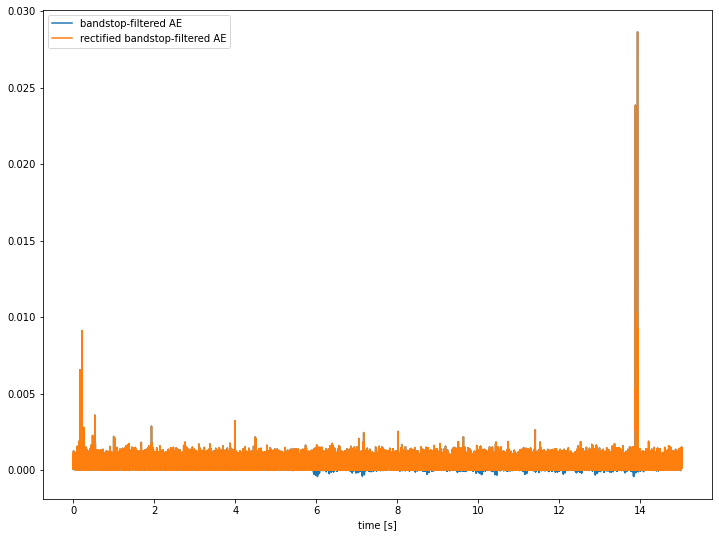

In [38]:
ia_amp_env_rect_P1 = half_rectify(ia_amp_env_P1,sr,plots=show_plots)

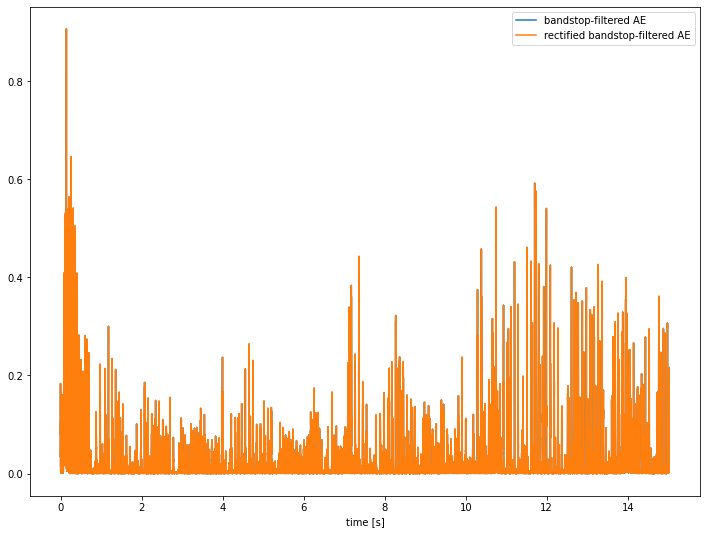

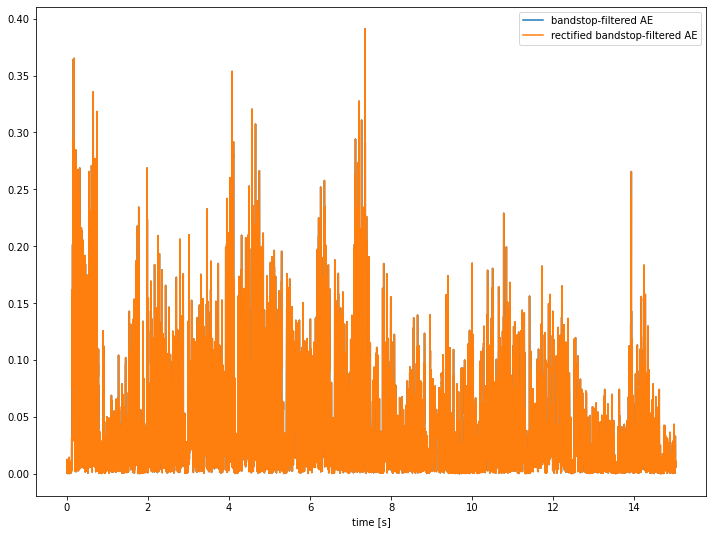

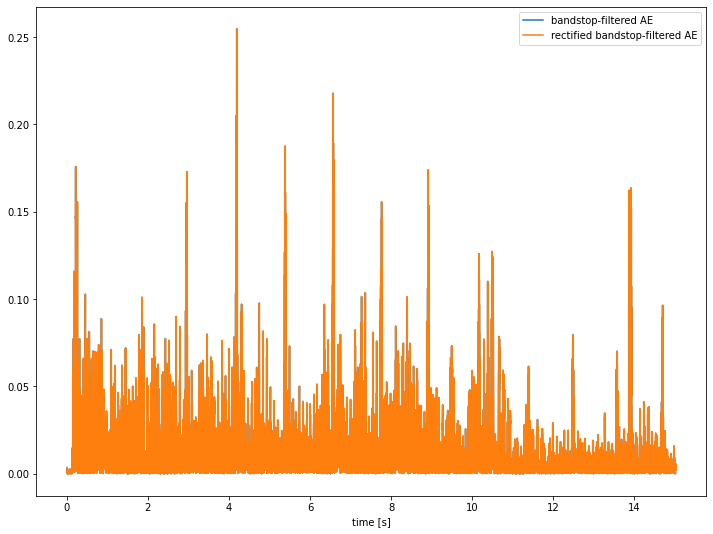

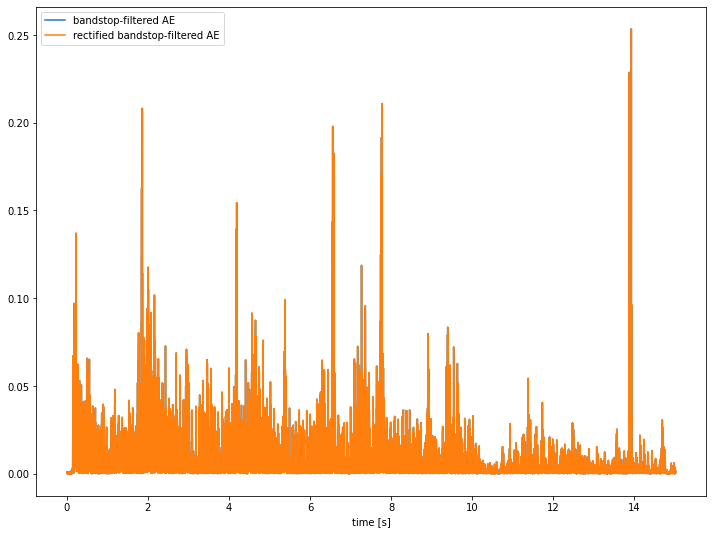

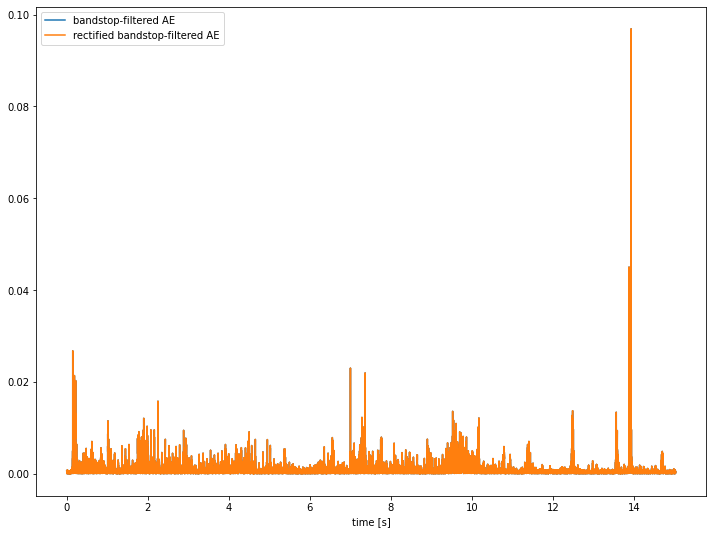

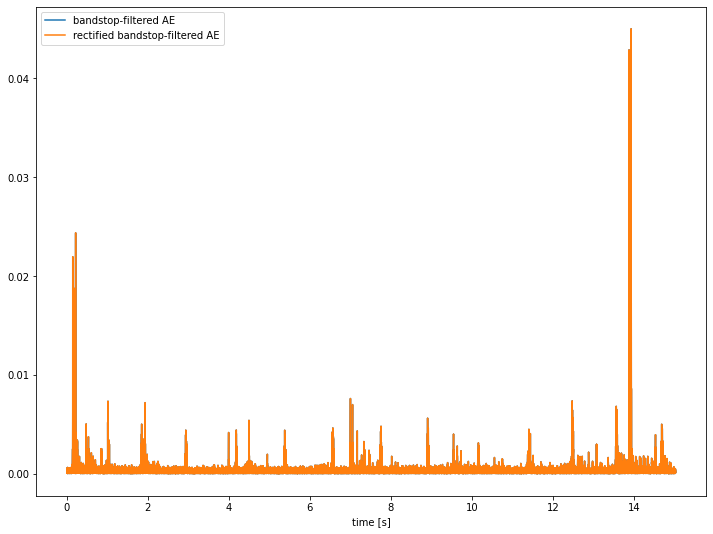

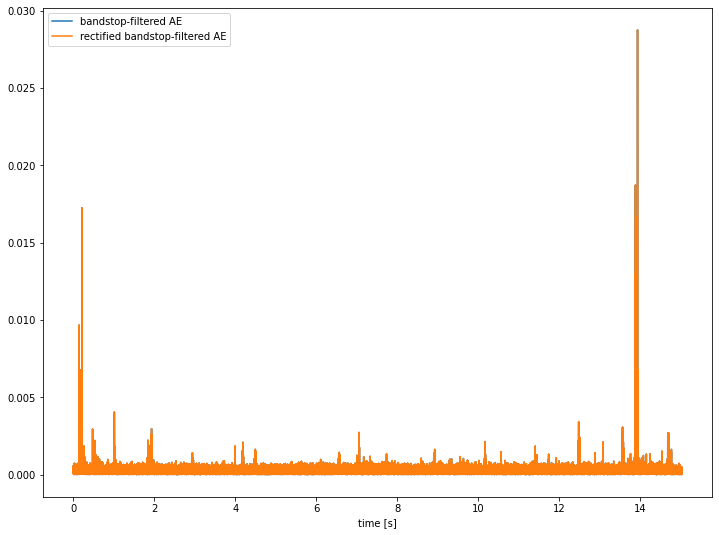

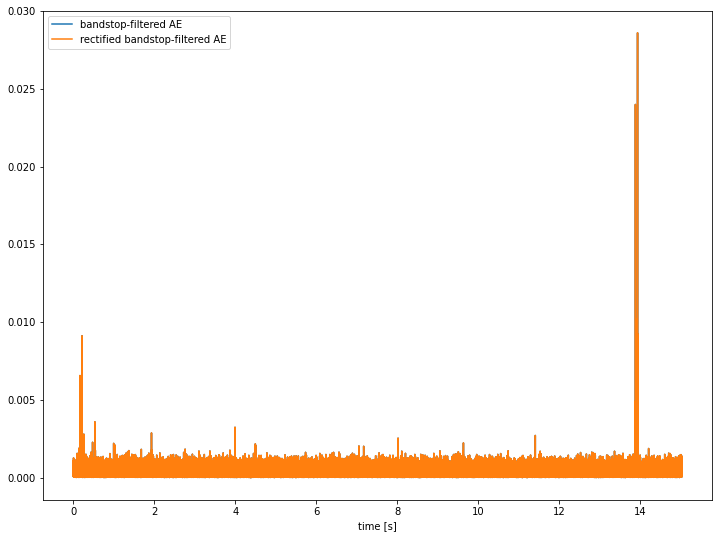

In [39]:
retrieve_amp_env_rect_P1 = half_rectify(retrieve_amp_env_P1, sr, plots=show_plots)

# Build modified signals

## for Single Host

### No implant (just filtered AEs)

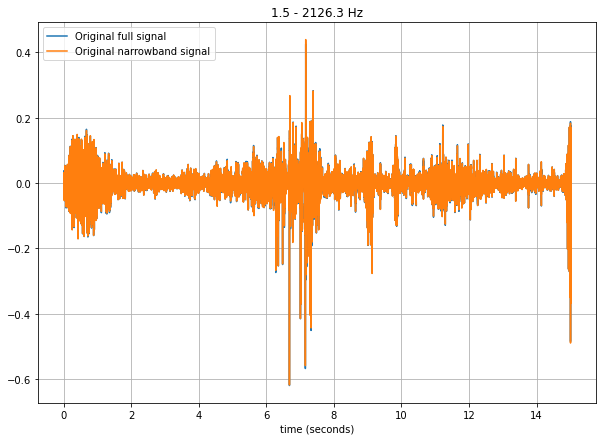

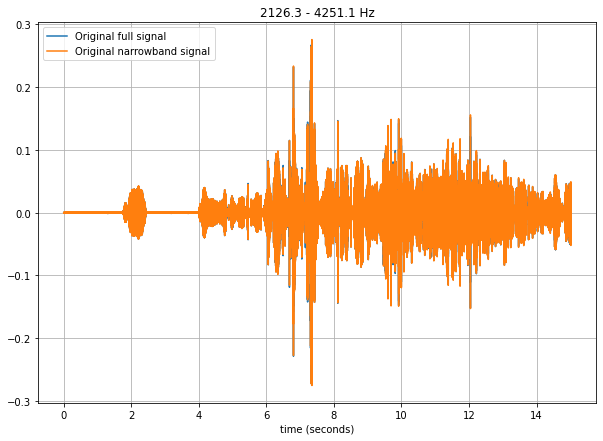

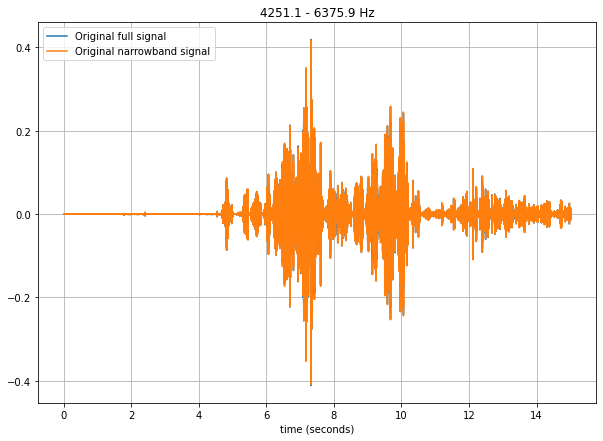

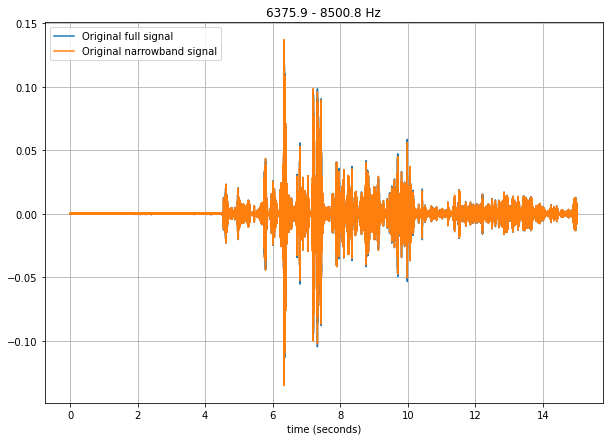

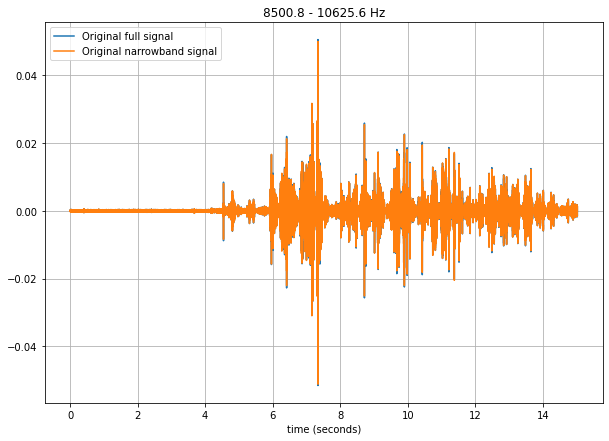

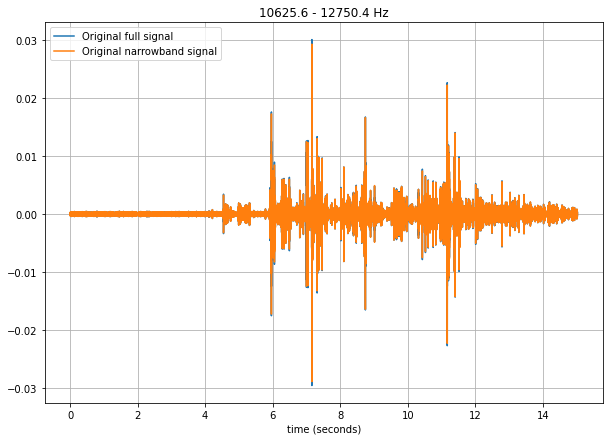

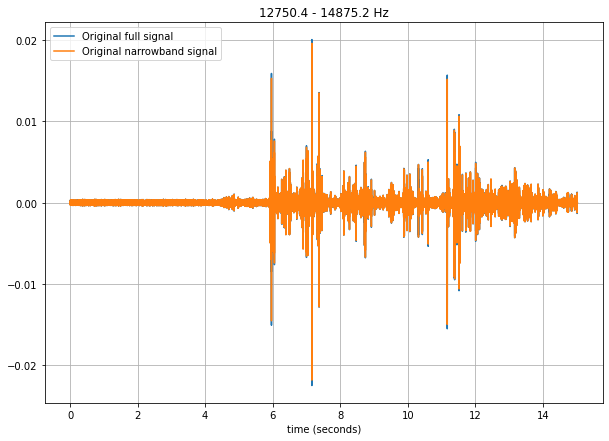

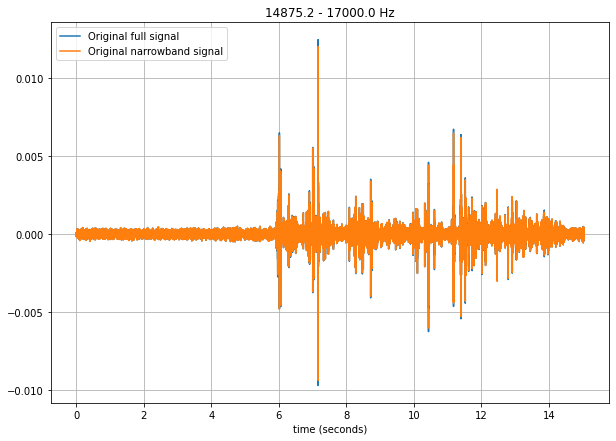

In [61]:
amp_env_filtered_rect_SH1 = half_rectify(amp_env_filtered_SH1, sr, plots=0)


env_filt_SH1 = [i / j for i, j in zip(amp_env_filtered_rect_SH1, amp_env_SH1)] # calculate the ratio

filt_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_filt_SH1)] # multiply original audio with ratio


bp_filt_bp_signalSH1 = []

for i in range(len(filt_bp_signalSH1)):
  ff = [freqs[i],freqs[i+1]]
  y = apply_bank_filters(filt_bp_signalSH1[i], sr, ff, plots=show_plots, bandwidth = 20, ripple_db = 30, audio_player = False)
  bp_filt_bp_signalSH1.append(y[0])

filt_signalSH1=sum(bp_filt_bp_signalSH1)

In [65]:
filt_signalSH1=sum(bp_filt_bp_signalSH1)

ORIGINAL SINGLE HOST AUDIO CLIP


MODIFIED (FILTERED AE) SINGLE HOST AUDIO CLIP


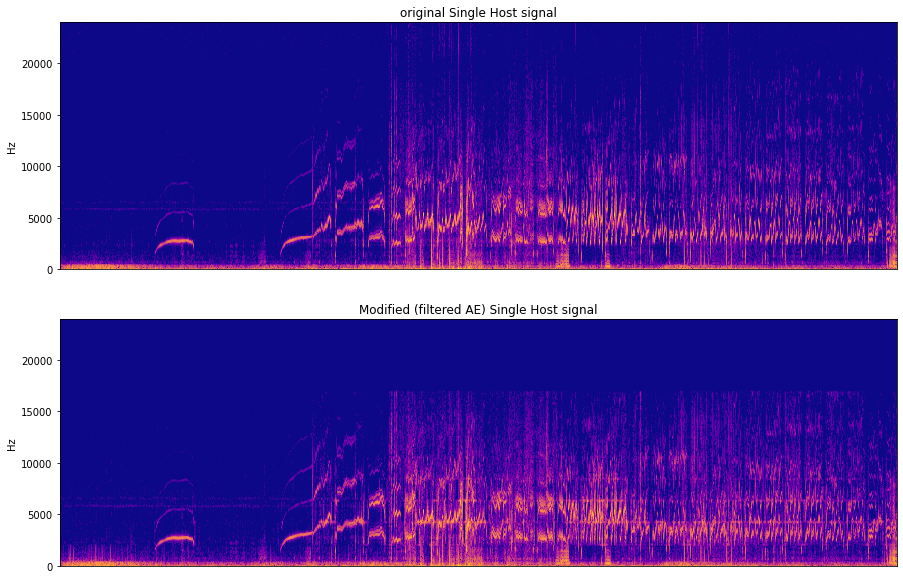

In [66]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal
print('ORIGINAL SINGLE HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=signalSH1,rate=sr))

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Single Host signal')

#modified  signal
print('MODIFIED (FILTERED AE) SINGLE HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=filt_signalSH1,rate=sr))

stft = librosa.stft(filt_signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('Modified (filtered AE) Single Host signal')

plt.show()

### Implant with replacement

In [68]:
env_IR_SH1 = [i / j for i, j in zip(ir_amp_env_rect_SH1, amp_env_SH1)] # calculate the ratio

#env_IR_SH1 = [i / j for i, j in zip(ir_amp_env_SH1, amp_env_SH1)] # calculate the ratio
IR_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_IR_SH1)] # multiply original audio with ratio

IR_signalSH1=sum(IR_bp_signalSH1)


ORIGINAL SINGLE HOST AUDIO CLIP


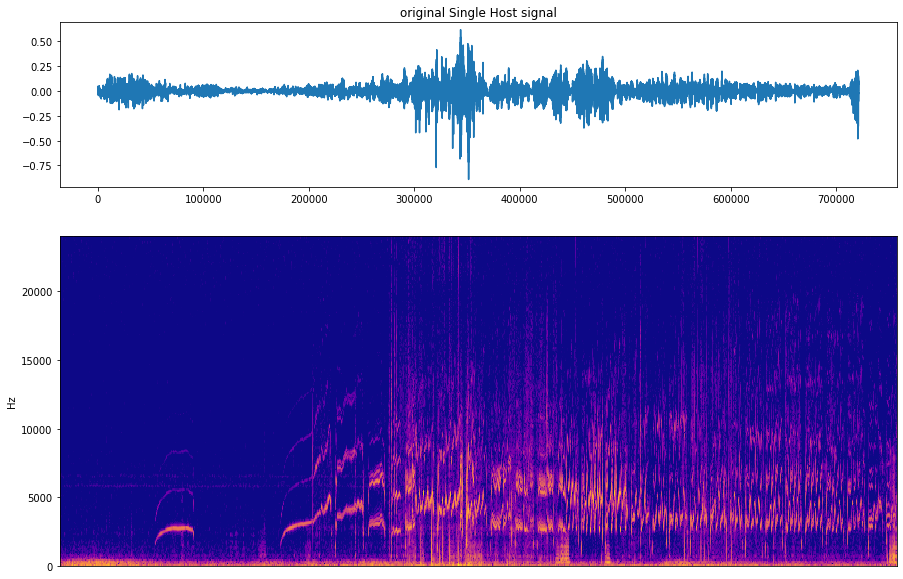



MODIFIED  (IR) HOST AUDIO CLIP


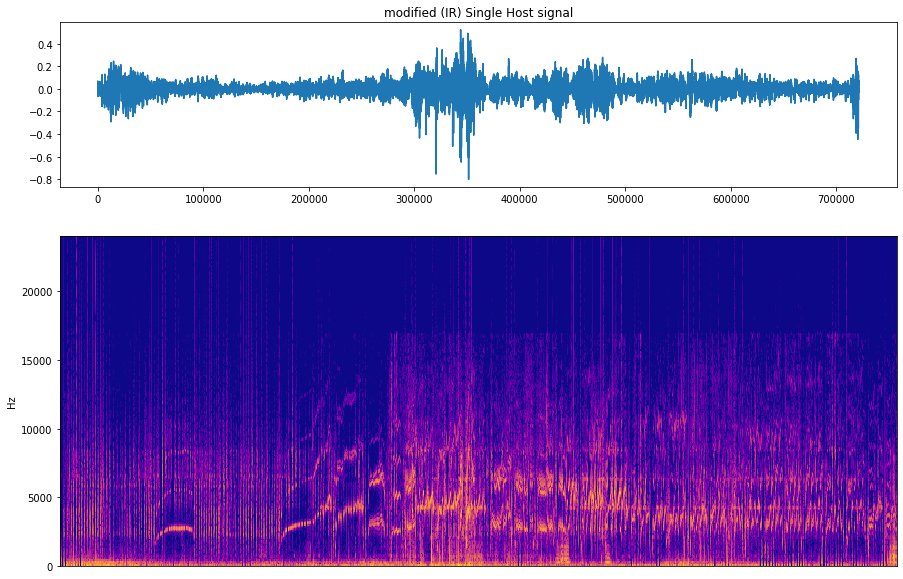

In [69]:

#Original  signal
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 2]},figsize=(15,10))

print('ORIGINAL SINGLE HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=signalSH1,rate=sr))

ax[0].plot(signalSH1)
ax[0].set_title('original Single Host signal')

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
plt.show()

#modified  signal
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 2]},figsize=(15,10))

print('\n')

print('MODIFIED  (IR) HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=IR_signalSH1,rate=sr))

ax[0].plot(IR_signalSH1)
ax[0].set_title('modified (IR) Single Host signal')

stft = librosa.stft(IR_signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
plt.show()

### Implant with addition

In [ ]:
env_IA_SH1 = [i / j for i, j in zip(ia_amp_env_rect_SH1, amp_env_SH1)] # calculate the ratio
#env_IA_SH1 = [i / j for i, j in zip(ia_amp_env_SH1, amp_env_SH1)] # calculate the ratio

IA_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_IA_SH1)] # multiply original audio with ratio

IA_signalSH1=sum(IA_bp_signalSH1)


ORIGINAL SINGLE HOST AUDIO CLIP


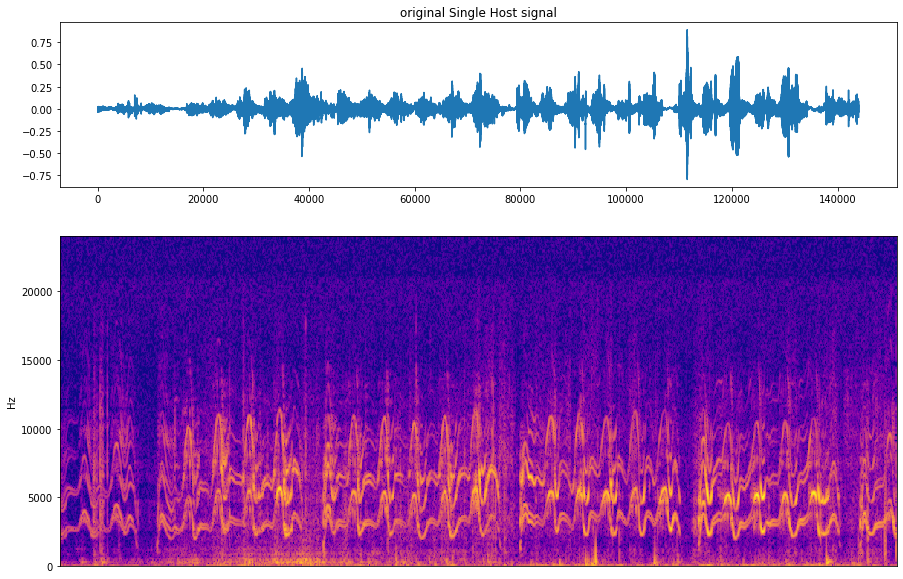





MODIFIED  (IA) HOST AUDIO CLIP


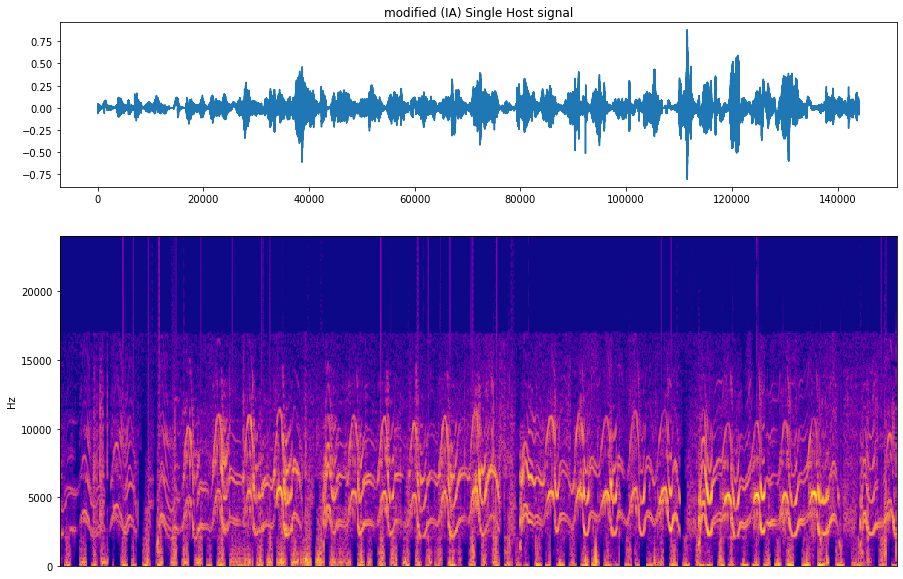

In [ ]:
window_size = 1024
window_shift = 16

#Original  signal
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 2]},figsize=(15,10))

print('ORIGINAL SINGLE HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=signalSH1,rate=sr))
print('\n')

ax[0].plot(signalSH1)
ax[0].set_title('original Single Host signal')

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')

plt.show()

#modified  signal
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 2]},figsize=(15,10))

print('\n')
print('\n')

print('MODIFIED  (IA) HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=IA_signalSH1,rate=sr))
print('\n')

ax[0].plot(IA_signalSH1)
ax[0].set_title('modified (IA) Single Host signal')

stft = librosa.stft(IA_signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')

plt.show()


### Retrieval 

In [56]:
env_retrieve_SH1 = [i / j for i, j in zip(retrieve_amp_env_rect_SH1, amp_env_SH1)] # calculate the ratio

#env_retrieve_SH1 = [i / j for i, j in zip(retrieve_amp_env_SH1, amp_env_SH1)] # calculate the ratio
retrieve_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_retrieve_SH1)] # multiply original audio with ratio

retrieve_signalSH1=sum(retrieve_bp_signalSH1)


ORIGINAL SINGLE HOST AUDIO CLIP




MODIFIED (RETRIEVED) SINGLE HOST AUDIO CLIP


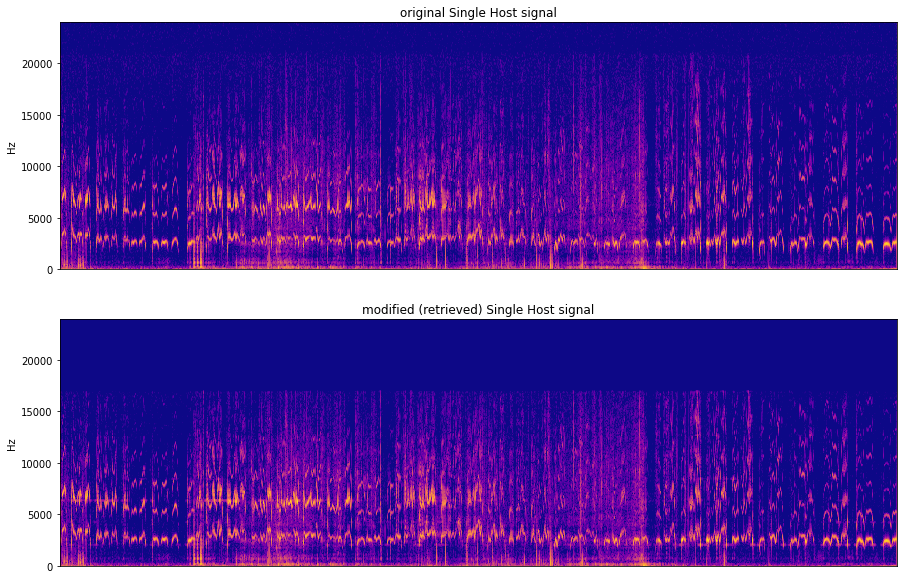

In [52]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal
print('ORIGINAL SINGLE HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=signalSH1,rate=sr))
print('\n')

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Single Host signal')

#modified  signal
print('MODIFIED (RETRIEVED) SINGLE HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=retrieve_signalSH1,rate=sr))
print('\n')

stft = librosa.stft(retrieve_signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (retrieved) Single Host signal')




plt.show()

## For Parasite

### No implant (just filtered AEs)

In [ ]:
amp_env_filtered_rect_P1 = half_rectify(amp_env_filtered_P1, sr, plots=0)

#env_filt_P1 = [i / j for i, j in zip(amp_env_filtered_P1, amp_env_P1)] # calculate the ratio

env_filt_P1 = [i / j for i, j in zip(amp_env_filtered_rect_P1, amp_env_P1)] # calculate the ratio
filt_bp_signalP1 = [ i * j for i,j in zip(bp_signalP1, env_filt_P1)] # multiply original audio with ratio

filt_signalP1=sum(filt_bp_signalP1)

ORIGINAL PARASITE AUDIO CLIP


MODIFIED (FILTERED AE) PARASITE AUDIO CLIP


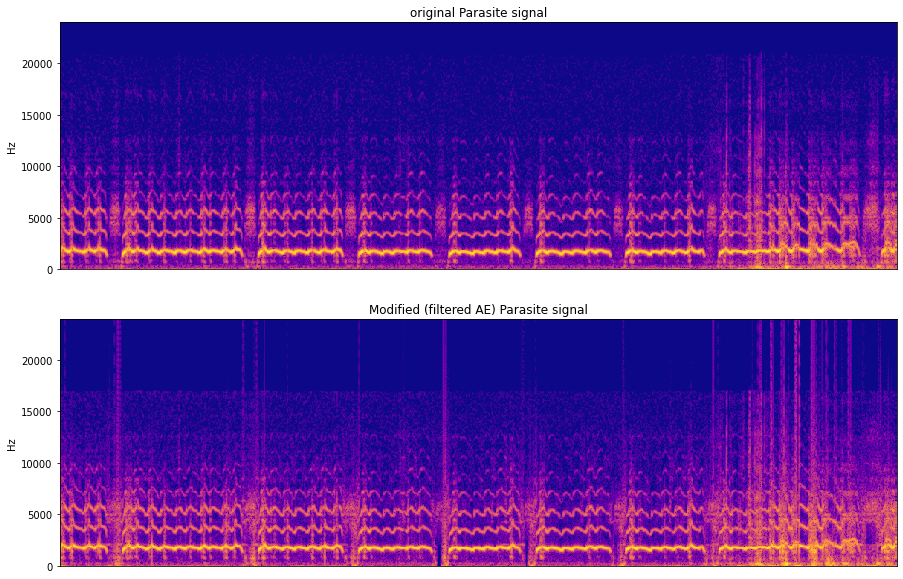

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal
print('ORIGINAL PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=signalP1,rate=sr))

stft = librosa.stft(signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

#modified  signal
print('MODIFIED (FILTERED AE) PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=filt_signalP1,rate=sr))

stft = librosa.stft(filt_signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('Modified (filtered AE) Parasite signal')




plt.show()

### Implant with replacement

In [ ]:
#env_IR_P1 = [i / j for i, j in zip(ir_amp_env_P1, amp_env_P1)] # calculate the ratio

env_IR_P1 = [i / j for i, j in zip(ir_amp_env_rect_P1, amp_env_P1)] # calculate the ratio
IR_bp_signalP1 = [ i * j for i,j in zip(bp_signalP1, env_IR_P1)] # multiply original audio with ratio

IR_signalP1=sum(IR_bp_signalP1)

ORIGINAL PARASITE AUDIO CLIP




MODIFIED (IR) PARASITE AUDIO CLIP


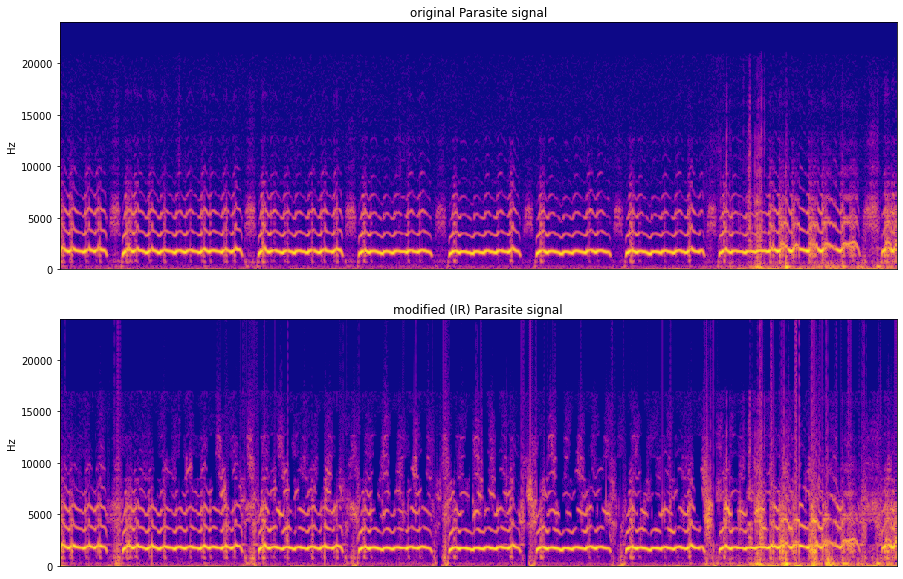

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal
print('ORIGINAL PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=signalP1,rate=sr))
print('\n')

stft = librosa.stft(signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

#modified  signal
print('MODIFIED (IR) PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=IR_signalP1,rate=sr))
print('\n')

stft = librosa.stft(IR_signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (IR) Parasite signal')




plt.show()

### Implant with addition

In [ ]:
env_IA_P1 = [i / j for i, j in zip(ia_amp_env_rect_P1, amp_env_P1)] # calculate the ratio
#env_IA_P1 = [i / j for i, j in zip(ia_amp_env_P1, amp_env_P1)] # calculate the ratio

IA_bp_signalP1 = [ i * j for i,j in zip(bp_signalP1, env_IA_P1)] # multiply original audio with ratio

IA_signalP1=sum(IA_bp_signalP1)


ORIGINAL PARASITE AUDIO CLIP




MODIFIED (IA) PARASITE AUDIO CLIP


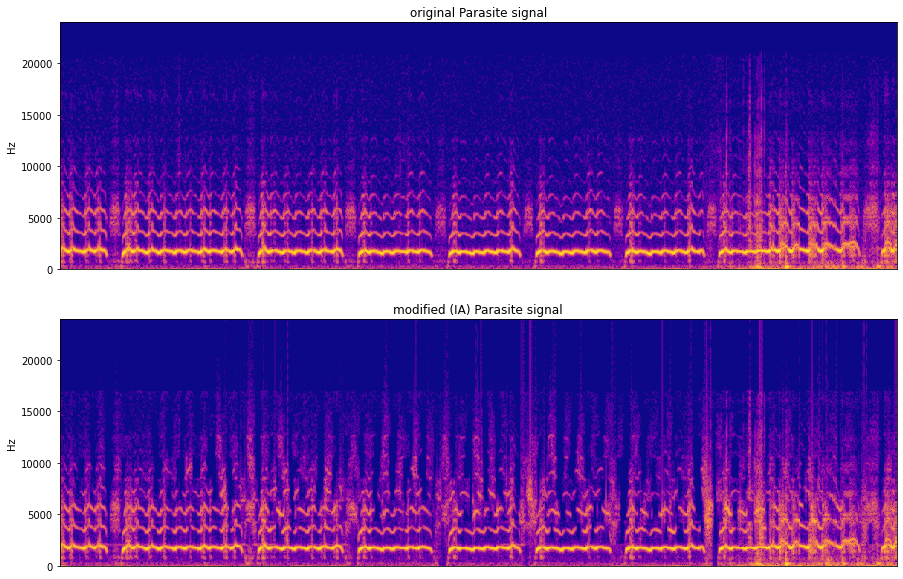

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal
print('ORIGINAL PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=signalP1,rate=sr))
print('\n')

stft = librosa.stft(signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

#modified  signal
print('MODIFIED (IA) PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=IA_signalP1,rate=sr))
print('\n')

stft = librosa.stft(IA_signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (IA) Parasite signal')




plt.show()

### Retrieval 

In [ ]:
env_retrieve_P1 = [i / j for i, j in zip(retrieve_amp_env_rect_P1, amp_env_P1)] # calculate the ratio

retrieve_bp_signalP1 = [ i * j for i,j in zip(bp_signalP1, env_retrieve_P1)] # multiply original audio with ratio

retrieve_signalP1=sum(retrieve_bp_signalP1)


ORIGINAL PARASITE AUDIO CLIP




MODIFIED  (RETRIEVED) PARASITE AUDIO CLIP


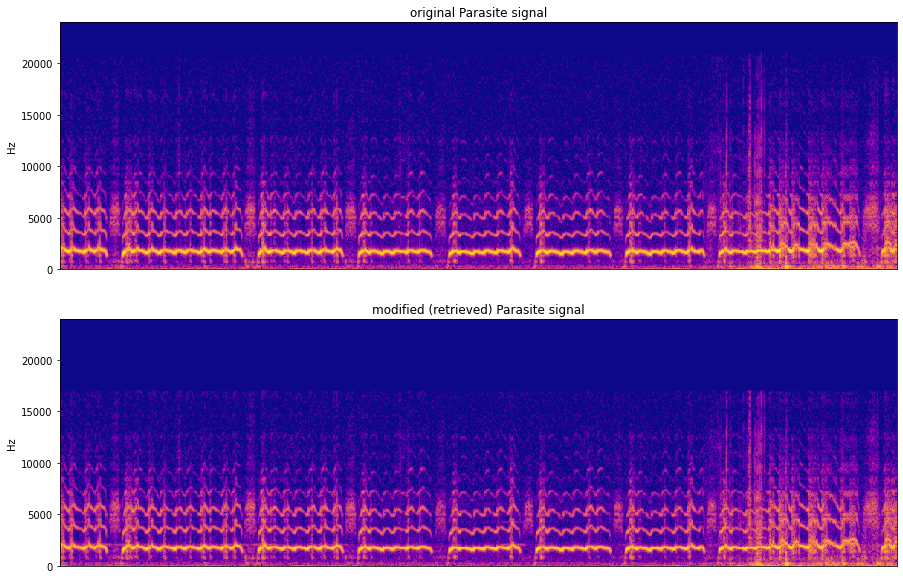

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal
print('ORIGINAL PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=signalP1,rate=sr))
print('\n')

stft = librosa.stft(signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

#modified  signal
print('MODIFIED  (RETRIEVED) PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=retrieve_signalP1,rate=sr))
print('\n')

stft = librosa.stft(retrieve_signalP1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (retrieved) Parasite signal')




plt.show()

## Save audio

In [ ]:
# Give a name for the file to be saved
PinSH_IR = name_P + '_in_' + name_SH + '_implant_with_replacement.wav'
SHinP_IR = name_SH + '_in_' + name_P + '_implant_with_replacement.wav'

PinSH_IA = name_P + '_in_' + name_SH + '_implant_with_addition.wav'
SHinP_IA = name_SH + '_in_' + name_P + '_implant_with_addition.wav'

P_recover = name_P + '_remove_recover.wav'
SH_recover = name_SH + '_remove_recover.wav'

P_filtered = name_P + '_filtered_AE.wav'
SH_filtered = name_SH + '_filtered_AE.wav'

# write file (if in colab, remember to download it before leaving the session)
sf.write(PinSH_IR, IR_signalSH1, sr)

sf.write(SHinP_IR, IR_signalP1, sr)

sf.write(PinSH_IA, IA_signalSH1, sr)

sf.write(SHinP_IA, IA_signalP1, sr)

sf.write(P_recover, retrieve_signalP1, sr)

sf.write(SH_recover, retrieve_signalSH1, sr)

sf.write(P_filtered, filt_signalP1, sr)

sf.write(SH_filtered, filt_signalSH1, sr)

# Sandbox

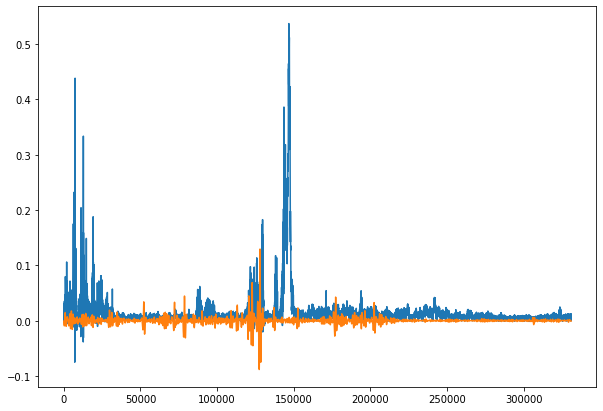

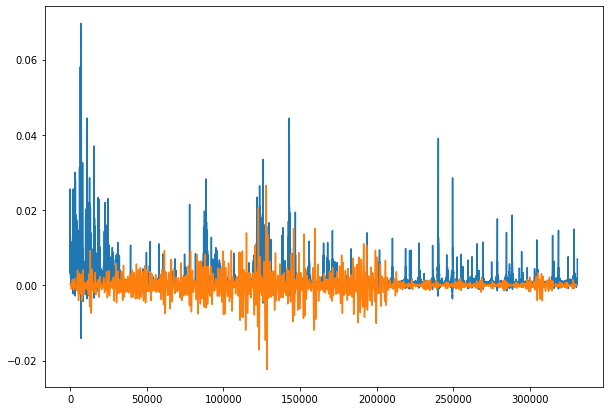

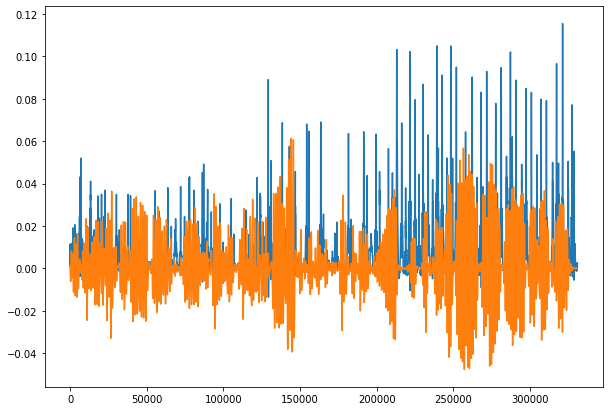

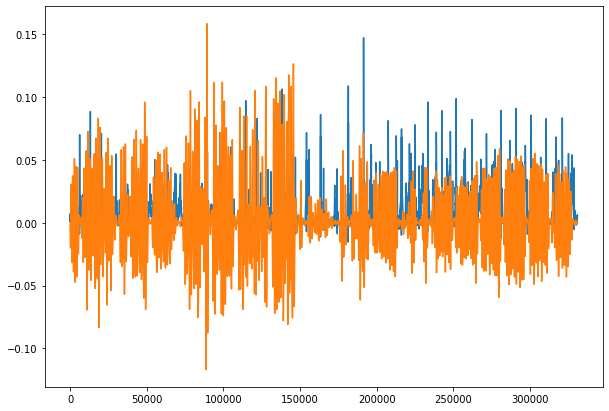

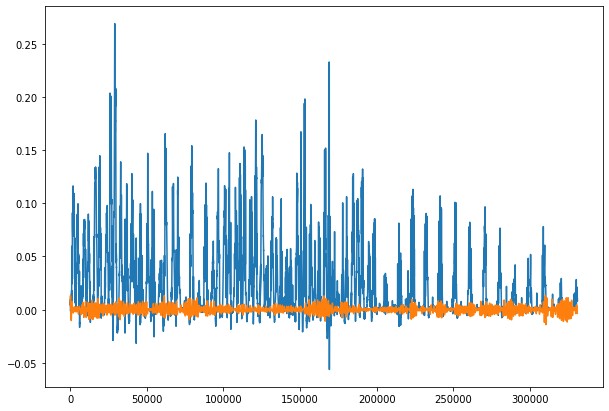

...

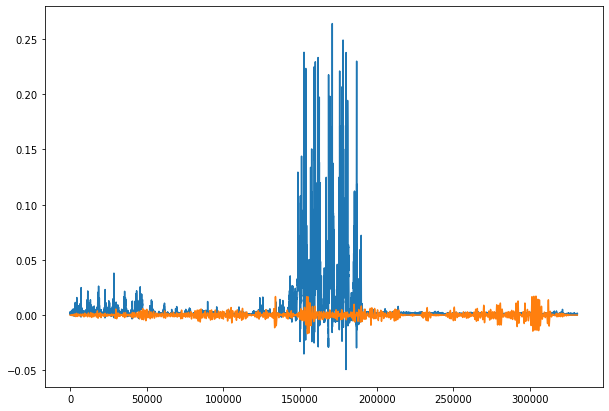

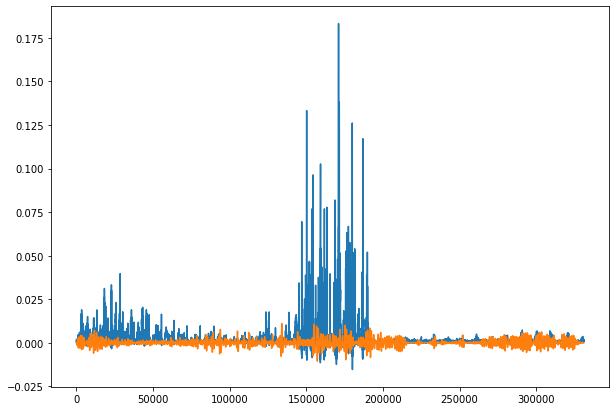

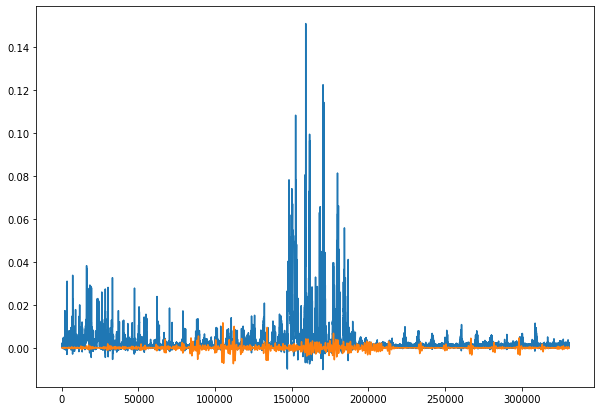

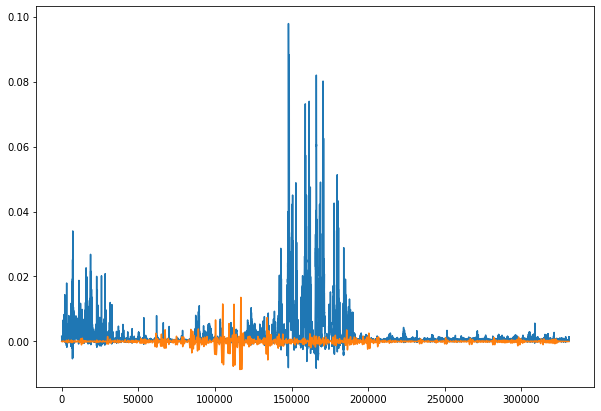

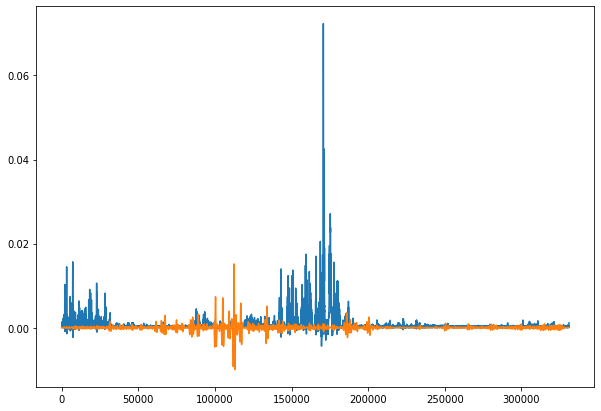

In [ ]:
for i in range(len(amp_env_filtered_SH1)):
  plt.figure(figsize=(10,7))
  plt.plot(amp_env_filtered_SH1[i])
  plt.plot(sig_removed_P1[i])

  plt.show()

In [ ]:
amp_env_filtered_rect_SH1 = half_rectify(amp_env_filtered_SH1,sr,plots=0)

sig_removed_rect_P1 = half_rectify(sig_removed_P1,sr,plots=0)

envR_filt_SH1 = [i / j for i, j in zip(amp_env_filtered_rect_SH1, amp_env_SH1)] # calculate the ratio
envR_removed_P1 = [i / j for i, j in zip(sig_removed_rect_P1, amp_env_P1)] # calculate the ratio
IR_envR = [i+j for i,j in zip(envR_filt_SH1 , envR_removed_P1)]

IR_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, IR_envR)]

#filt_bp_signalSH1 = [ i * j for i,j in zip(bp_signalSH1, env_filt_SH1)] # multiply original audio with ratio

In [ ]:
IRSH1 = sum(IR_bp_signalSH1)

ORIGINAL SINGLE HOST AUDIO CLIP


MODIFIED  (IR) HOST AUDIO CLIP


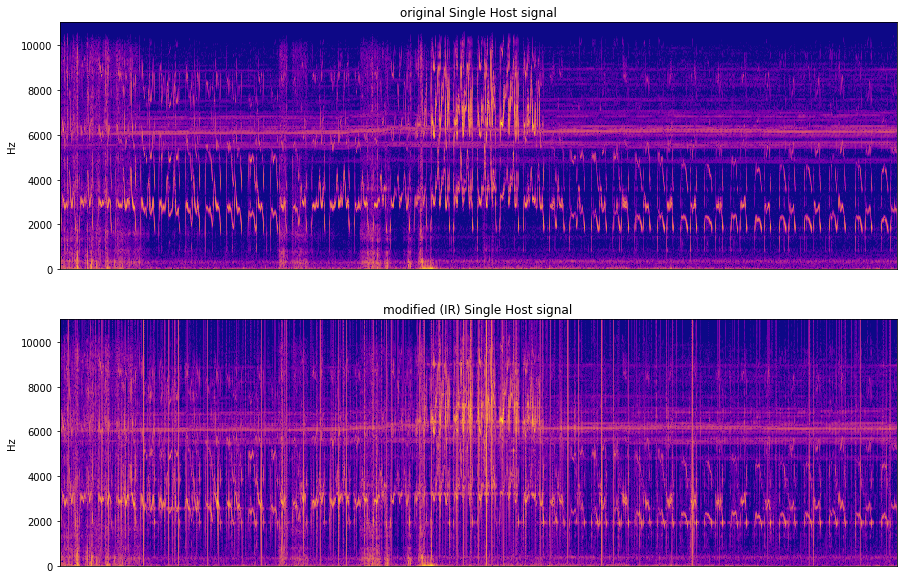

In [ ]:
window_size = 1024
window_shift = 16
fig, ax = plt.subplots(nrows=2, sharex=False,gridspec_kw={'height_ratios': [1, 1]},figsize=(15,10))

#Original  signal

print('ORIGINAL SINGLE HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=signalSH1,rate=sr))

stft = librosa.stft(signalSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Single Host signal')

#modified  signal

print('MODIFIED  (IR) HOST AUDIO CLIP')
ipd.display(ipd.Audio(data=IRSH1,rate=sr))

stft = librosa.stft(IRSH1,n_fft=512,hop_length=128)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[1], cmap='plasma')
ax[1].set_title('modified (IR) Single Host signal')




plt.show()

## Sound of filtered out signal

In [ ]:
sig_removed_rect_P1 = half_rectify(sig_removed_P1,sr, plots=0)

In [ ]:
envR = [i/j for i,j in zip(sig_removed_rect_P1,amp_env_P1)]

In [ ]:
#removed_bp_P1 = [i*j for i,j in zip(envR,bp_signalP1)]

removed_bp_P1 = [i*np.cos(j) for i,j in zip(sig_removed_rect_P1,inst_phase_P1)]

In [ ]:
removed_P1 = sum(removed_bp_P1)

ORIGINAL  PARASITE AUDIO CLIP


REMOVED PARASITE AUDIO CLIP


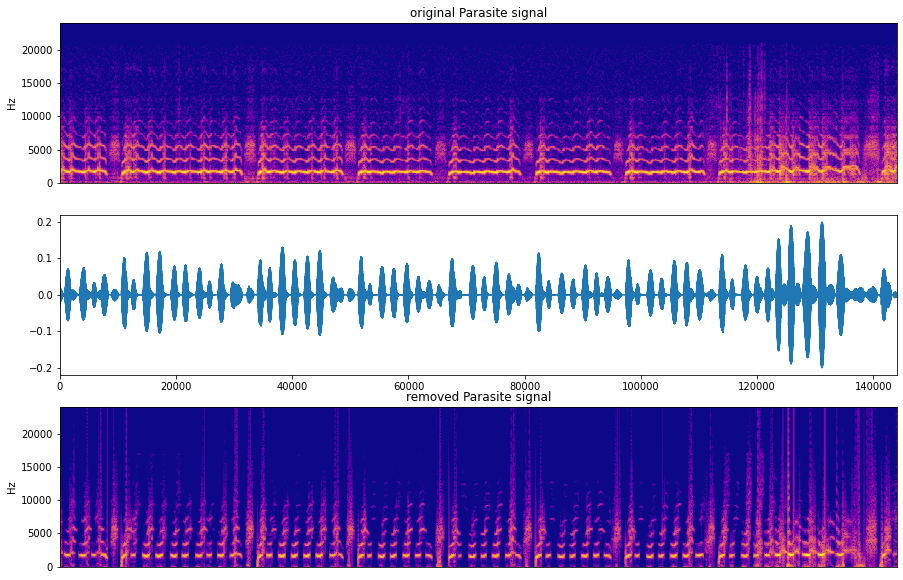

In [ ]:

fig, ax = plt.subplots(nrows=3, sharex=False,gridspec_kw={'height_ratios': [1,1, 1]},figsize=(15,10))



#Original  signal

print('ORIGINAL  PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=signalP1,rate=sr))

stft = librosa.stft(signalP1,n_fft=512,hop_length=16)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[0], cmap='plasma')
ax[0].set_title('original Parasite signal')

# modified signal
print('REMOVED PARASITE AUDIO CLIP')
ipd.display(ipd.Audio(data=removed_P1,rate=sr))

ax[1].plot(removed_P1)
ax[1].set_xlim([0,144000])


stft = librosa.stft(removed_P1,n_fft=512,hop_length=16)
spec_power = np.abs(stft)**2
p_to_db = librosa.power_to_db(spec_power)

librosa.display.specshow(p_to_db, sr=sr,y_axis='linear',ax = ax[2], cmap='plasma')
ax[2].set_title('removed Parasite signal')


plt.show()

## Investigate  Brood Host

In [ ]:
audiofile_BH1 = '/content/15s_recordings/host1_brood/' + random.choice(os.listdir('/content/15s_recordings/host1_brood')) 
name_BH = os.path.basename(audiofile_BH1).split('.')[0]
print('Brood Host file chosen:',name_BH)

Brood Host file chosen: LT38 four barbets 15112010_15s


total audio duration of file /content/15s_recordings/host1_brood/LT38 four barbets 15112010_15s.wav is : 15.03s




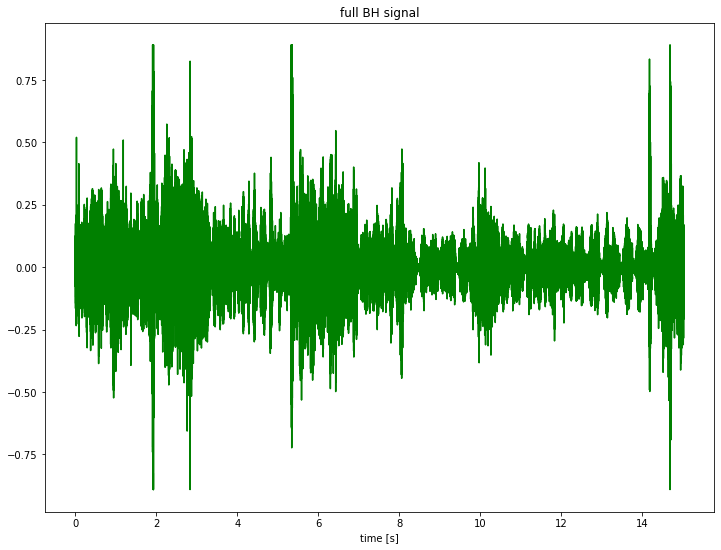

BROOD HOST FULL DURATION AUDIO


In [ ]:
signal_full_BH1, sr = librosa.load(audiofile_BH1,sr=None)
print(f'total audio duration of file {audiofile_BH1} is : {len(signal_full_BH1)/sr:.2f}s')
print('\n')

if show_plots:

  t = np.linspace(0,len(signal_full_BH1)/sr, len(signal_full_BH1))
  plt.figure(figsize=(12,9))  
  plt.plot(t, signal_full_BH1,c='g')
  plt.xlabel('time [s]')
  plt.title('full BH signal')
  plt.show()
  print('BROOD HOST FULL DURATION AUDIO')
  ipd.display(ipd.Audio(data=signal_full_BH1,rate=sr))

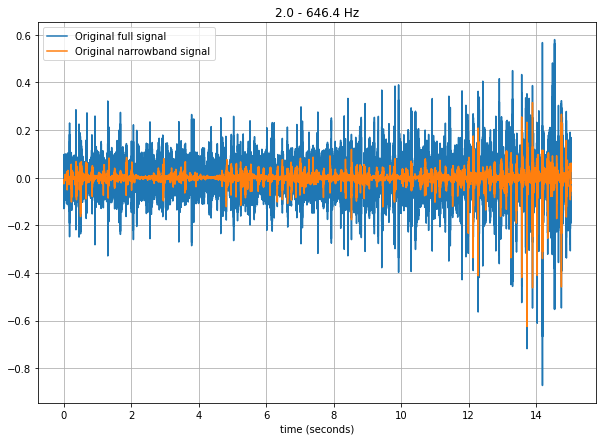

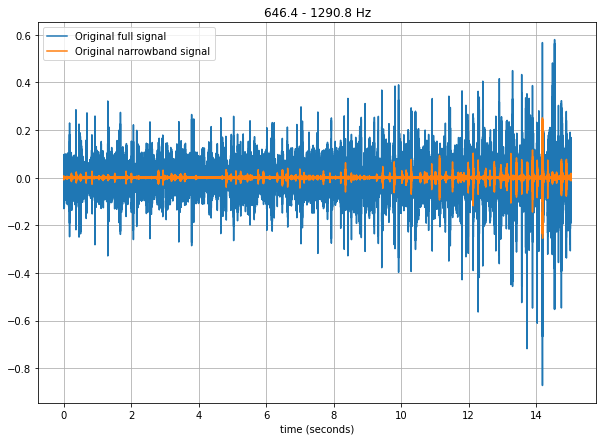

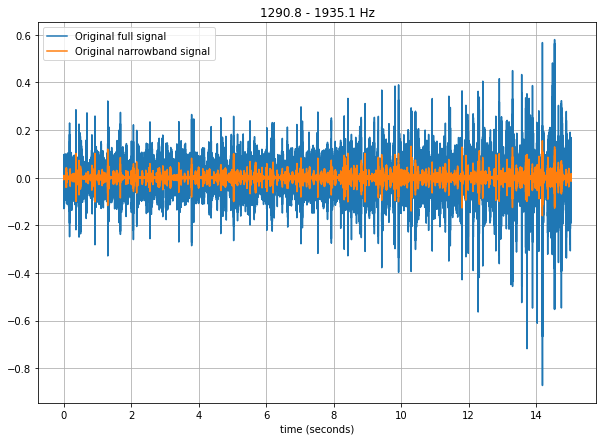

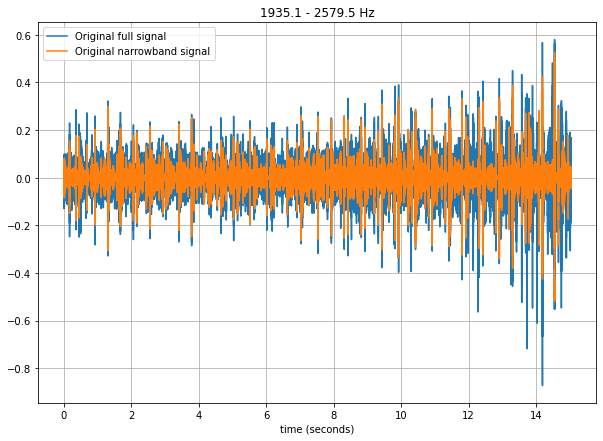

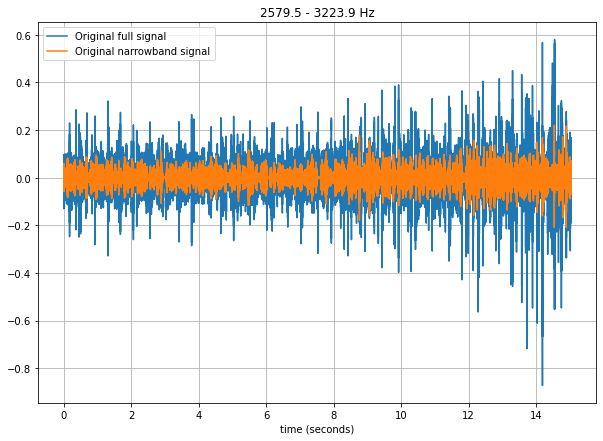

...

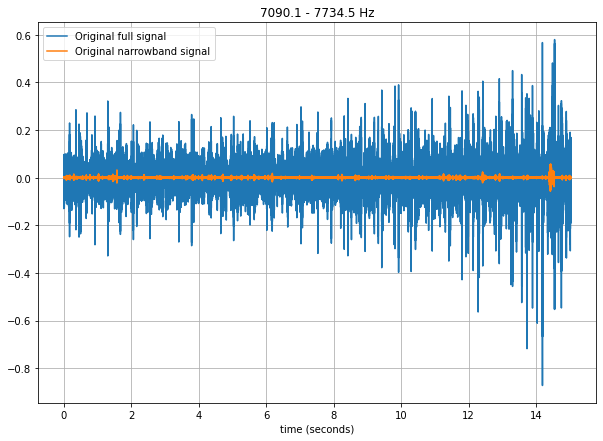

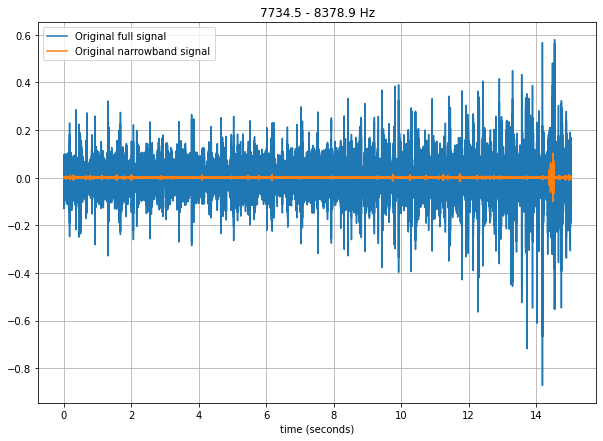

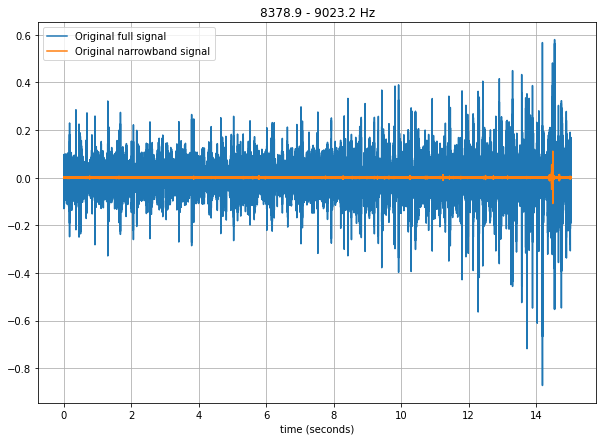

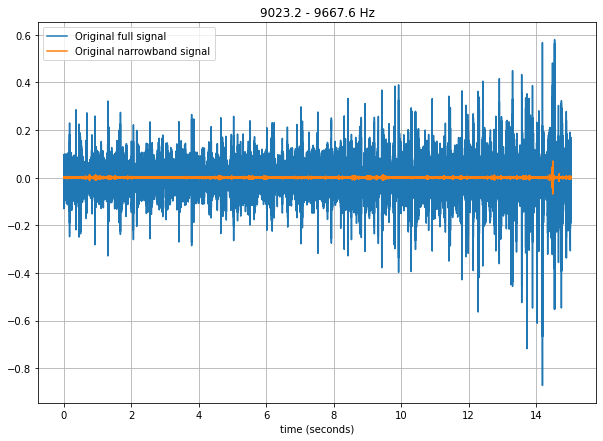

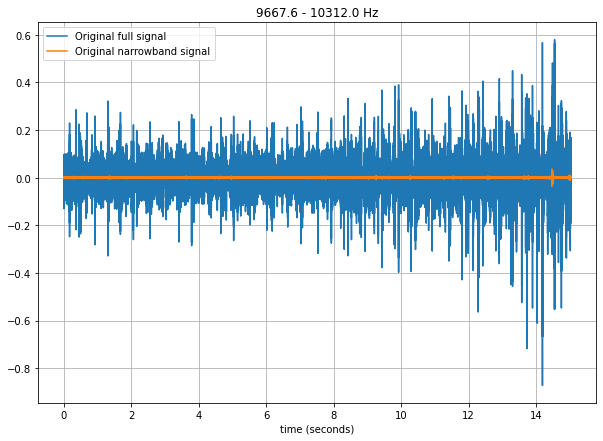

In [ ]:
signalBH1=signal_full_BH1
bp_signalBH1 = apply_bank_filters(signalBH1, sr, freqs, plots=show_plots, bandwidth = 10, ripple_db = 50, audio_player = False)

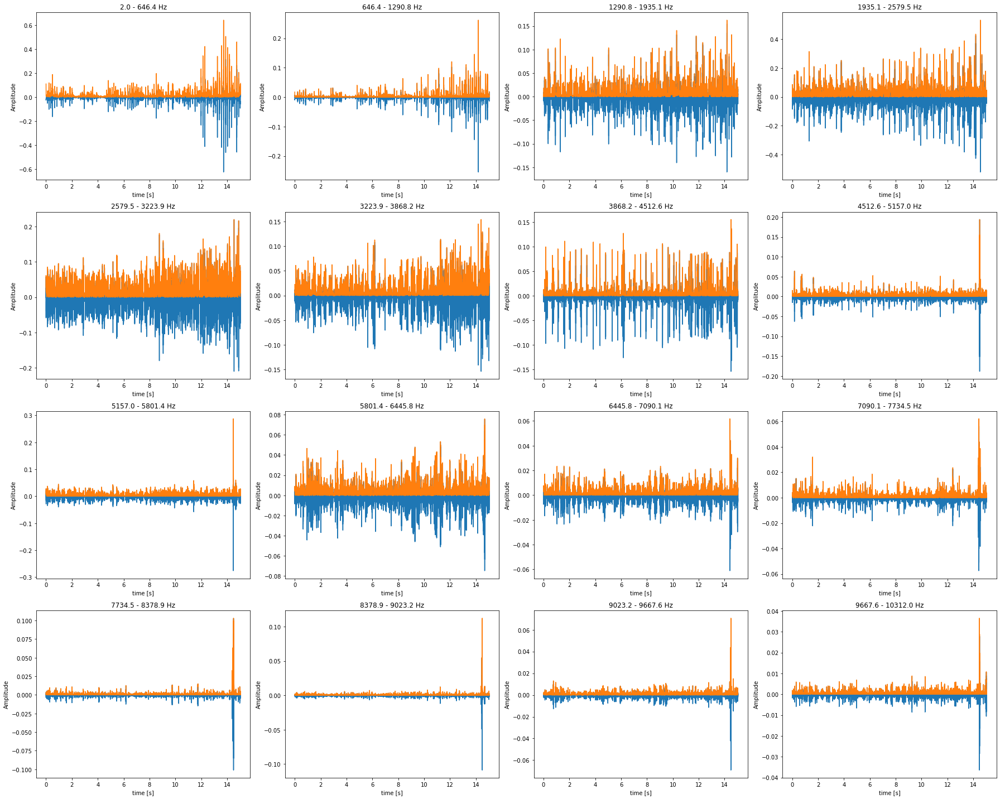

In [ ]:
amp_env_BH1 = get_AE(bp_signalBH1, sr, freqs, plots=show_plots)

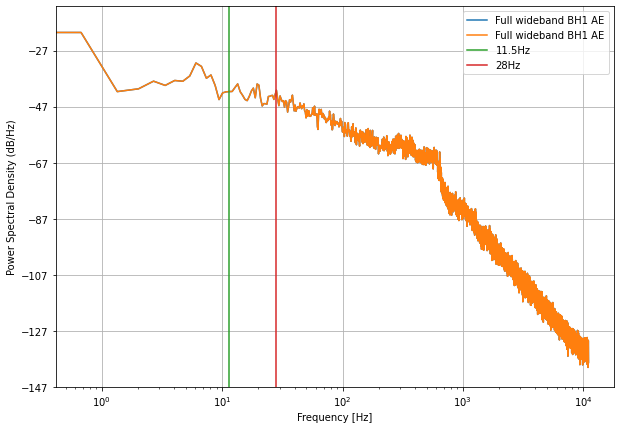

In [ ]:
PSD_comparison_plot(signal1 = amp_env_BH1, signal2 = amp_env_BH1, nfft = 16384*2, fs = sr, sum_ae = True, signal1_name = 'BH1 AE', signal2_name = 'BH1 AE')

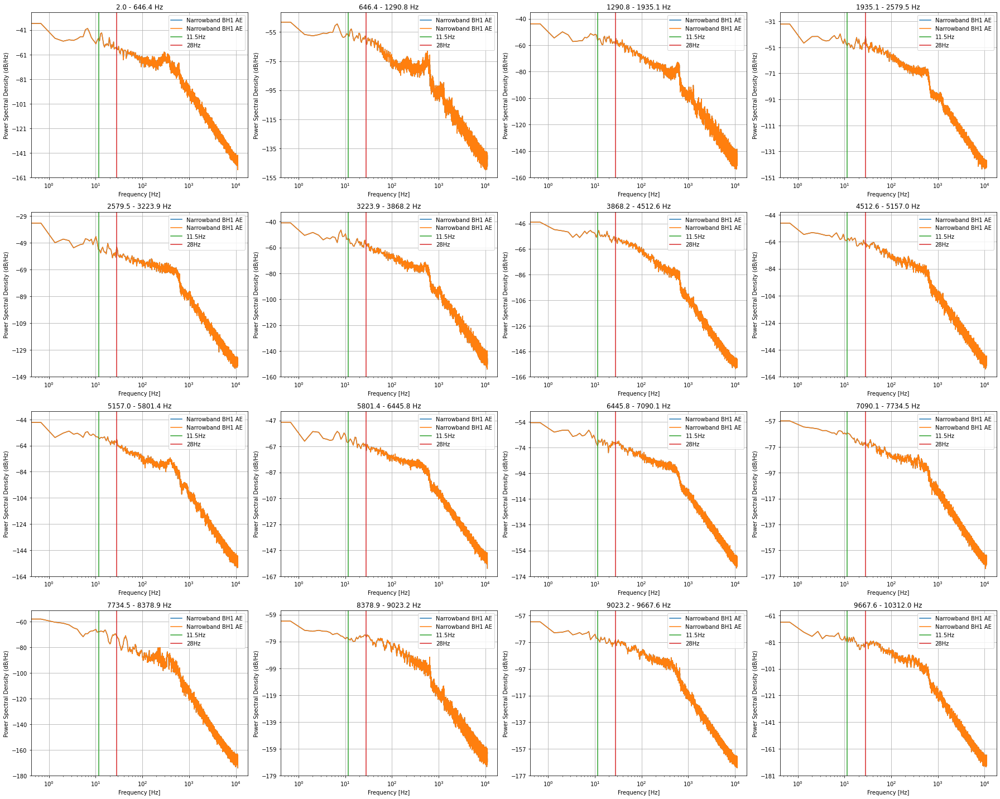

In [ ]:
PSD_comparison_plot(signal1 = amp_env_BH1, signal2 = amp_env_BH1, nfft = 16384*2, fs = sr, sum_ae = False, signal1_name = 'BH1 AE', signal2_name = 'BH1 AE')